# Clinical application of connectome kernel normative models

---

Using the connectome spectral normative models developed in notebooks in chapter 5, we now turn our attention to applying the pretrained spectral model to a clinical sample to extract interesting knowledge about how pathological brain changes are linked to behaviors.

Note: this notebook is executed on CSC servers...

## Notebook 7.1.3: MACC Model evaluations

### package imports and basic functions

---

In [2]:
import os
import gc
import sys
import glob
import json
import random
import datetime
import importlib
import itertools
import numpy as np
from scipy import spatial
import scipy.sparse as sparse
import scipy.stats as stats
import pandas as pd
import nibabel as nib
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import boto3
from tqdm.notebook import tqdm
from sklearn import metrics


In [3]:
# pymc libraries
import pymc as pm
import arviz as az
import xarray as xr
import patsy

print(f"Running on PyMC v{pm.__version__}")


Running on PyMC v4.2.2


In [4]:
class MyNumpyEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.integer):
            return int(obj)
        elif isinstance(obj, np.floating):
            return float(obj)
        elif isinstance(obj, np.ndarray):
            return obj.tolist()
        else:
            return super(MyEncoder, self).default(obj)


def ensure_dir(file_name):
    os.makedirs(os.path.dirname(file_name), exist_ok=True)
    return file_name


def list_dirs(path=os.getcwd()):
    files = glob.glob(os.path.join(path, '*'))
    files = [x for x in files if os.path.isdir(x)]
    return files


def file_exists(file_name, path_name=os.getcwd()):
    return os.path.isfile(os.path.join(path_name, file_name))


def write_json(json_obj, file_path):
    with open(file_path, 'w') as outfile:
        json.dump(json_obj, outfile, sort_keys=True, indent=4,
                  cls=MyNumpyEncoder)
    return json_obj


def load_json(file_path):
    with open(file_path, 'r') as infile:
        return json.load(infile)


def write_np(np_obj, file_path):
    with open(file_path, 'wb') as outfile:
        np.save(outfile, np_obj)


def load_np(file_path):
    with open(file_path, 'rb') as infile:
        return np.load(infile)


In [5]:
# path setting
main_dir = "/home/sina/storage"
gitrepo_dir = f"{main_dir}/Normative_Modeling/git-repo/normative_brain_charts"
# clone of https://github.com/Washington-University/HCPpipelines
hcp_pipeline_dir = f"{main_dir}/HCPpipelines"
# clone of https://github.com/edickie/ciftify
ciftify_dir = f"{main_dir}/ciftify"


### Brain visualization functions

---

In [6]:
plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Computer Modern']
plt.rcParams['text.latex.preamble'] = r'\usepackage{fontawesome}'


In [7]:
# basic parameters
surface = 'inflated_MSMAll'
expand = 0

# load an example dscalar
dscalar_file = f'{hcp_pipeline_dir}/global/templates/91282_Greyordinates/91282_Greyordinates.dscalar.nii'
dscalar = nib.load(dscalar_file)

brain_models = [x for x in dscalar.header.get_index_map(1).brain_models]

# load surfaces for visualization
# left_surface_file = f'{main_dir}/data/templates/hcp_surf/S1200.L.{surface}.32k_fs_LR.surf.gii'
left_surface_file = f'{ciftify_dir}/ciftify/data/HCP_S1200_GroupAvg_v1/S1200.L.{surface}.32k_fs_LR.surf.gii'
left_surface = nib.load(left_surface_file)
right_surface_file = f'{ciftify_dir}/ciftify/data/HCP_S1200_GroupAvg_v1/S1200.R.{surface}.32k_fs_LR.surf.gii'
right_surface = nib.load(right_surface_file)

# extract surface information
lx, ly, lz = left_surface.darrays[0].data.T
lt = left_surface.darrays[1].data
rx, ry, rz = right_surface.darrays[0].data.T
rt = right_surface.darrays[1].data

# combine into a complete brain
lrx = np.concatenate([lx - expand, rx + expand])
lry = np.concatenate([ly, ry])
lrz = np.concatenate([lz, rz])
lrt = np.concatenate([lt, (rt + lx.shape[0])])

lxyz = left_surface.darrays[0].data
rxyz = right_surface.darrays[0].data
lrxyz = np.array([lrx, lry, lrz]).T

# create a mapping between surface and cifti vertices
left_cortical_surface_model, right_cortical_surface_model = brain_models[0], brain_models[1]
cifti_to_surface = {}
surface_to_cifti = {}
for (i, x) in enumerate(left_cortical_surface_model.vertex_indices):
    cifti_to_surface[i] = x
    surface_to_cifti[x] = i
for (i, x) in enumerate(right_cortical_surface_model.vertex_indices):
    cifti_to_surface[i + right_cortical_surface_model.index_offset] = x + rx.shape[0]
    surface_to_cifti[x + rx.shape[0]] = i + right_cortical_surface_model.index_offset

# construct data over surface
surface_mask = list(surface_to_cifti.keys())


#### Faster brain visualization by Cerebro

---

In [8]:
# Cerebro brain viewer used for visualization
from cerebro import cerebro_brain_utils as cbu
from cerebro import cerebro_brain_viewer as cbv


In [9]:
# Brain visualizations with Cerebro

# ignore warning when loading cifti
nib.imageglobals.logger.setLevel(40)

from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.gridspec import GridSpec

def plot_single_view_with_cerebro(dscalar_data, ax, colormap=plt.cm.coolwarm, clims=None, vlims=None, exclusion_color=(1.,1.,1.,0), view="L", show_colorbar=False, colorbar_format=None, cifti_left_right_seperation=0, surface = 'midthickness', surface_files=None, cover=None, cover_colormap=plt.cm.gray, cover_alpha=0.5):
    try:
        
        my_brain_viewer = cbv.Cerebro_brain_viewer(offscreen=True, background_color=(1.,1.,1.,0), null_color=(1., 1., 1., 0.0), no_color=(0.7, 0.7, 0.7, 1.))

        if surface_files is None:
            surface_model = my_brain_viewer.load_template_GIFTI_cortical_surface_models(surface)
        else:
            surface_model = my_brain_viewer.load_GIFTI_cortical_surface_models(*surface_files) # surface files should contain paths to two alternative surface files

        cifti_space = my_brain_viewer.visualize_cifti_space(
            volumetric_structures='none', cifti_left_right_seperation=cifti_left_right_seperation,
        )

        dscalar_layer = my_brain_viewer.add_cifti_dscalar_layer(
            dscalar_data=dscalar_data,
            colormap=colormap,
            clims=clims,
            vlims=vlims,
            exclusion_color=exclusion_color,
            opacity=0.95)

        if cover is not None:
            cover_layer = my_brain_viewer.add_cifti_dscalar_layer(
            dscalar_data=cover,
            colormap=cover_colormap,
            clims=[0, 1],
            vlims=[0.5, 1],
            exclusion_color=exclusion_color,
            opacity=cover_alpha)

        ax.axis('off')
        camconf = my_brain_viewer._view_to_camera_config(view)
        # camconf = my_brain_viewer.zoom_camera_to_content(camconf)
        my_brain_viewer.viewer.change_view(**camconf)
        my_brain_viewer.offscreen_draw_to_matplotlib_axes(ax)

    finally:
        my_brain_viewer.viewer.window.destroy()

def plot_left_right_surface_with_cerebro(dscalar_data, ax, colormap=plt.cm.coolwarm, clims=None, show_colorbar=False, colorbar_format=None, **kwargs):
    # Hide the parent axis
    ax.set_visible(False)

    # Create a 2x2 GridSpec within the axis using inset_axes
    gs = ax.inset_axes([0, 0, 1, 1], transform=ax.transAxes)
    sub_gs = GridSpec(2, 2, gs, hspace=0., wspace=0.)

    # Create a 4x4 grid
    ax_tl = fig.add_subplot(sub_gs[0, 0])
    ax_tr = fig.add_subplot(sub_gs[0, 1])
    ax_bl = fig.add_subplot(sub_gs[1, 0])
    ax_br = fig.add_subplot(sub_gs[1, 1])
    
    # separate data to left and right
    dscalar_data_left = dscalar_data.copy()
    dscalar_data_left[left_cortical_surface_model.index_count:] = np.nan
    dscalar_data_right = dscalar_data.copy()
    dscalar_data_right[:left_cortical_surface_model.index_count] = np.nan
    
    # Lateral left view
    plot_single_view_with_cerebro(dscalar_data_left, ax_tl, colormap=colormap, clims=clims,
                                  view=((-420, 0, 0), None, None, None), **kwargs)
    # Medial left view
    plot_single_view_with_cerebro(dscalar_data_left, ax_bl, colormap=colormap, clims=clims,
                                  view=((420, 0, 0), None, None, None), cifti_left_right_seperation=-80, **kwargs)
    
    # Lateral right view
    plot_single_view_with_cerebro(dscalar_data_right, ax_tr, colormap=colormap, clims=clims,
                                  view=((420, 0, 0), None, None, None), **kwargs)
    # Medial right view
    plot_single_view_with_cerebro(dscalar_data_right, ax_br, colormap=colormap, clims=clims,
                                  view=((-420, 0, 0), None, None, None), cifti_left_right_seperation=-80, **kwargs)

    if show_colorbar:
        cax = inset_axes(
            ax,
            width="30%",
            height="4%",
            loc="center",
            bbox_to_anchor=(-0., 0.0, 1., 1.),
            bbox_transform=ax.transAxes,
            borderpad=0,
        )
        cb = fig.colorbar(
            mpl.cm.ScalarMappable(
                norm=mpl.colors.Normalize(vmin=clims[0], vmax=clims[1]),
                cmap=colormap
            ),
            cax=cax,
            aspect=10,
            orientation='horizontal',
            format=colorbar_format,
        )
        cb.outline.set_visible(False)
        cb.ax.tick_params(labelsize=12)
        cb.ax.tick_params(length=0)


## Load the connectome kernel

---

In [10]:
# load the connectivity eigenmodes
N_kernels = 1000
connectome_kernel_eigenvalues = load_np(f'{main_dir}/Normative_Modeling/data/npy/rw_cortical_connectome_eigenvalues_cifti.npy')[:N_kernels];
connectome_kernel_eigenvectors = load_np(f'{main_dir}/Normative_Modeling/data/npy/rw_cortical_connectome_eigenvectors_cifti.npy')[:,:N_kernels];


## Create a fixed BSpline function to ensure consistent nonlinear expansions of age across all models

---



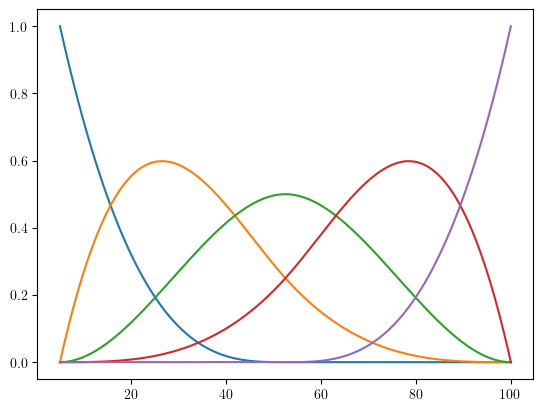

In [12]:
# fixed B-spline
age_min=5
age_max=100
num_knots = 3
patsy_knots = np.linspace(age_min, age_max, num_knots)[1:-1]
fixed_B_spline_age = patsy.dmatrix(
    "bs(xi, knots=knots, degree=3, include_intercept=True) - 1",
    {"xi": (np.linspace(age_min, age_max, 200)), "knots": patsy_knots},
)
plt.plot(np.linspace(age_min, age_max, 200), fixed_B_spline_age)



## Load selected covariance pairs

---

The largest pairs of kernels in terms of correlation are stored to model a sparse covariance structure.


In [13]:
corr_max_all = load_np(f'{main_dir}/Normative_Modeling/data/models/pymc/connectome_rw_kernel_rho_corr_max_all.npy')
selected_pairs = load_np(f'{main_dir}/Normative_Modeling/data/models/pymc/connectome_rw_kernel_rho_selected_pairs_rho.npy')


In [14]:
rows, cols = np.where(corr_max_all>0.25)
rows_lim = rows[rows < cols]
cols_lim = cols[rows < cols]


In [13]:
len(selected_pairs)

4261

In [14]:
len(rows_lim)

4261

In [15]:
%%time
sparse_filler = sparse.coo_matrix(
    (np.ones(selected_pairs.shape[0]), (selected_pairs[:, 0], selected_pairs[:, 1])),
    shape=(selected_pairs.max() + 1, selected_pairs.max() + 1)
)


CPU times: user 0 ns, sys: 2.48 ms, total: 2.48 ms
Wall time: 1.76 ms


In [16]:
# mask pairs including higher order eigenmodes
selected_pair_mask = (selected_pairs<N_kernels).all(1)
selected_pairs_N_kernels_masked = selected_pairs[selected_pair_mask]


In [17]:
%%time
sparse_filler_N_kernels_masked = sparse.coo_matrix(
    (np.ones(selected_pairs_N_kernels_masked.shape[0]), (selected_pairs_N_kernels_masked[:, 0], selected_pairs_N_kernels_masked[:, 1])),
    shape=(N_kernels, N_kernels)
)


CPU times: user 0 ns, sys: 1.31 ms, total: 1.31 ms
Wall time: 1.1 ms


## Load fitted kernel normative models

---


In [18]:
%%time
kernel_posterior_means = xr.open_dataset(f'{main_dir}/Normative_Modeling/data/models/pymc/combined_connectome_rw_kernel_posterior_means_pymc_advi.nc',)
kernel_posterior_means


CPU times: user 0 ns, sys: 272 ms, total: 272 ms
Wall time: 3.74 s


<xarray.Dataset> Size: 2MB
Dimensions:                (kernel: 10000, sex: 2, site: 3, splines: 5)
Coordinates:
  * sex                    (sex) float64 16B 1.0 0.0
  * site                   (site) <U13 156B 'HCP-YA-site_0' ... 'HCP-A-site_0'
  * splines                (splines) int64 40B 0 1 2 3 4
Dimensions without coordinates: kernel
Data variables:
    mu_intercept_site      (kernel) float64 80kB ...
    intercept_sex          (kernel, sex) float64 160kB ...
    intercept_site_offset  (kernel, site) float64 240kB ...
    w_age                  (kernel, splines) float64 400kB ...
    sigma_intercept_site   (kernel) float64 80kB ...
    sigma_error_site       (kernel) float64 80kB ...
    w_error_age            (kernel, splines) float64 400kB ...
    error_sex              (kernel, sex) float64 160kB ...
    error_site_offset      (kernel, site) float64 240kB ...
    intercept_site         (kernel, site) float64 240kB ...
    error_site             (kernel, site) float64 240kB ...

In [19]:
%%time
rho_kernel_posterior_means = xr.open_dataset(f'{main_dir}/Normative_Modeling/data/models/pymc/combined_connectome_rw_rho_kernel_posterior_means_pymc_advi.nc')
rho_kernel_posterior_means


CPU times: user 0 ns, sys: 59 ms, total: 59 ms
Wall time: 134 ms


<xarray.Dataset> Size: 512kB
Dimensions:                    (kernel_pair: 4261, sex: 2, site: 3, splines: 5)
Coordinates:
  * sex                        (sex) float64 16B 1.0 0.0
  * site                       (site) <U13 156B 'HCP-YA-site_0' ... 'HCP-A-si...
  * splines                    (splines) int64 40B 0 1 2 3 4
Dimensions without coordinates: kernel_pair
Data variables:
    mu_intercept_site_rho      (kernel_pair) float64 34kB ...
    intercept_sex_rho          (kernel_pair, sex) float64 68kB ...
    intercept_site_offset_rho  (kernel_pair, site) float64 102kB ...
    w_age_rho                  (kernel_pair, splines) float64 170kB ...
    sigma_intercept_site_rho   (kernel_pair) float64 34kB ...
    intercept_site_rho         (kernel_pair, site) float64 102kB ...

### Also Load observed training moments (mean and sigma used for standardization)

---


In [31]:
%%time
kernel_means = np.load(f'{main_dir}/Normative_Modeling/data/models/pymc/connectome_rw_kernel_kernel_means.npy')[:N_kernels].tolist()
kernel_stds = np.load(f'{main_dir}/Normative_Modeling/data/models/pymc/connectome_rw_kernel_kernel_stds.npy')[:N_kernels].tolist()


CPU times: user 0 ns, sys: 5.23 ms, total: 5.23 ms
Wall time: 101 ms


In [19]:
len(kernel_means), len(kernel_stds)

(1000, 1000)

## Load all MACC data

---

In [20]:
all_thickness_data_MACC = load_np(f'{main_dir}/Normative_Modeling/data/MACC/summary/cleaned_all_thickness_data_MACC.npy');
all_thickness_data_MACC.shape


(674, 59412)

In [21]:
all_thickness_data_MACC_encoded = load_np(f'{main_dir}/Normative_Modeling/data/MACC/summary/cleaned_all_thickness_data_MACC_encoded.npy');
all_thickness_data_MACC_encoded.shape


(674, 11001)

In [22]:
demography_extended_df_MACC = pd.read_csv(f'{main_dir}/Normative_Modeling/data/MACC/summary/demography_extended_df_MACC.csv')
demography_extended_df_MACC

,subject_ID,sex,age,diagnosis,mmse,thickness_connectome_pc_0,thickness_connectome_pc_1,thickness_connectome_pc_2,thickness_connectome_pc_3,thickness_connectome_pc_4,...,thickness_connectome_pc_992,thickness_connectome_pc_993,thickness_connectome_pc_994,thickness_connectome_pc_995,thickness_connectome_pc_996,thickness_connectome_pc_997,thickness_connectome_pc_998,thickness_connectome_pc_999,age_bins,split
0,HD001,0,58.000000,NCI,26.0,595.404921,-2.988673,28.387228,-47.514605,14.128553,...,2.305832,2.339347,-1.838847,-1.355246,0.406034,1.422772,1.133603,-3.565102,0,Train
1,HD002,1,63.000000,NCI,30.0,578.305361,4.541116,17.579084,-56.689357,15.704129,...,0.006548,-0.752449,1.522519,-0.164277,2.750056,0.936918,-1.015317,0.239366,1,Test
2,HD003,1,87.000000,AD,17.0,583.584819,-3.577608,21.320147,-29.771606,3.478685,...,-0.513072,-0.878510,1.467293,-0.041904,4.759097,-0.118015,-1.831489,1.210456,9,Test
3,HD004,0,72.000000,VCIND,27.0,569.606960,17.875988,33.168828,-21.237119,19.472234,...,2.489475,-0.491276,-4.140618,0.997443,2.554370,-0.693051,-1.779164,-3.283816,3,Test
4,HD005,0,64.000000,VAD,14.0,553.304157,-0.889549,18.389647,-31.733231,4.780241,...,0.988722,0.332366,-0.161542,0.535014,0.762446,-2.808122,2.394301,0.114801,1,Test
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
669,HD708,1,68.000000,CIND,25.0,566.541171,-3.745172,17.742118,-41.644337,13.038910,...,3.311674,1.734526,0.424161,-2.697676,4.151448,1.480859,0.667881,-1.947132,2,Test
670,HD709,0,73.394521,NCI,28.0,574.221681,-7.783637,22.753400,-36.585811,12.150714,...,0.372612,0.954771,2.422085,0.484439,-0.070413,0.852638,0.977014,-2.924204,4,Test
671,HD710,1,73.421918,CIND,29.0,551.158037,2.254310,9.483589,-32.421152,4.467115,...,-0.658736,1.567999,0.683723,-0.107798,1.236113,-1.432196,0.763503,-3.626161,4,Test
672,HD711,1,61.331507,NCI,30.0,597.881738,1.841696,15.793990,-49.422621,10.084503,...,-1.408109,-0.204344,-0.604761,-0.094463,2.077290,-0.483792,0.731981,-4.178934,0,Train


## Check MACC data

---

In [23]:
# Let's limit the evaluations to NCI, CIND, and AD (not to complicate findings by between diagnosis differences)
study_mask = demography_extended_df_MACC['diagnosis'].isin(['NCI', 'CIND', 'AD'])
study_mask.sum()


542

In [243]:
(demography_extended_df_MACC['split']=="Train")[study_mask].sum()

66

In [17]:
demography_extended_df_MACC['diagnosis'].value_counts()

diagnosis
AD       208
CIND     202
NCI      132
VCIND     75
VAD       57
Name: count, dtype: int64

In [18]:
demography_extended_df_MACC['diagnosis'][demography_extended_df_MACC['diagnosis'].isin(['AD', 'CIND', 'NCI'])].value_counts()

diagnosis
AD      208
CIND    202
NCI     132
Name: count, dtype: int64

In [19]:
demography_extended_df_MACC['diagnosis'][demography_extended_df_MACC['diagnosis'].isin(['AD', 'CIND', 'NCI'])].value_counts()/542

diagnosis
AD      0.383764
CIND    0.372694
NCI     0.243542
Name: count, dtype: float64

In [20]:
demography_extended_df_MACC['diagnosis'][demography_extended_df_MACC['split']=="Train"].value_counts()

diagnosis
NCI    66
Name: count, dtype: int64

In [246]:
demography_extended_df_MACC['sex'].value_counts()

sex
1    385
0    289
Name: count, dtype: int64

In [23]:
demography_extended_df_MACC['sex'][demography_extended_df_MACC['diagnosis'].isin(['AD', 'CIND', 'NCI'])].value_counts()

sex
1    333
0    209
Name: count, dtype: int64

In [24]:
333/542

0.6143911439114391

In [25]:
demography_extended_df_MACC['sex'][demography_extended_df_MACC['split']=="Train"].value_counts()

sex
1    38
0    28
Name: count, dtype: int64

In [293]:
np.percentile(demography_extended_df_MACC['age'][study_mask],[0,100])

array([50., 91.])

<Axes: xlabel='age', ylabel='Count'>

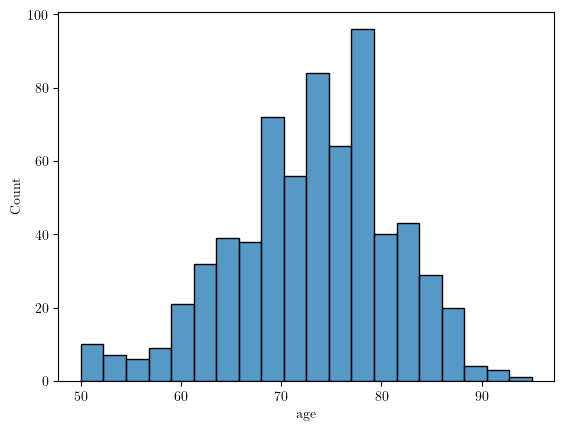

In [2216]:
sns.histplot(demography_extended_df_MACC['age'])

In [22]:
demography_extended_df_MACC["group"] = "HC"
demography_extended_df_MACC.loc[demography_extended_df_MACC['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
demography_extended_df_MACC.loc[demography_extended_df_MACC['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "MCI"


In [15]:
demography_extended_df_MACC

,subject_ID,sex,age,diagnosis,mmse,thickness_connectome_pc_0,thickness_connectome_pc_1,thickness_connectome_pc_2,thickness_connectome_pc_3,thickness_connectome_pc_4,...,thickness_connectome_pc_992,thickness_connectome_pc_993,thickness_connectome_pc_994,thickness_connectome_pc_995,thickness_connectome_pc_996,thickness_connectome_pc_997,thickness_connectome_pc_998,thickness_connectome_pc_999,age_bins,split
0,HD001,0,58.000000,NCI,26.0,595.404921,-2.988673,28.387228,-47.514605,14.128553,...,2.305832,2.339347,-1.838847,-1.355246,0.406034,1.422772,1.133603,-3.565102,0,Train
1,HD002,1,63.000000,NCI,30.0,578.305361,4.541116,17.579084,-56.689357,15.704129,...,0.006548,-0.752449,1.522519,-0.164277,2.750056,0.936918,-1.015317,0.239366,1,Test
2,HD003,1,87.000000,AD,17.0,583.584819,-3.577608,21.320147,-29.771606,3.478685,...,-0.513072,-0.878510,1.467293,-0.041904,4.759097,-0.118015,-1.831489,1.210456,9,Test
3,HD004,0,72.000000,VCIND,27.0,569.606960,17.875988,33.168828,-21.237119,19.472234,...,2.489475,-0.491276,-4.140618,0.997443,2.554370,-0.693051,-1.779164,-3.283816,3,Test
4,HD005,0,64.000000,VAD,14.0,553.304157,-0.889549,18.389647,-31.733231,4.780241,...,0.988722,0.332366,-0.161542,0.535014,0.762446,-2.808122,2.394301,0.114801,1,Test
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
669,HD708,1,68.000000,CIND,25.0,566.541171,-3.745172,17.742118,-41.644337,13.038910,...,3.311674,1.734526,0.424161,-2.697676,4.151448,1.480859,0.667881,-1.947132,2,Test
670,HD709,0,73.394521,NCI,28.0,574.221681,-7.783637,22.753400,-36.585811,12.150714,...,0.372612,0.954771,2.422085,0.484439,-0.070413,0.852638,0.977014,-2.924204,4,Test
671,HD710,1,73.421918,CIND,29.0,551.158037,2.254310,9.483589,-32.421152,4.467115,...,-0.658736,1.567999,0.683723,-0.107798,1.236113,-1.432196,0.763503,-3.626161,4,Test
672,HD711,1,61.331507,NCI,30.0,597.881738,1.841696,15.793990,-49.422621,10.084503,...,-1.408109,-0.204344,-0.604761,-0.094463,2.077290,-0.483792,0.731981,-4.178934,0,Train


In [247]:
# Function to calculate summary statistics for each group
def summary_stats(group_df):
    stats = pd.DataFrame.from_dict(
        {
            'Sample Size': {'Result': f"{group_df.shape[0]}"},
            'Age': {'Result': f"{group_df['age'].mean():.2f} ± {group_df['age'].std():.2f}"},
            'Sex': {'Result': f"{100*(group_df['sex'].sum()/group_df.shape[0]):.1f}% female"},
            'MMSE': {'Result': f"{group_df['mmse'].mean():.2f} ± {group_df['mmse'].std():.2f}"},
        }
    )
    # Calculate the mean and std for age, sex, and MMSE
    # stats = group_df[['age', 'mmse']].agg(['mean', 'std']).T
    # stats.columns = ['mean', 'std']  # Flatten the column multi-index
    # stats = stats.rename(columns={'mean': 'mean', 'std': 'std'})  # Rename columns
    return stats

column_names = {"AD":"AD diagnosis", "HC":"HC (No cognitive impairment)", "MCI":"MCI (Cognitive impairment, no dementia)"}

# Group by 'group' and apply the function
# summary_df = demography_extended_df_MACC.groupby('group').apply(summary_stats).reset_index().set_index('group').drop(columns=['level_1']).T[["HC", "MCI", "AD"]].rename(columns=column_names)
summary_df = demography_extended_df_MACC[study_mask].groupby('group').apply(summary_stats).reset_index().set_index('group').drop(columns=['level_1']).T[["HC", "MCI", "AD"]].rename(columns=column_names)
summary_df


/tmp/ipykernel_30658/2391308783.py:21: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  summary_df = demography_extended_df_MACC[study_mask].groupby('group').apply(summary_stats).reset_index().set_index('group').drop(columns=['level_1']).T[["HC", "MCI", "AD"]].rename(columns=column_names)


group,HC (No cognitive impairment),"MCI (Cognitive impairment, no dementia)",AD diagnosis
Sample Size,132,202,208
Age,68.49 ± 7.58,74.29 ± 6.70,75.49 ± 7.19
Sex,54.5% female,58.4% female,68.8% female
MMSE,27.39 ± 1.90,24.04 ± 3.88,15.60 ± 4.96


In [248]:
print(summary_df.to_latex())

\begin{tabular}{llll}
\toprule
group & HC (No cognitive impairment) & MCI (Cognitive impairment, no dementia) & AD diagnosis \\
\midrule
Sample Size & 132 & 202 & 208 \\
Age & 68.49 ± 7.58 & 74.29 ± 6.70 & 75.49 ± 7.19 \\
Sex & 54.5% female & 58.4% female & 68.8% female \\
MMSE & 27.39 ± 1.90 & 24.04 ± 3.88 & 15.60 ± 4.96 \\
\bottomrule
\end{tabular}



## Load fine-tuned MACC model parameters

---

In [24]:
%%time
kernel_posterior_means_MACC = xr.open_dataset(f'{main_dir}/Normative_Modeling/data/models/pymc/MACC_tuned_combined_connectome_rw_kernel_posterior_means_pymc_advi.nc',)
kernel_posterior_means_MACC


CPU times: user 0 ns, sys: 68 ms, total: 68 ms
Wall time: 2.1 s


<xarray.Dataset> Size: 32kB
Dimensions:                (kernel: 1000, site: 1)
Coordinates:
  * site                   (site) int32 4B 0
Dimensions without coordinates: kernel
Data variables:
    error_site             (kernel, site) float64 8kB ...
    error_site_offset      (kernel, site) float64 8kB ...
    intercept_site         (kernel, site) float64 8kB ...
    intercept_site_offset  (kernel, site) float64 8kB ...

In [25]:
%%time
rho_kernel_posterior_means_MACC = xr.open_dataset(f'{main_dir}/Normative_Modeling/data/models/pymc/MACC_tuned_combined_connectome_rw_rho_kernel_posterior_means_pymc_advi.nc')
rho_kernel_posterior_means_MACC


CPU times: user 0 ns, sys: 7.21 ms, total: 7.21 ms
Wall time: 115 ms


<xarray.Dataset> Size: 32kB
Dimensions:                    (kernel_pair: 1976, site: 1)
Coordinates:
  * site                       (site) int32 4B 0
Dimensions without coordinates: kernel_pair
Data variables:
    intercept_site_offset_rho  (kernel_pair, site) float64 16kB ...
    intercept_site_rho         (kernel_pair, site) float64 16kB ...

## Split train and test sets

---

In [26]:
# separate the training sample
train_set =  (demography_extended_df_MACC['split'] == "Train")
train_df = demography_extended_df_MACC[train_set]
test_df = demography_extended_df_MACC[~train_set]
test_df


,subject_ID,sex,age,diagnosis,mmse,thickness_connectome_pc_0,thickness_connectome_pc_1,thickness_connectome_pc_2,thickness_connectome_pc_3,thickness_connectome_pc_4,...,thickness_connectome_pc_992,thickness_connectome_pc_993,thickness_connectome_pc_994,thickness_connectome_pc_995,thickness_connectome_pc_996,thickness_connectome_pc_997,thickness_connectome_pc_998,thickness_connectome_pc_999,age_bins,split
1,HD002,1,63.000000,NCI,30.0,578.305361,4.541116,17.579084,-56.689357,15.704129,...,0.006548,-0.752449,1.522519,-0.164277,2.750056,0.936918,-1.015317,0.239366,1,Test
2,HD003,1,87.000000,AD,17.0,583.584819,-3.577608,21.320147,-29.771606,3.478685,...,-0.513072,-0.878510,1.467293,-0.041904,4.759097,-0.118015,-1.831489,1.210456,9,Test
3,HD004,0,72.000000,VCIND,27.0,569.606960,17.875988,33.168828,-21.237119,19.472234,...,2.489475,-0.491276,-4.140618,0.997443,2.554370,-0.693051,-1.779164,-3.283816,3,Test
4,HD005,0,64.000000,VAD,14.0,553.304157,-0.889549,18.389647,-31.733231,4.780241,...,0.988722,0.332366,-0.161542,0.535014,0.762446,-2.808122,2.394301,0.114801,1,Test
5,HD006,1,73.000000,VCIND,18.0,596.905569,-0.732889,19.209490,-35.694558,8.081672,...,-0.151000,-0.681722,-1.785977,0.362367,1.642231,3.452060,-1.658681,-4.911806,4,Test
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
667,HD706,1,71.000000,CIND,20.0,593.302794,-10.265845,27.163479,-48.111449,17.755505,...,1.565506,2.159340,-1.118811,-1.330670,0.380030,-0.522007,-1.738696,-0.976536,3,Test
669,HD708,1,68.000000,CIND,25.0,566.541171,-3.745172,17.742118,-41.644337,13.038910,...,3.311674,1.734526,0.424161,-2.697676,4.151448,1.480859,0.667881,-1.947132,2,Test
670,HD709,0,73.394521,NCI,28.0,574.221681,-7.783637,22.753400,-36.585811,12.150714,...,0.372612,0.954771,2.422085,0.484439,-0.070413,0.852638,0.977014,-2.924204,4,Test
671,HD710,1,73.421918,CIND,29.0,551.158037,2.254310,9.483589,-32.421152,4.467115,...,-0.658736,1.567999,0.683723,-0.107798,1.236113,-1.432196,0.763503,-3.626161,4,Test


In [74]:
# random seed for reproducibility
rng = np.random.default_rng(12345)

def fine_tune_pymc_advi_on_kernel_for_MACC(kernel_idx, train_df=train_df, fixed_B_spline_age=fixed_B_spline_age):
    kernel_name = f'thickness_connectome_pc_{kernel_idx}'
    # sample from required columns
    sample_df = train_df[['age', 'sex', kernel_name]].copy()

    # Data preperation
    age = sample_df['age'].values
    thickness = sample_df[kernel_name].values
    thickness_standardized = (thickness - kernel_means[kernel_idx]) / kernel_stds[kernel_idx]

    # dummy site variable of only one dimension
    site_idxs, sites = pd.factorize(train_df['sex']*0)

    # sex variable
    sex_idxs, sexes = pd.factorize(sample_df['sex'])
    # adjust for the original model flipping
    sex_idxs, sexes = (1 - sex_idxs), (1 - sexes)
    
    # Splines to model nonlinear age effects on thickness
    # Using the fixed B-Spline, no need to standardize age range
    B_spline_age = patsy.build_design_matrices(
        [fixed_B_spline_age.design_info],
        {"xi": age, "knots": patsy_knots}
    )[0]
    
    
    coords = {
        "site": sites,
        "sex": sexes,
        "splines": np.arange(B_spline_age.shape[1]),
        "obs_id": np.arange(len(sex_idxs)),
    }

    kernel_advi_model = pm.Model(coords=coords, aesara_config={'compute_test_value': 'off'})
    # models_dict[kernel_name] = advi_model

    # a nonlinear spline model (see https://www.pymc.io/projects/examples/en/latest/case_studies/spline.html)
    with kernel_advi_model:
        # minibatch variables
        # age_t = pm.Minibatch(age, 512,)
        sex_idx_t = pm.Minibatch(sex_idxs, 128)
        site_idx_t = pm.Minibatch(site_idxs, 128)
        B_spline_age_t = pm.Minibatch(B_spline_age, 128)
        thickness_standardized_t = pm.Minibatch(thickness_standardized, 128)

        # Pretrained hyperpriors for site effects
        # mu_intercept_site = pm.Normal('mu_intercept_site', mu=0, sigma=10)
        # sigma_intercept_site = pm.HalfNormal("sigma_intercept_site", sigma=10)
        # sigma_error_site = pm.HalfNormal("sigma_error_site", sigma=10)
        mu_intercept_site = pm.ConstantData("mu_intercept_site", np.array(kernel_posterior_means['mu_intercept_site'][kernel_idx]))
        sigma_intercept_site = pm.ConstantData("sigma_intercept_site", np.array(kernel_posterior_means['sigma_intercept_site'][kernel_idx]))
        sigma_error_site = pm.ConstantData("sigma_error_site", np.array(kernel_posterior_means['sigma_error_site'][kernel_idx]))

        # Priors    
        # pretrained sex effects
        # intercept_sex = pm.Normal("intercept_sex", mu=0, sigma=10, dims="sex")
        intercept_sex = pm.ConstantData("intercept_sex", np.array(kernel_posterior_means['intercept_sex'][kernel_idx]), dims="sex")

        # site effects (similar to random site effects (intercept only))
        #a_site = pm.Normal("a_site", mu=mu_a_site, sigma=sigma_a_site, dims="site")
        intercept_site_offset = pm.Normal("intercept_site_offset", mu=0, sigma=1, dims="site")
        intercept_site = pm.Deterministic("intercept_site", mu_intercept_site + intercept_site_offset * sigma_intercept_site, dims="site")

        # pretrained age effect
        # w_age = pm.Normal("w_age", mu=0, sigma=10, size=B_spline_age.shape[1], dims="splines")
        w_age = pm.ConstantData("w_age", np.array(kernel_posterior_means['w_age'][kernel_idx]), dims="splines")

        # Estimated thickness
        # thickness_est = pm.Deterministic("thickness_est", intercept_sex[sex_idx_t] + intercept_site[site_idx_t] + pm.math.dot(B_spline_age_t, w_age.T))
        thickness_est = intercept_sex[sex_idx_t] + intercept_site[site_idx_t] + pm.math.dot(B_spline_age_t, w_age.T)

        # Model error
        # pretrained nonlinear age error
        # w_error_age = pm.HalfCauchy("w_error_age", beta=5, size=B_spline_age.shape[1], dims="splines")
        w_error_age = pm.ConstantData("w_error_age", np.array(kernel_posterior_means['w_error_age'][kernel_idx]), dims="splines")

        # constant sex error
        # error_sex = pm.HalfCauchy("error_sex", beta=5, dims="sex")
        error_sex = pm.ConstantData("error_sex", np.array(kernel_posterior_means['error_sex'][kernel_idx]), dims="sex")
        

        # random site error
        error_site_offset = pm.HalfCauchy("error_site_offset", beta=5, dims="site")
        error_site = pm.Deterministic("error_site", error_site_offset * sigma_error_site, dims="site")

        # Error estimate
        # thickness_error = pm.Deterministic("thickness_error", error_sex[sex_idx_t] + error_site[site_idx_t] + pm.math.dot(B_spline_age_t, w_error_age.T))
        thickness_error = error_sex[sex_idx_t] + error_site[site_idx_t] + pm.math.dot(B_spline_age_t, w_error_age.T)

        # Skewness estimate
        # thickness_skewness = pm.Normal("thickness_skewness", mu=0, sigma=10, total_size=len(sample_df))
        # for sake of simplicity let's not model skewness

        # Likelihood (sampling distribution) of observations
        # need to figure out how to bound the distribution
        # pm.Bound("thickness_like", pm.Normal, lower=(-thickness.mean() / thickness.std()))(
        # thickness_like = pm.SkewNormal(
        thickness_like = pm.Normal(
            "thickness_like",
            mu=thickness_est,
            sigma=thickness_error,
            observed=thickness_standardized_t,
            total_size=len(sample_df),
        )
            # alpha=thickness_skewness,
    
        # run ADVI with minibatch
        kernel_approx = pm.fit(100000, callbacks=[pm.callbacks.CheckParametersConvergence(tolerance=1e-4)], random_seed=12345)

        # sample from trace
        kernel_advi_model_idata = pm.sample_prior_predictive(random_seed=rng)
        kernel_advi_model_idata.extend(kernel_approx.sample(2000, random_seed=rng))
        pm.sample_posterior_predictive(kernel_advi_model_idata, extend_inferencedata=True, random_seed=rng)
        # idata_dict[kernel_name] = advi_model_idata

        # No need to store constants here as constants were taken from the pretrained model
        # # store constants for observed mean and std used for standardization (added as a new group to inference data)
        # kernel_advi_model_idata.add_groups({
        #     "training": {
        #         'thickness_mean': thickness.mean(),
        #         'thickness_std': thickness.std(),
        #         'sample_size': thickness.shape[0],
        #     },
        # })
    
    stored_model_file = f'{main_dir}/Normative_Modeling/data/models/pymc/MACC_tuned_connectome_rw_kernel/{kernel_name}_pymc_advi_MACC.nc'
    kernel_advi_model_idata.to_netcdf(ensure_dir(stored_model_file))
    return (kernel_name, stored_model_file)
    

In [76]:
%%time
kernel_name, kernel_idx = 'thickness_connectome_pc_0', 0
fine_tune_pymc_advi_on_kernel_for_MACC(kernel_idx)


Finished [100%]: Average Loss = 37.835
Sampling: [error_site_offset, intercept_site_offset, thickness_like]
/home/sina/storage/miniconda/envs/normative_env/lib/python3.10/site-packages/pymc/backends/arviz.py:56: UserWarning: Could not extract data from symbolic observation thickness_like
  warnings.warn(f"Could not extract data from symbolic observation {obs}")
/home/sina/storage/miniconda/envs/normative_env/lib/python3.10/site-packages/pymc/backends/arviz.py:56: UserWarning: Could not extract data from symbolic observation thickness_like
  warnings.warn(f"Could not extract data from symbolic observation {obs}")
Sampling: [thickness_like]


/home/sina/storage/miniconda/envs/normative_env/lib/python3.10/site-packages/pymc/backends/arviz.py:56: UserWarning: Could not extract data from symbolic observation thickness_like
  warnings.warn(f"Could not extract data from symbolic observation {obs}")


CPU times: user 1min 10s, sys: 0 ns, total: 1min 10s
Wall time: 1min 11s


('thickness_connectome_pc_0',
 '/home/sina/storage/Normative_Modeling/data/models/pymc/MACC_tuned_connectome_rw_kernel/thickness_connectome_pc_0_pymc_advi_MACC.nc')

In [71]:
f'{main_dir}/Normative_Modeling/data/models/pymc/MACC_tuned_connectome_rw_kernel/{kernel_name}_pymc_advi_MACC.nc'

'/home/sina/storage/Normative_Modeling/data/models/pymc/MACC_tuned_connectome_rw_kernel/thickness_connectome_pc_0_pymc_advi_MACC.nc'

In [77]:
rm '/home/sina/storage/Normative_Modeling/data/models/pymc/MACC_tuned_connectome_rw_kernel/thickness_connectome_pc_0_pymc_advi_MACC.nc'

In [84]:
kernel_advi_model_idata = az.from_netcdf(f'{main_dir}/Normative_Modeling/data/models/pymc/MACC_tuned_connectome_rw_kernel/{kernel_name}_pymc_advi_MACC.nc')


In [69]:
kernel_advi_model_idata.posterior['error_site'].stack(sample=("chain", "draw")).mean('sample')
# np.array(advi_model_idata_v1.posterior['error_site'].stack(sample=("chain", "draw")).mean('sample'))

<xarray.DataArray 'error_site' (site: 1)> Size: 8B
array([0.03339056])
Coordinates:
  * site     (site) int64 8B 0

Parrallel fine-tuning of site parameters for the first 1000 eigenmodes, estimated to take about an hour (16x parallelization)

In [80]:
%%capture multiprocessing_log

import multiprocessing
import time

def mute():
    sys.stdout = open(os.devnull, 'w')

PROCESSES = 16
with multiprocessing.Pool(PROCESSES, initializer=mute) as pool:
    collected_results = pool.map(
        fine_tune_pymc_advi_on_kernel_for_MACC,
        [i for i in range(N_kernels)]
    )


Finished [100%]: Average Loss = 86.365
Finished [100%]: Average Loss = 87.124
Finished [100%]: Average Loss = 97.446
Finished [100%]: Average Loss = 94.332
Finished [100%]: Average Loss = 89.874
Finished [100%]: Average Loss = 90.537
Finished [100%]: Average Loss = 81.713
Finished [100%]: Average Loss = 80.853
Finished [100%]: Average Loss = 95.004
Finished [100%]: Average Loss = 94.917
Sampling: [error_site_offset, intercept_site_offset, thickness_like]
Finished [100%]: Average Loss = 85.781
Finished [100%]: Average Loss = 90.053
Finished [100%]: Average Loss = 76.318
Sampling: [error_site_offset, intercept_site_offset, thickness_like]
Sampling: [error_site_offset, intercept_site_offset, thickness_like]
Finished [100%]: Average Loss = 71.816
Finished [100%]: Average Loss = 87.54
Sampling: [error_site_offset, intercept_site_offset, thickness_like]
Sampling: [error_site_offset, intercept_site_offset, thickness_like]
Sampling: [error_site_offset, intercept_site_offset, thickness_like]
Sa

CPU times: user 801 ms, sys: 41.9 ms, total: 843 ms
Wall time: 948 ms


Text(0.5, 1.1, 'train performance')

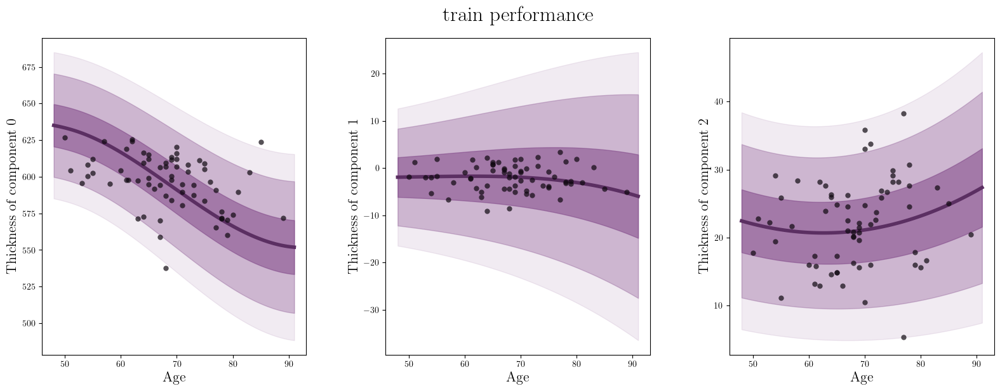

In [110]:
%%time

# sample from required columns
sample_df = train_df.copy()

# Data preperation
age = sample_df['age'].values
# age_standardized = (age - age.mean()) / age.std()
site_idxs, sites = pd.factorize(train_df['sex']*0)
sex_idxs, sexes = pd.factorize(sample_df['sex'])
# adjust for the original model flipping
sex_idxs, sexes = (1 - sex_idxs), (1 - sexes)

# Splines to model nonlinear age effects on thickness
# number of spline nuts (could be tuned)
# num_knots = 3
# knot_list = np.quantile(age_standardized, np.linspace(0, 1, num_knots))
# create b spline basis for regression using patsy
B_spline_age = patsy.build_design_matrices(
    [fixed_B_spline_age.design_info],
    {"xi": age, "knots": patsy_knots}
)[0]

coords = {
    "site": sites,
    "sex": sexes,
    "splines": np.arange(B_spline_age.shape[1]),
    "obs_id": np.arange(len(site_idxs)),
}


fig, axes = plt.subplots(1, 3, figsize=(15, 5))

for c in range(3):
    ax = axes[c]
    kernel_name = f'thickness_connectome_pc_{c}'
    thickness = sample_df[kernel_name].values
    thickness_mean = kernel_means[c]
    thickness_std = kernel_stds[c]
    thickness_standardized = (thickness - thickness_mean) / thickness_std

    # only one site: MACC
    idx = 0
    
    sns.scatterplot(
        data=sample_df,
        x='age',
        y=kernel_name,
        ax=ax,
        linewidth=0,
        alpha = 0.7,
        color = np.array(mpl.cm.Set1(idx+3)[:3])*0.1,
        zorder = 20,
    )

    ax.set_xlabel('Age', fontsize=16)
    ax.set_ylabel(f'Thickness of component {c}', fontsize=16)

    # for idx in np.unique(site_idxs):
    # only one site: MACC
    xi = xr.DataArray(np.linspace(np.min(age) - 2, np.max(age) + 2, 100), dims=["obs_id"])
    selection = (xi > 0)
    # post = advi_model_idata.posterior
    advi_model_idata = az.from_netcdf(f'{main_dir}/Normative_Modeling/data/models/pymc/MACC_tuned_connectome_rw_kernel/{kernel_name}_pymc_advi_MACC.nc')
    post = advi_model_idata.posterior

    # prediction_B_spline_age = patsy.dmatrix(
    #     "bs(xi, knots=knots, degree=3, include_intercept=True) - 1",
    #     {"xi": ((xi - age.mean()) / age.std()), "knots": knot_list[1:-1]},
    # )
    prediction_B_spline_age = patsy.build_design_matrices(
        [fixed_B_spline_age.design_info],
        {"xi": xi, "knots": patsy_knots}
    )[0]

    # y_ppc_mu = (
    #     post['intercept_sex'].stack(sample=("chain", "draw"))[0].data +
    #     post['intercept_site'].stack(sample=("chain", "draw"))[idx].data +
    #     np.dot(
    #         prediction_B_spline_age,
    #         post['w_age'].stack(sample=("chain", "draw"))
    #     )
    # )
    # y_ppc_mu_mean = y_ppc_mu.mean(1)

    y_ppc_mu_mean = (
        np.array(kernel_posterior_means['intercept_sex'][c]).mean() +
        post['intercept_site'].stack(sample=("chain", "draw"))[idx].mean().data +
        np.dot(
            prediction_B_spline_age,
            np.array(kernel_posterior_means['w_age'][c])
        )
    )

    # y_ppc_sigma = (
    #     post['error_sex'].stack(sample=("chain", "draw"))[0].data +
    #     post['error_site'].stack(sample=("chain", "draw"))[idx].data +
    #     np.dot(
    #         prediction_B_spline_age,
    #         post['w_error_age'].stack(sample=("chain", "draw"))
    #     )
    # )
    # y_ppc_sigma_mean = y_ppc_sigma.mean(1)

    y_ppc_sigma_mean = (
        np.array(kernel_posterior_means['error_sex'][c]).mean() +
        post['error_site'].stack(sample=("chain", "draw"))[idx].mean().data +
        np.dot(
            prediction_B_spline_age,
            np.array(kernel_posterior_means['w_error_age'][c])
        )
    )

    # y_ppc_alpha = post['thickness_skewness'].stack(sample=("chain", "draw")).data

    # need to ensure the correctness
    quantiles = [0.01, 0.05, 0.25, 0.50, 0.75, 0.95, 0.99]

    thickness_quantiles = {
        q: (
            (
                y_ppc_mu_mean + stats.norm.ppf(q=q) * y_ppc_sigma_mean
                # np.quantile(((y_ppc_mu + stats.norm.ppf(q=q) * y_ppc_sigma)), q, 1)
            )  * thickness_std +
            thickness_mean
        ) for q in quantiles
    }

    # centile plot
    for q1, q2, alpha in [(0.01, 0.99, 0.1), (0.05, 0.95, 0.3), (0.25, 0.75, 0.5)]:
        ax.fill_between(
            xi[selection],
            thickness_quantiles[q1][selection],
            thickness_quantiles[q2][selection],
            alpha=alpha,
            color=np.array(mpl.cm.Set1(idx+3)[:3])*0.8,
        )

    ax.plot(
        xi[selection],
        thickness_quantiles[0.5][selection],
        c=np.array(mpl.cm.Set1(idx+3)[:3])*0.6,
        lw=4,
    )

plt.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=0.3, hspace=0.)
plt.suptitle("train performance", y=1.1, fontsize=24)

## Compute the smoothing kernel

---

In [27]:
%%time
from Connectome_Spatial_Smoothing import CSS as css

smoothing_kernel_8mmFWHM = css.compute_smoothing_kernel(left_surface_file, right_surface_file, fwhm=8, epsilon=0.01,)


CPU times: user 0 ns, sys: 5.63 s, total: 5.63 s
Wall time: 3min 57s


## Compute individual deviation maps

---

In [28]:
# kernel_posterior_means_MACC['intercept_site'].isel(site=0)
rho_kernel_posterior_means_MACC['intercept_site_rho'].isel(site=0).data.shape

(1976,)

In [49]:
rho_kernel_posterior_means.isel(kernel_pair=np.where(selected_pair_mask)[0])

<xarray.Dataset> Size: 237kB
Dimensions:                    (kernel_pair: 1976, sex: 2, site: 3, splines: 5)
Coordinates:
  * sex                        (sex) float64 16B 1.0 0.0
  * site                       (site) <U13 156B 'HCP-YA-site_0' ... 'HCP-A-si...
  * splines                    (splines) int64 40B 0 1 2 3 4
Dimensions without coordinates: kernel_pair
Data variables:
    mu_intercept_site_rho      (kernel_pair) float64 16kB ...
    intercept_sex_rho          (kernel_pair, sex) float64 32kB ...
    intercept_site_offset_rho  (kernel_pair, site) float64 47kB ...
    w_age_rho                  (kernel_pair, splines) float64 79kB ...
    sigma_intercept_site_rho   (kernel_pair) float64 16kB ...
    intercept_site_rho         (kernel_pair, site) float64 47kB ...

In [29]:
sigmoid = lambda x: 1/(1 + np.exp(-x))

# A function to automatically generate the high-resolution normative range for a set of parameters
def get_high_resolution_thickness_norm_at_age(age_of_interest, sex_of_interest=0):
    n_kernel = N_kernels
    # sex was flipped in model training
    # sex_of_interest = - sex_of_interest # alternatively, replacing isel with sel should solve the issue in a more elegant way
    
    # fixed B-spline
    age_min=5
    age_max=100
    num_knots = 3
    patsy_knots = np.linspace(age_min, age_max, num_knots)[1:-1]
    # site_of_interest = 2 # HCP Aging

    prediction_B_spline_age = patsy.dmatrix(
        "bs(xi, knots=knots, degree=3, include_intercept=True) - 1",
        {
            "xi": xr.DataArray([age_min, age_of_interest, age_max], dims=["obs_id"]),
            "knots": patsy_knots
        }
    )[1]
    
    # reduce to a particular number of kernels
    kernel_posterior_means_subset = kernel_posterior_means.isel(kernel=range(n_kernel))

    kernels_y_ppc_mu_mean = (
        kernel_posterior_means_subset['intercept_sex'].sel(sex=sex_of_interest) +
        kernel_posterior_means_MACC['intercept_site'].isel(site=0) +
        xr.dot(
            xr.DataArray(np.asarray(prediction_B_spline_age), dims=["splines"]),
            kernel_posterior_means_subset['w_age']
        )
    ) * xr.DataArray(kernel_stds[:n_kernel], dims=["kernel"]) + xr.DataArray(kernel_means[:n_kernel], dims=["kernel"])
    
    feature_encoding = smoothing_kernel_8mmFWHM.T.dot(connectome_kernel_eigenvectors[:, :n_kernel])

    # high_resolution_mean_thickness_of_interest = np.array(kernels_y_ppc_mu_mean).dot(connectome_kernel_eigenvectors[:,:n_kernel].T)
    high_resolution_mean_thickness_of_interest = np.array(kernels_y_ppc_mu_mean).dot(feature_encoding.T)
    
    # reduce to a particular number of kernels
    rho_kernel_posterior_means_subset = rho_kernel_posterior_means.isel(kernel_pair=np.where(selected_pair_mask)[0])
    
    rho_ppc_mean = 2 * sigmoid(
        rho_kernel_posterior_means_subset['intercept_sex_rho'].sel(sex=sex_of_interest).data +
        rho_kernel_posterior_means_MACC['intercept_site_rho'].isel(site=0).data +
        xr.DataArray(np.asarray(prediction_B_spline_age), dims=["splines"]).dot(
            rho_kernel_posterior_means_subset['w_age_rho']
        ).data
    ) - 1

    kernels_y_ppc_sigma_mean = (
        kernel_posterior_means_subset['error_sex'].sel(sex=sex_of_interest) +
        kernel_posterior_means_MACC['error_site'].isel(site=0) +
        xr.dot(
            xr.DataArray(np.asarray(prediction_B_spline_age), dims=["splines"]),
            kernel_posterior_means_subset['w_error_age']
        )
    ) * xr.DataArray(kernel_stds[:n_kernel], dims=["kernel"])

    sparse_correlations = sparse_filler_N_kernels_masked.copy()
    sparse_correlations.data = rho_ppc_mean
    sparse_correlations = (sparse_correlations + sparse_correlations.T)
    sparse_correlations.setdiag(1)
    sparse_correlations = sparse_correlations.tocsr()[:n_kernel, :n_kernel]
    
    encoded_y_ppc_sigma_mean = np.multiply(feature_encoding, np.array(kernels_y_ppc_sigma_mean))

    high_resolution_std_thickness_of_interest = np.power(
        np.multiply(
            encoded_y_ppc_sigma_mean,
            sparse_correlations.dot(encoded_y_ppc_sigma_mean.T).T,
        ).sum(1),
        0.5
    )
    
    return high_resolution_mean_thickness_of_interest, high_resolution_std_thickness_of_interest



In [32]:
%%time

get_high_resolution_thickness_norm_at_age(60, 0)


CPU times: user 9.52 s, sys: 23.5 s, total: 33 s
Wall time: 27.4 s


(array([2.71553354, 2.12814655, 2.89914861, ..., 2.88045044, 2.89071518,
        2.87886239]),
 array([0.22030944, 0.19844371, 0.22065871, ..., 0.21528827, 0.20998979,
        0.21746569]))

In [527]:
%%time

get_high_resolution_thickness_norm_at_age(60, 0)


CPU times: user 15.8 s, sys: 2.81 s, total: 18.6 s
Wall time: 14.3 s


(array([2.71553354, 2.12814655, 2.89914861, ..., 2.88045044, 2.89071518,
        2.87886239]),
 array([0.22030944, 0.19844371, 0.22065871, ..., 0.21528827, 0.20998979,
        0.21746569]))

In [77]:
%%time
%%capture multiprocessing_log

import multiprocessing
import time

# get individual high-resolution normative ranges in parallel

PROCESSES = 24

with multiprocessing.Pool(PROCESSES) as pool:
    collected_results = pool.starmap(
        get_high_resolution_thickness_norm_at_age,
        tqdm(
            [(demography_extended_df_MACC['age'][x], demography_extended_df_MACC['sex'][x]) for x in range(demography_extended_df_MACC.shape[0])],
            total=demography_extended_df_MACC.shape[0]
        ),
    )


CPU times: user 1.4 s, sys: 3.83 s, total: 5.23 s
Wall time: 12min 51s


In [83]:
high_resolution_normative_thickness_mean_estimate_MACC = np.array([x[0] for x in collected_results])
high_resolution_normative_thickness_std_estimate_MACC = np.array([x[1] for x in collected_results])


In [366]:
# smooth thickness values
# smoothing_kernel_8mmFWHM.T.dot
smoothed_all_thickness_data_MACC = smoothing_kernel_8mmFWHM.T.dot(all_thickness_data_MACC.T).T
smoothed_all_thickness_data_MACC.shape


(674, 59412)

In [2442]:
high_resolution_normative_thickness_zscore_MACC = np.divide(
    (smoothed_all_thickness_data_MACC - high_resolution_normative_thickness_mean_estimate_MACC),
    high_resolution_normative_thickness_std_estimate_MACC
)


In [88]:
high_resolution_normative_thickness_zscore_MACC.shape

(674, 59412)

In [368]:
# store the zscores
write_np(high_resolution_normative_thickness_zscore_MACC, ensure_dir(f'{main_dir}/Normative_Modeling/data/MACC/summary/high_resolution_normative_thickness_zscore_MACC.npy'))


In [33]:
# Load the saved zscores
high_resolution_normative_thickness_zscore_MACC = np.load(f'{main_dir}/Normative_Modeling/data/MACC/summary/high_resolution_normative_thickness_zscore_MACC.npy')


## Association between overall thinning and cognition

---

In [238]:
demography_extended_df_MACC['diagnosis'].unique()

array(['NCI', 'AD', 'VCIND', 'VAD', 'CIND'], dtype=object)

In [239]:
# Let's limit the evaluations to NCI, CIND, and AD (not to complicate findings by between diagnosis differences)
study_mask = demography_extended_df_MACC['diagnosis'].isin(['NCI', 'CIND', 'AD'])


In [36]:
z_threshold = -1.96
extreme_thinning = (high_resolution_normative_thickness_zscore_MACC < z_threshold).sum(1)
demography_extended_df_MACC['extreme_thinning']=extreme_thinning
# demography_extended_df_MACC['log_extreme_thinning']=np.log10(extreme_thinning)
demography_extended_df_MACC


,subject_ID,sex,age,diagnosis,mmse,thickness_connectome_pc_0,thickness_connectome_pc_1,thickness_connectome_pc_2,thickness_connectome_pc_3,thickness_connectome_pc_4,...,thickness_connectome_pc_993,thickness_connectome_pc_994,thickness_connectome_pc_995,thickness_connectome_pc_996,thickness_connectome_pc_997,thickness_connectome_pc_998,thickness_connectome_pc_999,age_bins,split,extreme_thinning
0,HD001,0,58.000000,NCI,26.0,595.404921,-2.988673,28.387228,-47.514605,14.128553,...,2.339347,-1.838847,-1.355246,0.406034,1.422772,1.133603,-3.565102,0,Train,3009
1,HD002,1,63.000000,NCI,30.0,578.305361,4.541116,17.579084,-56.689357,15.704129,...,-0.752449,1.522519,-0.164277,2.750056,0.936918,-1.015317,0.239366,1,Test,2529
2,HD003,1,87.000000,AD,17.0,583.584819,-3.577608,21.320147,-29.771606,3.478685,...,-0.878510,1.467293,-0.041904,4.759097,-0.118015,-1.831489,1.210456,9,Test,442
3,HD004,0,72.000000,VCIND,27.0,569.606960,17.875988,33.168828,-21.237119,19.472234,...,-0.491276,-4.140618,0.997443,2.554370,-0.693051,-1.779164,-3.283816,3,Test,5668
4,HD005,0,64.000000,VAD,14.0,553.304157,-0.889549,18.389647,-31.733231,4.780241,...,0.332366,-0.161542,0.535014,0.762446,-2.808122,2.394301,0.114801,1,Test,12245
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
669,HD708,1,68.000000,CIND,25.0,566.541171,-3.745172,17.742118,-41.644337,13.038910,...,1.734526,0.424161,-2.697676,4.151448,1.480859,0.667881,-1.947132,2,Test,2686
670,HD709,0,73.394521,NCI,28.0,574.221681,-7.783637,22.753400,-36.585811,12.150714,...,0.954771,2.422085,0.484439,-0.070413,0.852638,0.977014,-2.924204,4,Test,1032
671,HD710,1,73.421918,CIND,29.0,551.158037,2.254310,9.483589,-32.421152,4.467115,...,1.567999,0.683723,-0.107798,1.236113,-1.432196,0.763503,-3.626161,4,Test,1520
672,HD711,1,61.331507,NCI,30.0,597.881738,1.841696,15.793990,-49.422621,10.084503,...,-0.204344,-0.604761,-0.094463,2.077290,-0.483792,0.731981,-4.178934,0,Train,1055


-0.3498681553387684 6.016682832300631e-19


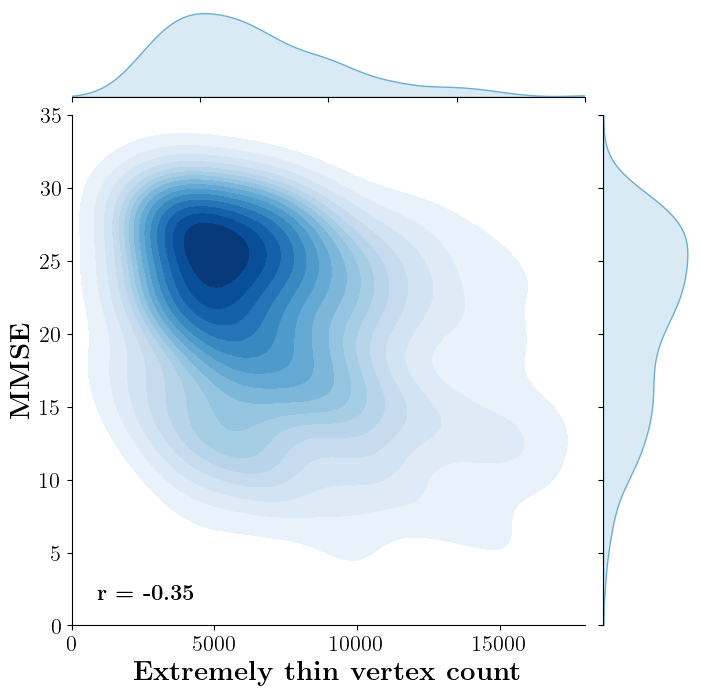

In [294]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()
sample_df = sample_df[sample_df['split'] != 'Train']
x="extreme_thinning"
y="mmse"
xlims=[0,18000]
ylims=[0,35]

sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "CI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
ad_df = sample_df[sample_df['diagnosis'].isin(['AD', 'VAD'])]
ci_df = sample_df[sample_df['diagnosis'].isin(['CIND', 'VCIND'])]

# Calculate correlation
# rho, pval = spearmanr(sample_df["extreme_thinning"], sample_df["mmse"])
rho, pval = pearsonr(sample_df["extreme_thinning"], sample_df["mmse"])
print(rho, pval)

fig = plt.figure(figsize=(8, 8))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[1:, :-1])

sns.kdeplot(data=sample_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Blues", plt.cm.Blues(np.linspace(0.05, 1, 256))), ax=ax, fill=True, levels=16, thresh=0.05)
# sns.kdeplot(data=ad_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Reds", plt.cm.Reds(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=ci_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Oranges", plt.cm.Oranges(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=healthy_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Greens", plt.cm.Greens(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{Extremely thin vertex count}", fontsize=20)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Add bold text with the correlation coefficient
# plt.figtext(0.15, 0.15, rf'\textbf{{Spearman rho = {rho:.2f}}}', 
#             fontsize=16, color='black', ha='left')
ax.text(0.05, 0.05, rf'\textbf{{r = {rho:.2f}}}', 
        fontsize=16, color='black', ha='left', transform=ax.transAxes)


ax = ax_top = fig.add_subplot(gs[0, :-1],)

sns.kdeplot(data=sample_df, x=x, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, x=x, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.5), plt.cm.Oranges(0.5), plt.cm.Reds(0.5)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_xlabel('')
ax.set_xlim(xlims)
ax.set_xticks(ax_main.get_xticks())

ax = ax_right = fig.add_subplot(gs[1:, -1])

sns.kdeplot(data=sample_df, y=y, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, y=y, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.75), plt.cm.Oranges(0.75), plt.cm.Reds(0.75)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.set_ylim(ylims)
ax.set_yticks(ax_main.get_yticks())

pass


Statistical testing at different levels

In [249]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()[study_mask]
# sample_df = sample_df[sample_df['split'] != 'Train']
x="extreme_thinning"
y="mmse"

sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "MCI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
# ad_df = sample_df[sample_df['diagnosis'].isin(['AD', 'VAD'])]
# mci_df = sample_df[sample_df['diagnosis'].isin(['CIND', 'VCIND'])]
ad_df = sample_df[sample_df['diagnosis'].isin(['AD',])]
mci_df = sample_df[sample_df['diagnosis'].isin(['CIND',])]

print("Testing association between extreme thinning and cognitive decline...")
print("\tWhole sample:")
rho, pval = pearsonr(sample_df["extreme_thinning"], sample_df["mmse"])
print(f"\tr = {rho:.2f}, p < {(pval+0.0001):.4f}, N = {sample_df.shape[0]:d}")

print("\tHealthy:")
rho, pval = pearsonr(healthy_df["extreme_thinning"], healthy_df["mmse"])
print(f"\tr = {rho:.2f}, p < {(pval+0.0001):.4f}, N = {healthy_df.shape[0]:d}")

print("\tMCI:")
rho, pval = pearsonr(mci_df["extreme_thinning"], mci_df["mmse"])
print(f"\tr = {rho:.2f}, p < {(pval+0.0001):.4f}, N = {mci_df.shape[0]:d}")

print("\tAD:")
rho, pval = pearsonr(ad_df["extreme_thinning"], ad_df["mmse"])
print(f"\tr = {rho:.2f}, p < {(pval+0.0001):.4f}, N = {ad_df.shape[0]:d}")



Testing association between extreme thinning and cognitive decline...
	Whole sample:
	r = -0.45, p < 0.0001, N = 542
	Healthy:
	r = -0.00, p < 0.9563, N = 132
	MCI:
	r = -0.10, p < 0.1398, N = 202
	AD:
	r = -0.31, p < 0.0001, N = 208


Plot overall association between mmse and thinning

-0.4492957549335928 2.755924214178804e-28


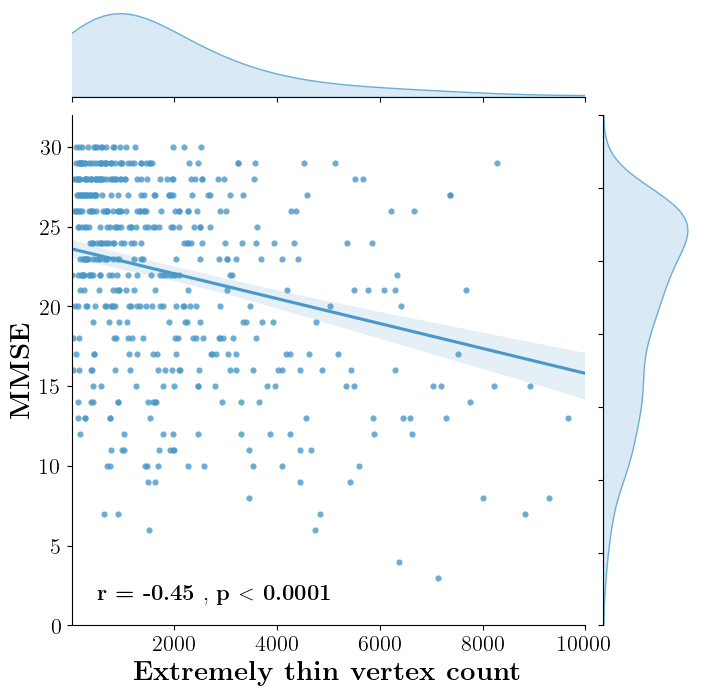

In [251]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()[study_mask]
# sample_df = sample_df[sample_df['split'] != 'Train']
x="extreme_thinning"
y="mmse"
xlims=[1,10000]
ylims=[0,32]

sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "CI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
# ad_df = sample_df[sample_df['diagnosis'].isin(['AD', 'VAD'])]
# mci_df = sample_df[sample_df['diagnosis'].isin(['CIND', 'VCIND'])]
ad_df = sample_df[sample_df['diagnosis'].isin(['AD',])]
mci_df = sample_df[sample_df['diagnosis'].isin(['CIND',])]

# Calculate correlation
# rho, pval = spearmanr(sample_df["extreme_thinning"], sample_df["mmse"])
rho, pval = pearsonr(sample_df["extreme_thinning"], sample_df["mmse"])
print(rho, pval)

fig = plt.figure(figsize=(8, 8))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[1:, :-1])

sns.regplot(data=sample_df, x=x, y=y, ax=ax, color=plt.cm.Blues(0.6), scatter_kws={'linewidths': 0, 's': 20,})
# sns.kdeplot(data=sample_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Blues", plt.cm.Blues(np.linspace(0.05, 1, 256))), ax=ax, fill=True, levels=16, thresh=0.05)
# sns.kdeplot(data=ad_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Reds", plt.cm.Reds(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=ci_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Oranges", plt.cm.Oranges(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=healthy_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Greens", plt.cm.Greens(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{Extremely thin vertex count}", fontsize=20)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Add bold text with the correlation coefficient
# plt.figtext(0.15, 0.15, rf'\textbf{{Spearman rho = {rho:.2f}}}', 
#             fontsize=16, color='black', ha='left')
message = rf'\textbf{{r = {rho:.2f}}}'
if pval < 0.0001:
    message = rf'{message} , \textbf{{p $<$ 0.0001}}'
ax.text(0.05, 0.05, message, 
        fontsize=16, color='black', ha='left', transform=ax.transAxes)


ax = ax_top = fig.add_subplot(gs[0, :-1],)

sns.kdeplot(data=sample_df, x=x, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, x=x, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.5), plt.cm.Oranges(0.5), plt.cm.Reds(0.5)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_xlabel('')
ax.set_xlim(xlims)
ax.set_xticks(ax_main.get_xticks())

ax = ax_right = fig.add_subplot(gs[1:, -1])

sns.kdeplot(data=sample_df, y=y, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, y=y, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.75), plt.cm.Oranges(0.75), plt.cm.Reds(0.75)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.set_ylim(ylims)
ax.set_yticks(ax_main.get_yticks())

pass


-0.3725382041894656 1.8788096969815908e-21


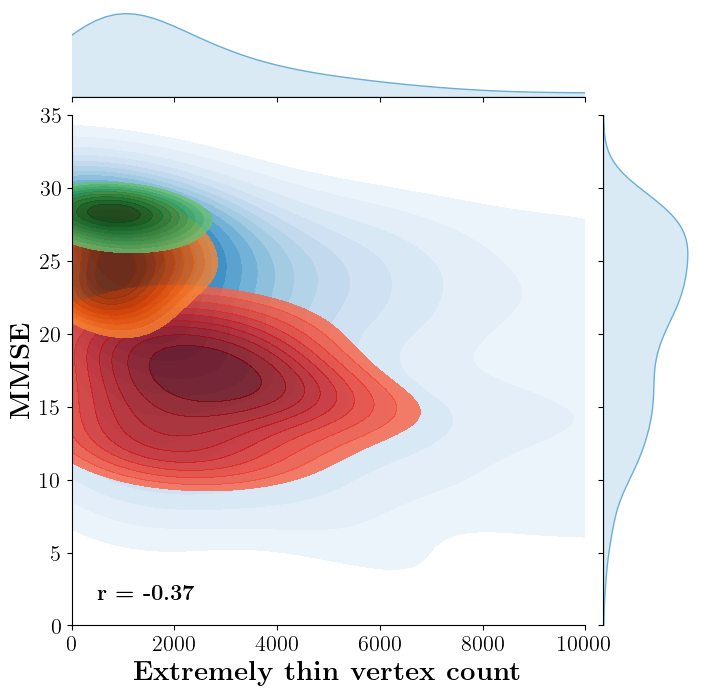

In [415]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()
sample_df = sample_df[sample_df['split'] != 'Train']
x="extreme_thinning"
y="mmse"
xlims=[0,10000]
ylims=[0,35]

sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "CI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
ad_df = sample_df[sample_df['diagnosis'].isin(['AD', 'VAD'])]
ci_df = sample_df[sample_df['diagnosis'].isin(['CIND', 'VCIND'])]

# Calculate correlation
# rho, pval = spearmanr(sample_df["extreme_thinning"], sample_df["mmse"])
rho, pval = pearsonr(sample_df["extreme_thinning"], sample_df["mmse"])
print(rho, pval)

fig = plt.figure(figsize=(8, 8))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[1:, :-1])

sns.kdeplot(data=sample_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Blues", plt.cm.Blues(np.linspace(0.05, 1, 256))), ax=ax, fill=True, levels=16, thresh=0.05)
sns.kdeplot(data=ad_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Reds", plt.cm.Reds(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.5, alpha=0.8)
sns.kdeplot(data=ci_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Oranges", plt.cm.Oranges(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.5, alpha=0.8)
sns.kdeplot(data=healthy_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Greens", plt.cm.Greens(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.5, alpha=0.8)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{Extremely thin vertex count}", fontsize=20)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Add bold text with the correlation coefficient
# plt.figtext(0.15, 0.15, rf'\textbf{{Spearman rho = {rho:.2f}}}', 
#             fontsize=16, color='black', ha='left')
ax.text(0.05, 0.05, rf'\textbf{{r = {rho:.2f}}}', 
        fontsize=16, color='black', ha='left', transform=ax.transAxes)


ax = ax_top = fig.add_subplot(gs[0, :-1],)

sns.kdeplot(data=sample_df, x=x, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, x=x, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.5), plt.cm.Oranges(0.5), plt.cm.Reds(0.5)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_xlabel('')
ax.set_xlim(xlims)
ax.set_xticks(ax_main.get_xticks())

ax = ax_right = fig.add_subplot(gs[1:, -1])

sns.kdeplot(data=sample_df, y=y, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, y=y, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.75), plt.cm.Oranges(0.75), plt.cm.Reds(0.75)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.set_ylim(ylims)
ax.set_yticks(ax_main.get_yticks())

pass


In [489]:
np.linspace(-4, 4, 81)

array([-4. , -3.9, -3.8, -3.7, -3.6, -3.5, -3.4, -3.3, -3.2, -3.1, -3. ,
       -2.9, -2.8, -2.7, -2.6, -2.5, -2.4, -2.3, -2.2, -2.1, -2. , -1.9,
       -1.8, -1.7, -1.6, -1.5, -1.4, -1.3, -1.2, -1.1, -1. , -0.9, -0.8,
       -0.7, -0.6, -0.5, -0.4, -0.3, -0.2, -0.1,  0. ,  0.1,  0.2,  0.3,
        0.4,  0.5,  0.6,  0.7,  0.8,  0.9,  1. ,  1.1,  1.2,  1.3,  1.4,
        1.5,  1.6,  1.7,  1.8,  1.9,  2. ,  2.1,  2.2,  2.3,  2.4,  2.5,
        2.6,  2.7,  2.8,  2.9,  3. ,  3.1,  3.2,  3.3,  3.4,  3.5,  3.6,
        3.7,  3.8,  3.9,  4. ])

In [37]:
# test association at different z score limits
cognition_score = np.array(demography_extended_df_MACC['mmse'])[study_mask]

z_thresholds = np.linspace(-4, 4, 81)

extreme_values = np.concatenate(
    [
        (high_resolution_normative_thickness_zscore_MACC < z).sum(1)[None, :]
        for z in z_thresholds
    ],
)[:, study_mask]

# Associate different centiles with cognition score
cognition_score_norm = (cognition_score - cognition_score.mean()) / cognition_score.std()

extreme_values_norm = (extreme_values - extreme_values.mean(1)[:, None]) / extreme_values.std(1)[:, None]

cognition_thinning_association = extreme_values_norm.dot(cognition_score_norm)/cognition_score_norm.shape[0]


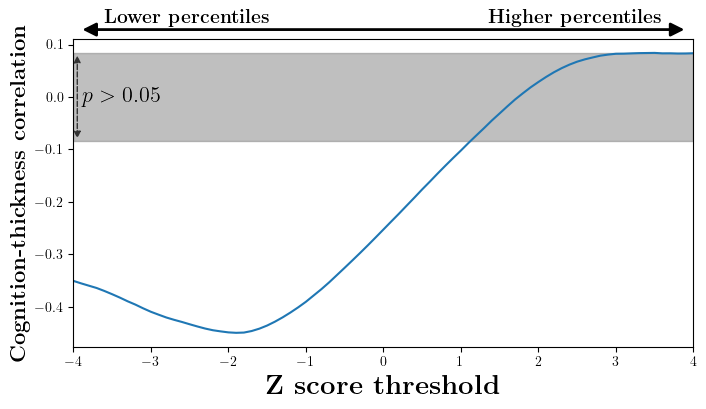

In [255]:
fig = plt.figure(figsize=(8, 4))
gs = fig.add_gridspec(1, 1, wspace=0.2)
ax = fig.add_subplot(gs[0, 0])

sns.lineplot(x=z_thresholds, y= cognition_thinning_association, ax=ax)

pval = 0.05
sample_size = cognition_score_norm.shape[0]
df = sample_size - 2
tval = stats.t.ppf(1 - (pval / 2), df)
rval = tval / np.sqrt(tval**2 + df)

ax.fill_between([-4,4], [-rval, -rval], [rval, rval], color=(0.5, 0.5, 0.5, 0.5))

ax.set_xlim(-4,4)
ax.set_xlabel(r"\textbf{Z score threshold}", fontsize=20)
ax.set_ylabel(r"\textbf{Cognition-thickness correlation}", fontsize=16)
ax.annotate('', xy=(0.01, 1.03), xytext=(0.99, 1.03), arrowprops=dict(arrowstyle='<|-|>', color='black', mutation_scale=20, linewidth=2), xycoords='axes fraction', textcoords='axes fraction')
ax.text(0.05, 1.05, rf'\textbf{{Lower percentiles}}', fontsize=14, color='black', ha='left', transform=ax.transAxes)
ax.text(0.95, 1.05, rf'\textbf{{Higher percentiles}}', fontsize=14, color='black', ha='right', transform=ax.transAxes)

ax.annotate('', xy=(-3.95, -rval), xytext=(-3.95, rval), arrowprops=dict(arrowstyle='<|-|>', linestyle='--', color=(0.2, 0.2, 0.2), mutation_scale=10, linewidth=1))
ax.text(-3.9, 0.0, rf'$p > 0.05$', fontsize=16, color='black', ha='left', va='center')

pass


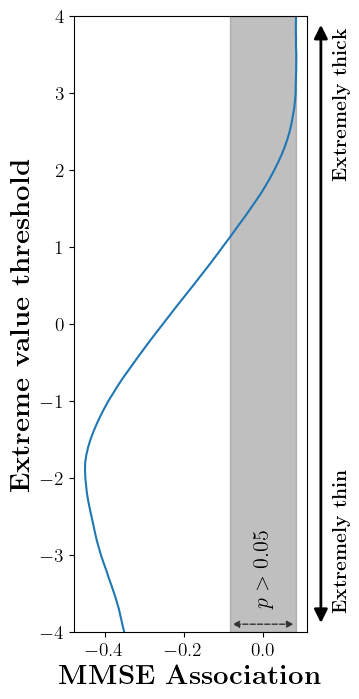

In [256]:
fig = plt.figure(figsize=(3, 8))
gs = fig.add_gridspec(1, 1, wspace=0.2)
ax = fig.add_subplot(gs[0, 0])

sns.lineplot(x=cognition_thinning_association, y=z_thresholds, ax=ax, sort=False)

pval = 0.05
sample_size = cognition_score_norm.shape[0]
df = sample_size - 2
tval = stats.t.ppf(1 - (pval / 2), df)
rval = tval / np.sqrt(tval**2 + df)

# ax.fill_between([-4,4], [-rval, -rval], [rval, rval], color=(0.5, 0.5, 0.5, 0.5))
ax.fill_between([-rval,rval], [-4, -4], [4, 4], color=(0.5, 0.5, 0.5, 0.5))

ax.set_ylim(-4,4)
ax.set_ylabel(r"\textbf{Extreme value threshold}", fontsize=20)
ax.set_xlabel(r"\textbf{MMSE Association}", fontsize=20)
ax.annotate('', xy=(1.06, 0.01), xytext=(1.06, 0.99), arrowprops=dict(arrowstyle='<|-|>', color='black', mutation_scale=20, linewidth=2), xycoords='axes fraction', textcoords='axes fraction')
ax.text(1.11, 0.03, rf'\textbf{{Extremely thin}}', fontsize=14, color='black', va='bottom', transform=ax.transAxes, rotation=90)
ax.text(1.11, 0.98, rf'\textbf{{Extremely thick}}', fontsize=14, color='black', va='top', transform=ax.transAxes, rotation=90)

ax.annotate('', xy=(-rval, -3.9), xytext=(rval, -3.9), arrowprops=dict(arrowstyle='<|-|>', linestyle='--', color=(0.2, 0.2, 0.2), mutation_scale=10, linewidth=1))
ax.text(0.0, -3.7, rf'$p > 0.05$', fontsize=16, color='black', ha='center', va='bottom', rotation=90)

ax.tick_params(axis='both', which='major', labelsize=14)
pass


### Within AD

--

In [38]:
study_ad_mask = demography_extended_df_MACC['diagnosis'].isin(['AD'])[study_mask]
cognition_score_ad = cognition_score[study_ad_mask]
extreme_values_ad = extreme_values[:, study_ad_mask]

cognition_score_ad_norm = (cognition_score_ad - cognition_score_ad.mean()) / cognition_score_ad.std()

extreme_values_ad_norm = (extreme_values_ad - extreme_values_ad.mean(1)[:, None]) / extreme_values_ad.std(1)[:, None]

cognition_thinning_association_ad = extreme_values_ad_norm.dot(cognition_score_ad_norm)/cognition_score_ad_norm.shape[0]

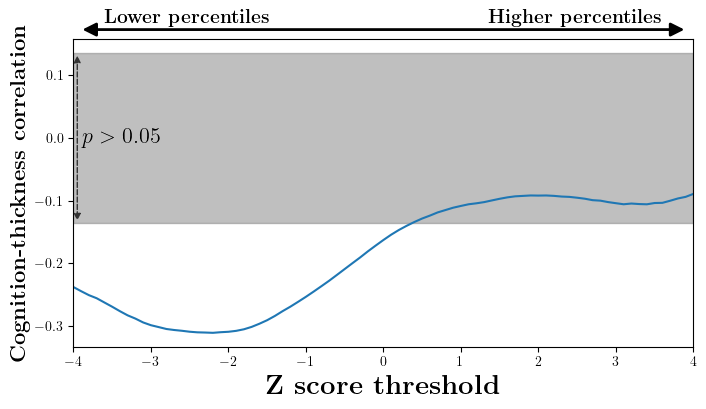

In [258]:
fig = plt.figure(figsize=(8, 4))
gs = fig.add_gridspec(1, 1, wspace=0.2)
ax = fig.add_subplot(gs[0, 0])

sns.lineplot(x=z_thresholds, y= cognition_thinning_association_ad, ax=ax)

pval = 0.05
sample_size = cognition_score_ad_norm.shape[0]
df = sample_size - 2
tval = stats.t.ppf(1 - (pval / 2), df)
rval = tval / np.sqrt(tval**2 + df)

ax.fill_between([-4,4], [-rval, -rval], [rval, rval], color=(0.5, 0.5, 0.5, 0.5))

ax.set_xlim(-4,4)
ax.set_xlabel(r"\textbf{Z score threshold}", fontsize=20)
ax.set_ylabel(r"\textbf{Cognition-thickness correlation}", fontsize=16)
ax.annotate('', xy=(0.01, 1.03), xytext=(0.99, 1.03), arrowprops=dict(arrowstyle='<|-|>', color='black', mutation_scale=20, linewidth=2), xycoords='axes fraction', textcoords='axes fraction')
ax.text(0.05, 1.05, rf'\textbf{{Lower percentiles}}', fontsize=14, color='black', ha='left', transform=ax.transAxes)
ax.text(0.95, 1.05, rf'\textbf{{Higher percentiles}}', fontsize=14, color='black', ha='right', transform=ax.transAxes)

ax.annotate('', xy=(-3.95, -rval), xytext=(-3.95, rval), arrowprops=dict(arrowstyle='<|-|>', linestyle='--', color=(0.2, 0.2, 0.2), mutation_scale=10, linewidth=1))
ax.text(-3.9, 0.0, rf'$p > 0.05$', fontsize=16, color='black', ha='left', va='center')

pass


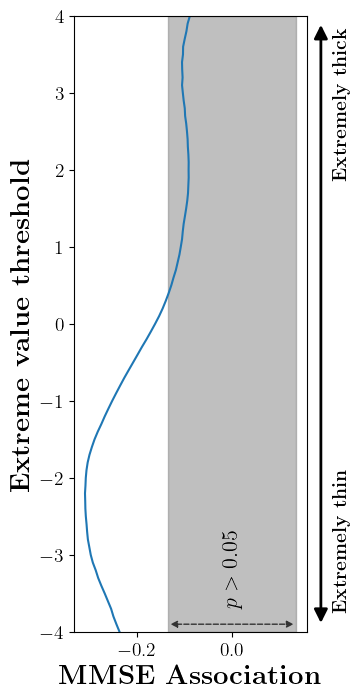

In [259]:
fig = plt.figure(figsize=(3, 8))
gs = fig.add_gridspec(1, 1, wspace=0.2)
ax = fig.add_subplot(gs[0, 0])

sns.lineplot(x=cognition_thinning_association_ad, y=z_thresholds, ax=ax, sort=False)

pval = 0.05
sample_size = cognition_score_ad_norm.shape[0]
df = sample_size - 2
tval = stats.t.ppf(1 - (pval / 2), df)
rval = tval / np.sqrt(tval**2 + df)

# ax.fill_between([-4,4], [-rval, -rval], [rval, rval], color=(0.5, 0.5, 0.5, 0.5))
ax.fill_between([-rval,rval], [-4, -4], [4, 4], color=(0.5, 0.5, 0.5, 0.5))

ax.set_ylim(-4,4)
ax.set_ylabel(r"\textbf{Extreme value threshold}", fontsize=20)
ax.set_xlabel(r"\textbf{MMSE Association}", fontsize=20)
ax.annotate('', xy=(1.06, 0.01), xytext=(1.06, 0.99), arrowprops=dict(arrowstyle='<|-|>', color='black', mutation_scale=20, linewidth=2), xycoords='axes fraction', textcoords='axes fraction')
ax.text(1.11, 0.03, rf'\textbf{{Extremely thin}}', fontsize=14, color='black', va='bottom', transform=ax.transAxes, rotation=90)
ax.text(1.11, 0.98, rf'\textbf{{Extremely thick}}', fontsize=14, color='black', va='top', transform=ax.transAxes, rotation=90)

ax.annotate('', xy=(-rval, -3.9), xytext=(rval, -3.9), arrowprops=dict(arrowstyle='<|-|>', linestyle='--', color=(0.2, 0.2, 0.2), mutation_scale=10, linewidth=1))
ax.text(0.0, -3.7, rf'$p > 0.05$', fontsize=16, color='black', ha='center', va='bottom', rotation=90)

ax.tick_params(axis='both', which='major', labelsize=14)
pass


-0.30873988401217445 5.700241641566599e-06


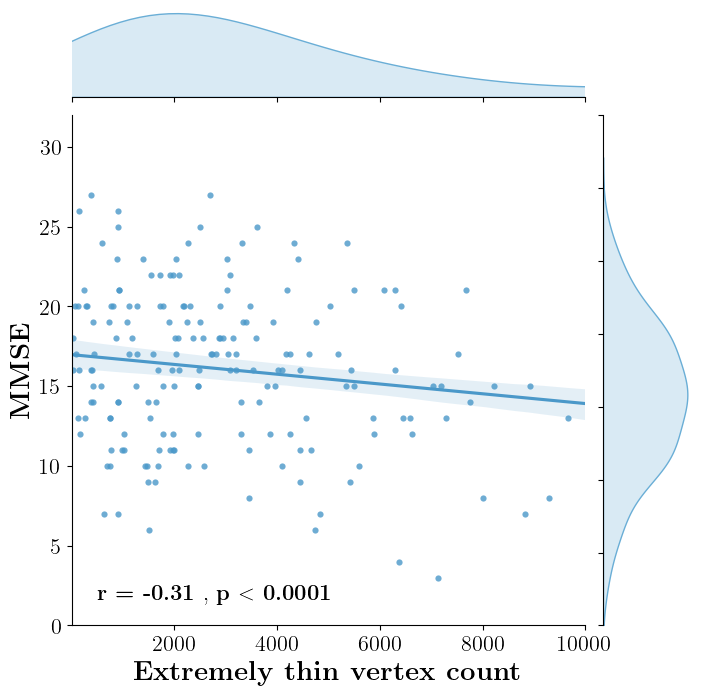

In [260]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()[study_mask]
# sample_df = sample_df[sample_df['split'] != 'Train']
x="extreme_thinning"
y="mmse"
xlims=[1,10000]
ylims=[0,32]

sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "CI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
ad_df = sample_df[sample_df['diagnosis'].isin(['AD',])]
ci_df = sample_df[sample_df['diagnosis'].isin(['CIND',])]

# Calculate correlation
# rho, pval = spearmanr(sample_df["extreme_thinning"], sample_df["mmse"])
rho, pval = pearsonr(ad_df["extreme_thinning"], ad_df["mmse"])
print(rho, pval)

fig = plt.figure(figsize=(8, 8))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[1:, :-1])

sns.regplot(data=ad_df, x=x, y=y, ax=ax, color=plt.cm.Blues(0.6), scatter_kws={'linewidths': 0, 's': 20,})
# sns.kdeplot(data=sample_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Blues", plt.cm.Blues(np.linspace(0.05, 1, 256))), ax=ax, fill=True, levels=16, thresh=0.05)
# sns.kdeplot(data=ad_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Reds", plt.cm.Reds(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=ci_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Oranges", plt.cm.Oranges(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=healthy_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Greens", plt.cm.Greens(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{Extremely thin vertex count}", fontsize=20)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Add bold text with the correlation coefficient
# plt.figtext(0.15, 0.15, rf'\textbf{{Spearman rho = {rho:.2f}}}', 
#             fontsize=16, color='black', ha='left')
message = rf'\textbf{{r = {rho:.2f}}}'
if pval < 0.0001:
    message = rf'{message} , \textbf{{p $<$ 0.0001}}'
ax.text(0.05, 0.05, message, 
        fontsize=16, color='black', ha='left', transform=ax.transAxes)


ax = ax_top = fig.add_subplot(gs[0, :-1],)

sns.kdeplot(data=ad_df, x=x, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, x=x, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.5), plt.cm.Oranges(0.5), plt.cm.Reds(0.5)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_xlabel('')
ax.set_xlim(xlims)
ax.set_xticks(ax_main.get_xticks())

ax = ax_right = fig.add_subplot(gs[1:, -1])

sns.kdeplot(data=ad_df, y=y, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, y=y, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.75), plt.cm.Oranges(0.75), plt.cm.Reds(0.75)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.set_ylim(ylims)
ax.set_yticks(ax_main.get_yticks())

pass


### Within MCI

--

In [39]:
study_mc_mask = demography_extended_df_MACC['diagnosis'].isin(['CIND',])[study_mask]
cognition_score_mc = cognition_score[study_mc_mask]
extreme_values_mc = extreme_values[:, study_mc_mask]

cognition_score_mc_norm = (cognition_score_mc - cognition_score_mc.mean()) / cognition_score_mc.std()

extreme_values_mc_norm = (extreme_values_mc - extreme_values_mc.mean(1)[:, None]) / extreme_values_mc.std(1)[:, None]

cognition_thinning_association_mc = extreme_values_mc_norm.dot(cognition_score_mc_norm)/cognition_score_mc_norm.shape[0]

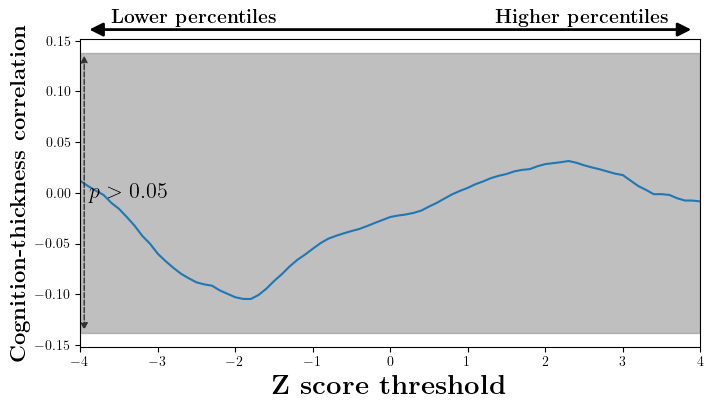

In [263]:
fig = plt.figure(figsize=(8, 4))
gs = fig.add_gridspec(1, 1, wspace=0.2)
ax = fig.add_subplot(gs[0, 0])

sns.lineplot(x=z_thresholds, y= cognition_thinning_association_mc, ax=ax)

pval = 0.05
sample_size = cognition_score_mc_norm.shape[0]
df = sample_size - 2
tval = stats.t.ppf(1 - (pval / 2), df)
rval = tval / np.sqrt(tval**2 + df)

ax.fill_between([-4,4], [-rval, -rval], [rval, rval], color=(0.5, 0.5, 0.5, 0.5))

ax.set_xlim(-4,4)
ax.set_xlabel(r"\textbf{Z score threshold}", fontsize=20)
ax.set_ylabel(r"\textbf{Cognition-thickness correlation}", fontsize=16)
ax.annotate('', xy=(0.01, 1.03), xytext=(0.99, 1.03), arrowprops=dict(arrowstyle='<|-|>', color='black', mutation_scale=20, linewidth=2), xycoords='axes fraction', textcoords='axes fraction')
ax.text(0.05, 1.05, rf'\textbf{{Lower percentiles}}', fontsize=14, color='black', ha='left', transform=ax.transAxes)
ax.text(0.95, 1.05, rf'\textbf{{Higher percentiles}}', fontsize=14, color='black', ha='right', transform=ax.transAxes)

ax.annotate('', xy=(-3.95, -rval), xytext=(-3.95, rval), arrowprops=dict(arrowstyle='<|-|>', linestyle='--', color=(0.2, 0.2, 0.2), mutation_scale=10, linewidth=1))
ax.text(-3.9, 0.0, rf'$p > 0.05$', fontsize=16, color='black', ha='left', va='center')

pass


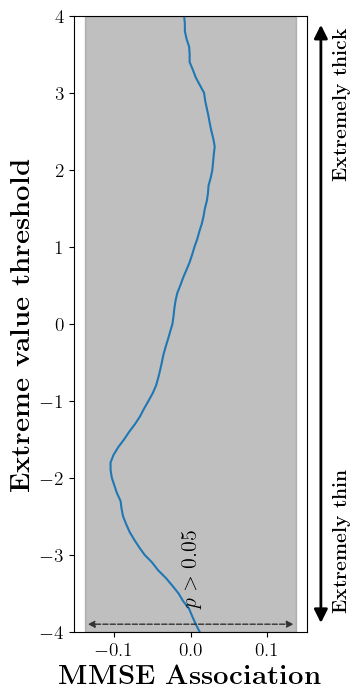

In [264]:
fig = plt.figure(figsize=(3, 8))
gs = fig.add_gridspec(1, 1, wspace=0.2)
ax = fig.add_subplot(gs[0, 0])

sns.lineplot(x=cognition_thinning_association_mc, y=z_thresholds, ax=ax, sort=False)

pval = 0.05
sample_size = cognition_score_mc_norm.shape[0]
df = sample_size - 2
tval = stats.t.ppf(1 - (pval / 2), df)
rval = tval / np.sqrt(tval**2 + df)

# ax.fill_between([-4,4], [-rval, -rval], [rval, rval], color=(0.5, 0.5, 0.5, 0.5))
ax.fill_between([-rval,rval], [-4, -4], [4, 4], color=(0.5, 0.5, 0.5, 0.5))

ax.set_ylim(-4,4)
ax.set_ylabel(r"\textbf{Extreme value threshold}", fontsize=20)
ax.set_xlabel(r"\textbf{MMSE Association}", fontsize=20)
ax.annotate('', xy=(1.06, 0.01), xytext=(1.06, 0.99), arrowprops=dict(arrowstyle='<|-|>', color='black', mutation_scale=20, linewidth=2), xycoords='axes fraction', textcoords='axes fraction')
ax.text(1.11, 0.03, rf'\textbf{{Extremely thin}}', fontsize=14, color='black', va='bottom', transform=ax.transAxes, rotation=90)
ax.text(1.11, 0.98, rf'\textbf{{Extremely thick}}', fontsize=14, color='black', va='top', transform=ax.transAxes, rotation=90)

ax.annotate('', xy=(-rval, -3.9), xytext=(rval, -3.9), arrowprops=dict(arrowstyle='<|-|>', linestyle='--', color=(0.2, 0.2, 0.2), mutation_scale=10, linewidth=1))
ax.text(0.0, -3.7, rf'$p > 0.05$', fontsize=16, color='black', ha='center', va='bottom', rotation=90)

ax.tick_params(axis='both', which='major', labelsize=14)
pass


-0.10428135693174037 0.13968941601573345


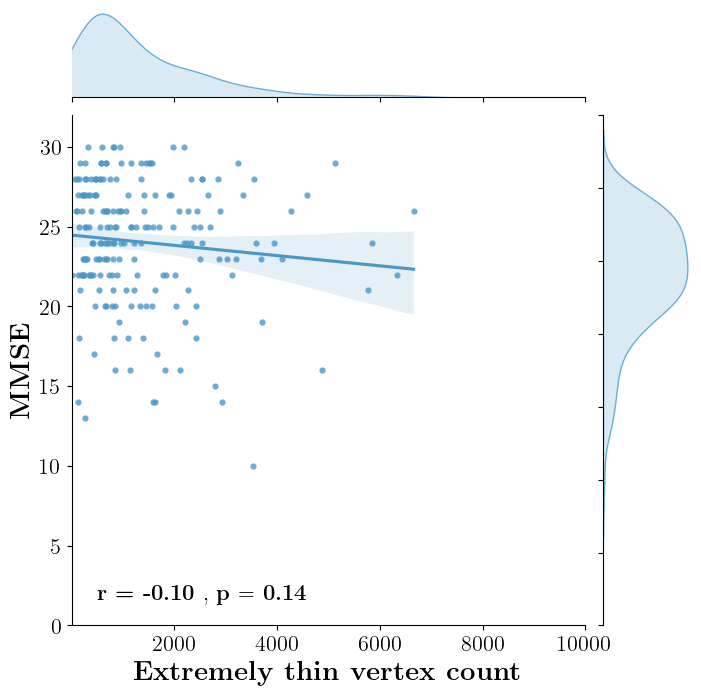

In [265]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()
sample_df = sample_df[sample_df['split'] != 'Train']
x="extreme_thinning"
y="mmse"
xlims=[1,10000]
ylims=[0,32]

sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "CI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
ad_df = sample_df[sample_df['diagnosis'].isin(['AD',])]
ci_df = sample_df[sample_df['diagnosis'].isin(['CIND',])]

# Calculate correlation
# rho, pval = spearmanr(sample_df["extreme_thinning"], sample_df["mmse"])
rho, pval = pearsonr(ci_df["extreme_thinning"], ci_df["mmse"])
print(rho, pval)

fig = plt.figure(figsize=(8, 8))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[1:, :-1])

sns.regplot(data=ci_df, x=x, y=y, ax=ax, color=plt.cm.Blues(0.6), scatter_kws={'linewidths': 0, 's': 20,})
# sns.kdeplot(data=sample_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Blues", plt.cm.Blues(np.linspace(0.05, 1, 256))), ax=ax, fill=True, levels=16, thresh=0.05)
# sns.kdeplot(data=ad_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Reds", plt.cm.Reds(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=ci_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Oranges", plt.cm.Oranges(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=healthy_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Greens", plt.cm.Greens(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{Extremely thin vertex count}", fontsize=20)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Add bold text with the correlation coefficient
# plt.figtext(0.15, 0.15, rf'\textbf{{Spearman rho = {rho:.2f}}}', 
#             fontsize=16, color='black', ha='left')
message = rf'\textbf{{r = {rho:.2f}}}'
if pval < 0.0001:
    message = rf'{message} , \textbf{{p $<$ 0.0001}}'
else:
    message = rf'{message} , \textbf{{p $=$ {pval:.2f}}}'
ax.text(0.05, 0.05, message, 
        fontsize=16, color='black', ha='left', transform=ax.transAxes)


ax = ax_top = fig.add_subplot(gs[0, :-1],)

sns.kdeplot(data=ci_df, x=x, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, x=x, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.5), plt.cm.Oranges(0.5), plt.cm.Reds(0.5)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_xlabel('')
ax.set_xlim(xlims)
ax.set_xticks(ax_main.get_xticks())

ax = ax_right = fig.add_subplot(gs[1:, -1])

sns.kdeplot(data=ci_df, y=y, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, y=y, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.75), plt.cm.Oranges(0.75), plt.cm.Reds(0.75)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.set_ylim(ylims)
ax.set_yticks(ax_main.get_yticks())

pass


In [268]:
# simple parametric FDR
corr, corr_p_value = stats.pearsonr(cognition_score[study_mc_mask,np.newaxis], high_resolution_normative_thickness_zscore_MACC[study_mask, :][study_mc_mask,:])
rejected, corrected_corr_p_value, _, _ = multipletests(corr_p_value, alpha=0.05, method='fdr_bh')


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 31.2 s, sys: 1.78 s, total: 33 s
Wall time: 34.5 s


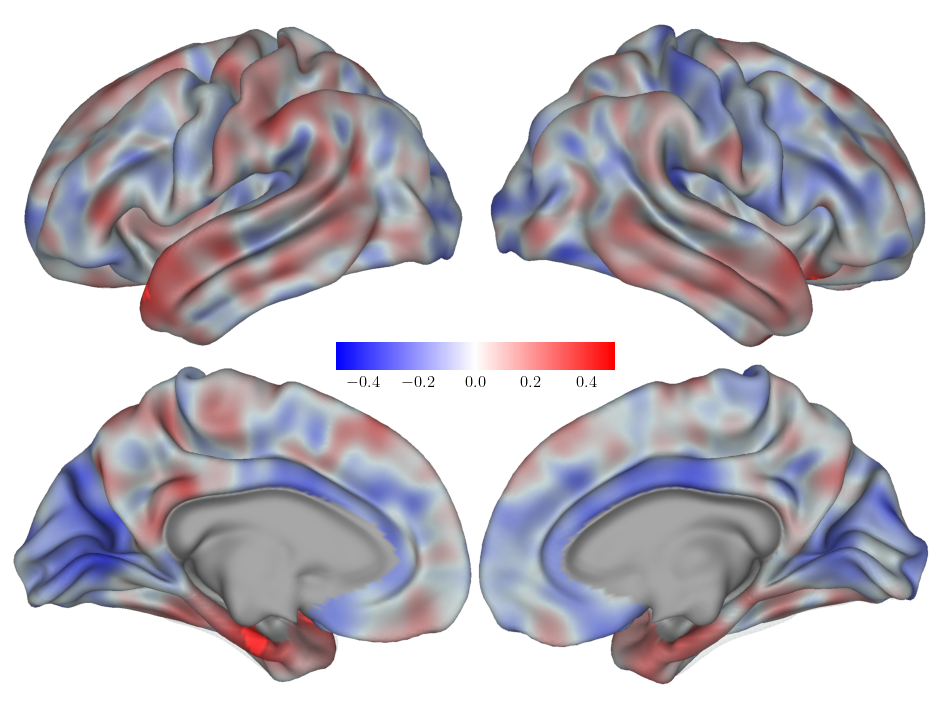

In [269]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = corr.copy()
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[(0.05<sample_nonparametric_p_value) & (sample_nonparametric_p_value<0.2)] = 1
# lims = np.percentile(signal,[2,98])
lims = [-0.5, 0.5]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=plt.cm.bwr,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    cover=(~rejected).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)


### Within HC

--

In [40]:
study_hc_mask = demography_extended_df_MACC['diagnosis'].isin(['NCI'])[study_mask]
cognition_score_hc = cognition_score[study_hc_mask]
extreme_values_hc = extreme_values[:, study_hc_mask]

cognition_score_hc_norm = (cognition_score_hc - cognition_score_hc.mean()) / cognition_score_hc.std()

extreme_values_hc_norm = (extreme_values_hc - extreme_values_hc.mean(1)[:, None]) / extreme_values_hc.std(1)[:, None]

cognition_thinning_association_hc = extreme_values_hc_norm.dot(cognition_score_hc_norm)/cognition_score_hc_norm.shape[0]

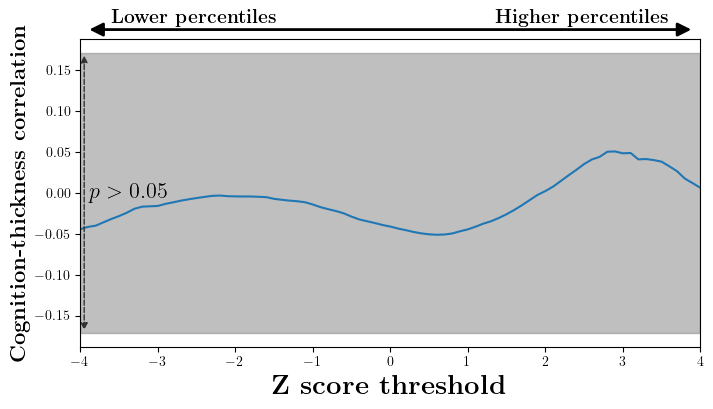

In [271]:
fig = plt.figure(figsize=(8, 4))
gs = fig.add_gridspec(1, 1, wspace=0.2)
ax = fig.add_subplot(gs[0, 0])

sns.lineplot(x=z_thresholds, y= cognition_thinning_association_hc, ax=ax)

pval = 0.05
sample_size = cognition_score_hc_norm.shape[0]
df = sample_size - 2
tval = stats.t.ppf(1 - (pval / 2), df)
rval = tval / np.sqrt(tval**2 + df)

ax.fill_between([-4,4], [-rval, -rval], [rval, rval], color=(0.5, 0.5, 0.5, 0.5))

ax.set_xlim(-4,4)
ax.set_xlabel(r"\textbf{Z score threshold}", fontsize=20)
ax.set_ylabel(r"\textbf{Cognition-thickness correlation}", fontsize=16)
ax.annotate('', xy=(0.01, 1.03), xytext=(0.99, 1.03), arrowprops=dict(arrowstyle='<|-|>', color='black', mutation_scale=20, linewidth=2), xycoords='axes fraction', textcoords='axes fraction')
ax.text(0.05, 1.05, rf'\textbf{{Lower percentiles}}', fontsize=14, color='black', ha='left', transform=ax.transAxes)
ax.text(0.95, 1.05, rf'\textbf{{Higher percentiles}}', fontsize=14, color='black', ha='right', transform=ax.transAxes)

ax.annotate('', xy=(-3.95, -rval), xytext=(-3.95, rval), arrowprops=dict(arrowstyle='<|-|>', linestyle='--', color=(0.2, 0.2, 0.2), mutation_scale=10, linewidth=1))
ax.text(-3.9, 0.0, rf'$p > 0.05$', fontsize=16, color='black', ha='left', va='center')

pass


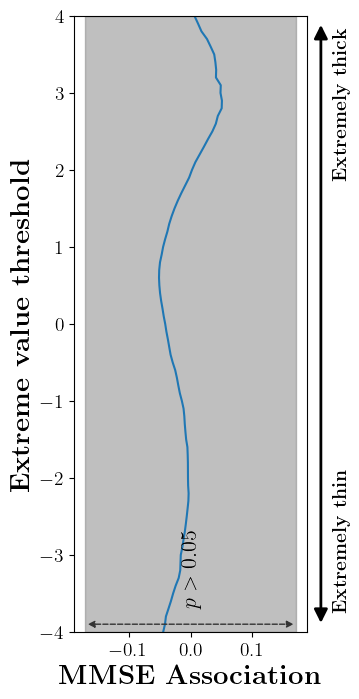

In [272]:
fig = plt.figure(figsize=(3, 8))
gs = fig.add_gridspec(1, 1, wspace=0.2)
ax = fig.add_subplot(gs[0, 0])

sns.lineplot(x=cognition_thinning_association_hc, y=z_thresholds, ax=ax, sort=False)

pval = 0.05
sample_size = cognition_score_hc_norm.shape[0]
df = sample_size - 2
tval = stats.t.ppf(1 - (pval / 2), df)
rval = tval / np.sqrt(tval**2 + df)

# ax.fill_between([-4,4], [-rval, -rval], [rval, rval], color=(0.5, 0.5, 0.5, 0.5))
ax.fill_between([-rval,rval], [-4, -4], [4, 4], color=(0.5, 0.5, 0.5, 0.5))

ax.set_ylim(-4,4)
ax.set_ylabel(r"\textbf{Extreme value threshold}", fontsize=20)
ax.set_xlabel(r"\textbf{MMSE Association}", fontsize=20)
ax.annotate('', xy=(1.06, 0.01), xytext=(1.06, 0.99), arrowprops=dict(arrowstyle='<|-|>', color='black', mutation_scale=20, linewidth=2), xycoords='axes fraction', textcoords='axes fraction')
ax.text(1.11, 0.03, rf'\textbf{{Extremely thin}}', fontsize=14, color='black', va='bottom', transform=ax.transAxes, rotation=90)
ax.text(1.11, 0.98, rf'\textbf{{Extremely thick}}', fontsize=14, color='black', va='top', transform=ax.transAxes, rotation=90)

ax.annotate('', xy=(-rval, -3.9), xytext=(rval, -3.9), arrowprops=dict(arrowstyle='<|-|>', linestyle='--', color=(0.2, 0.2, 0.2), mutation_scale=10, linewidth=1))
ax.text(0.0, -3.7, rf'$p > 0.05$', fontsize=16, color='black', ha='center', va='bottom', rotation=90)

ax.tick_params(axis='both', which='major', labelsize=14)
pass


In [2375]:
np.sum(hc_mask)

132

-0.0048243903943154115 0.9562172122859037


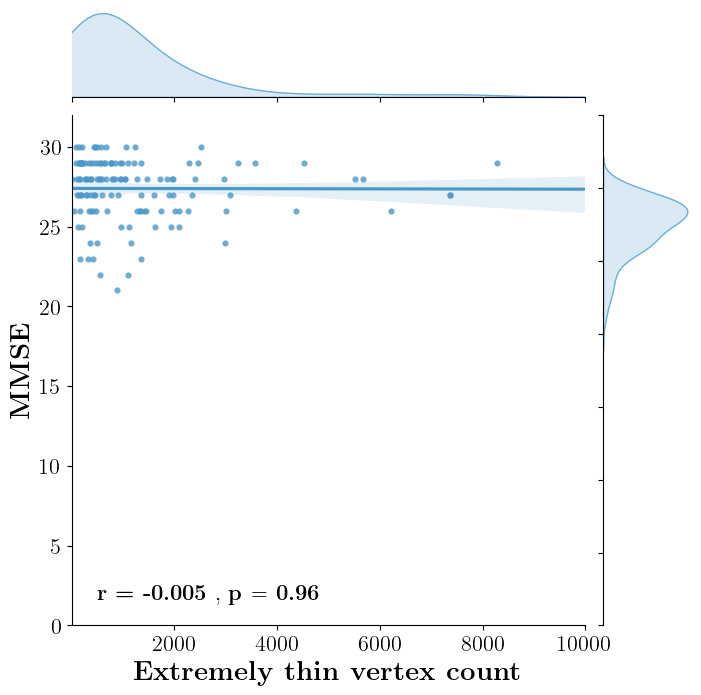

In [274]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()
# sample_df = sample_df[sample_df['split'] != 'Train']
x="extreme_thinning"
y="mmse"
xlims=[1,10000]
ylims=[0,32]

sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "CI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
ad_df = sample_df[sample_df['diagnosis'].isin(['AD',])]
ci_df = sample_df[sample_df['diagnosis'].isin(['CIND',])]

# Calculate correlation
# rho, pval = spearmanr(sample_df["extreme_thinning"], sample_df["mmse"])
rho, pval = pearsonr(healthy_df["extreme_thinning"], healthy_df["mmse"])
print(rho, pval)

fig = plt.figure(figsize=(8, 8))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[1:, :-1])

sns.regplot(data=healthy_df, x=x, y=y, ax=ax, color=plt.cm.Blues(0.6), scatter_kws={'linewidths': 0, 's': 20,})
# sns.kdeplot(data=sample_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Blues", plt.cm.Blues(np.linspace(0.05, 1, 256))), ax=ax, fill=True, levels=16, thresh=0.05)
# sns.kdeplot(data=ad_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Reds", plt.cm.Reds(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=ci_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Oranges", plt.cm.Oranges(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=healthy_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Greens", plt.cm.Greens(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{Extremely thin vertex count}", fontsize=20)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Add bold text with the correlation coefficient
# plt.figtext(0.15, 0.15, rf'\textbf{{Spearman rho = {rho:.2f}}}', 
#             fontsize=16, color='black', ha='left')
message = rf'\textbf{{r = {rho:.3f}}}'
if pval < 0.0001:
    message = rf'{message} , \textbf{{p $<$ 0.0001}}'
else:
    message = rf'{message} , \textbf{{p $=$ {pval:.2f}}}'
ax.text(0.05, 0.05, message, 
        fontsize=16, color='black', ha='left', transform=ax.transAxes)


ax = ax_top = fig.add_subplot(gs[0, :-1],)

sns.kdeplot(data=healthy_df, x=x, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, x=x, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.5), plt.cm.Oranges(0.5), plt.cm.Reds(0.5)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_xlabel('')
ax.set_xlim(xlims)
ax.set_xticks(ax_main.get_xticks())

ax = ax_right = fig.add_subplot(gs[1:, -1])

sns.kdeplot(data=healthy_df, y=y, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, y=y, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.75), plt.cm.Oranges(0.75), plt.cm.Reds(0.75)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.set_ylim(ylims)
ax.set_yticks(ax_main.get_yticks())

pass


In [2373]:
# simple parametric FDR
corr, corr_p_value = stats.pearsonr(cognition_score[hc_mask,np.newaxis], high_resolution_normative_thickness_zscore_MACC[hc_mask,:])
rejected, corrected_corr_p_value, _, _ = multipletests(corr_p_value, alpha=0.05, method='fdr_bh')


No protocol specified

No protocol specified



CPU times: user 1min 35s, sys: 2.76 s, total: 1min 38s
Wall time: 1min 39s


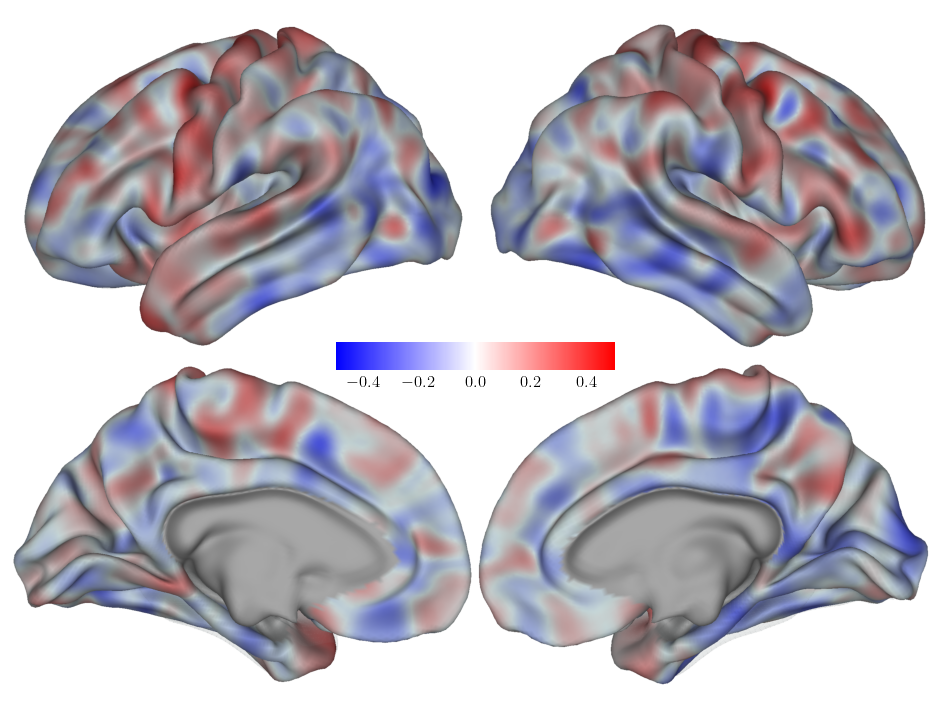

In [2374]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = corr.copy()
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[(0.05<sample_nonparametric_p_value) & (sample_nonparametric_p_value<0.2)] = 1
# lims = np.percentile(signal,[2,98])
lims = [-0.5, 0.5]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=plt.cm.bwr,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    cover=(~rejected).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)


In [2379]:
# Function for nonparametric correction
def perform_nonparametric_correlation_correction(x, y, n_permutations=1000, alpha=0.05):
    real_effect, parametric_p = stats.pearsonr(x, y)

    # FWER correction via permutation
    permuted_effect_maxs = []
    for permutation in tqdm(range(n_permutations)):
        if permutation == 0:
            permuted_effect_maxs.append(np.max(np.abs(real_effect)))
        else:
            np.random.seed(permutation)
            permuted_x = np.random.permutation(x)
            # np.random.shuffle(shuffled_groups)
            permuted_effect, _ = stats.pearsonr(permuted_x, y)
            permuted_effect_maxs.append(np.max(np.abs(permuted_effect)))

    # now compute nonparametric p_value
    permuted_effect_maxs = np.array(permuted_effect_maxs)
    nonparametric_corrected_p_value = 1 - (stats.percentileofscore(permuted_effect_maxs, np.abs(real_effect), kind='strict') / 100)

    return real_effect, nonparametric_corrected_p_value

In [2380]:
# simple parametric FDR
corr, corr_p_value = perform_nonparametric_correlation_correction(
    cognition_score[hc_mask,np.newaxis],
    high_resolution_normative_thickness_zscore_MACC[hc_mask,:]
)
rejected = corr_p_value < 0.05
# rejected, corrected_corr_p_value, _, _ = multipletests(corr_p_value, alpha=0.05, method='fdr_bh')


  0%|          | 0/1000 [00:00<?, ?it/s]

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 1min 37s, sys: 3.53 s, total: 1min 40s
Wall time: 1min 41s


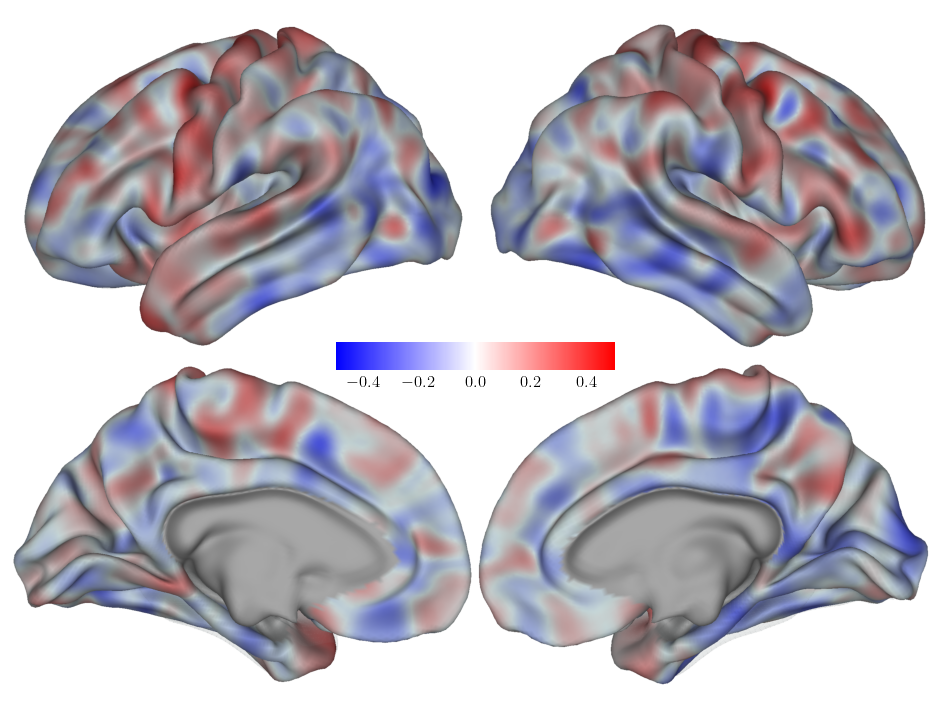

In [2381]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = corr.copy()
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[(0.05<sample_nonparametric_p_value) & (sample_nonparametric_p_value<0.2)] = 1
# lims = np.percentile(signal,[2,98])
lims = [-0.5, 0.5]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=plt.cm.bwr,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    cover=(~rejected).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)


In [2376]:
%%time

corrs, corr_p_values = [], []
for i in tqdm(range(high_resolution_normative_thickness_zscore_MACC.shape[1])):
    rng = np.random.default_rng(12345)
    method = stats.PermutationMethod(n_resamples=1000, random_state=rng)
    corr, corr_p_value = stats.pearsonr(cognition_score[hc_mask], high_resolution_normative_thickness_zscore_MACC[hc_mask,i], method=method)
    corrs.append(corr)
    corr_p_values.append(corr_p_value)
corrs, corr_p_values = np.array(corrs), np.array(corr_p_values)


  0%|          | 0/59412 [00:00<?, ?it/s]

CPU times: user 10min 54s, sys: 12.6 s, total: 11min 7s
Wall time: 11min 5s


In [2377]:
rejected, corrected_corr_p_values, _, _ = multipletests(corr_p_values, alpha=0.05, method='fdr_bh')


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 1min 36s, sys: 3.24 s, total: 1min 39s
Wall time: 1min 40s


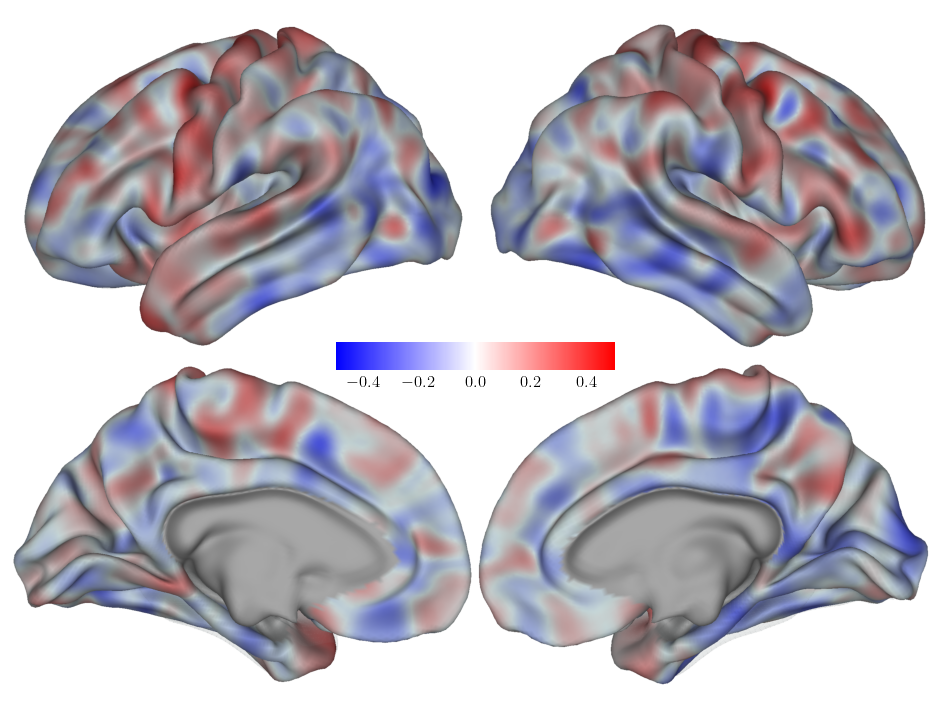

In [2378]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = corrs.copy()
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[(0.05<sample_nonparametric_p_value) & (sample_nonparametric_p_value<0.2)] = 1
# lims = np.percentile(signal,[2,98])
lims = [-0.5, 0.5]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=plt.cm.bwr,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    cover=(~rejected).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)


### ..

--

In [282]:
# simple parametric FDR
corr, corr_p_value = stats.pearsonr(cognition_score[:,np.newaxis], high_resolution_normative_thickness_zscore_MACC[study_mask, :])
rejected, corrected_corr_p_value, _, _ = multipletests(corr_p_value, alpha=0.05, method='fdr_bh')


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 1min 35s, sys: 2.34 s, total: 1min 37s
Wall time: 1min 38s


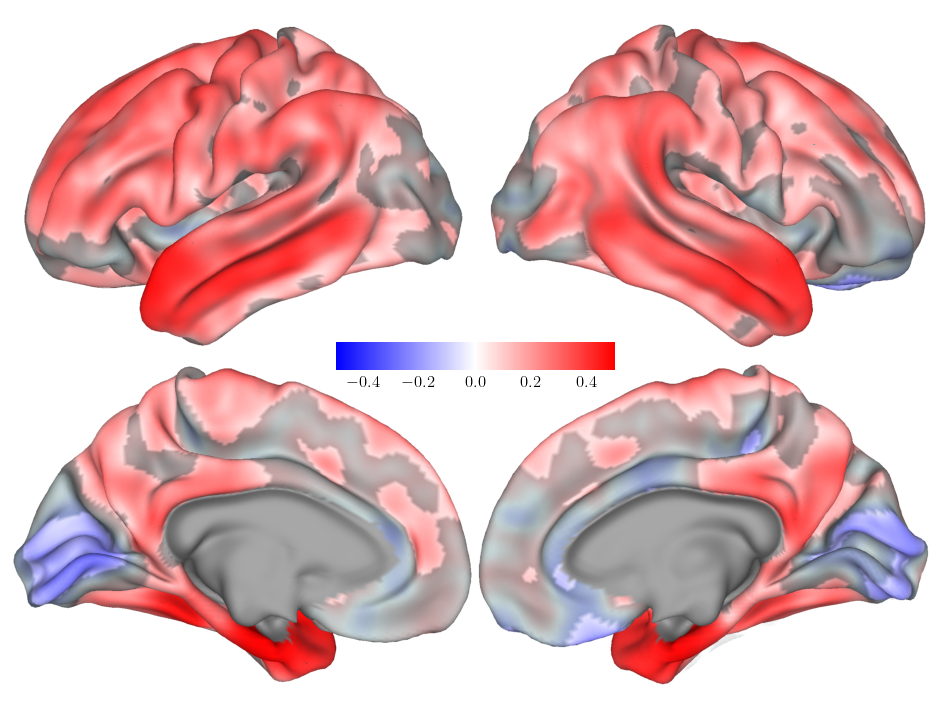

In [2367]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = corr.copy()
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[(0.05<sample_nonparametric_p_value) & (sample_nonparametric_p_value<0.2)] = 1
# lims = np.percentile(signal,[2,98])
lims = [-0.5, 0.5]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=plt.cm.bwr,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    cover=(~rejected).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)


## AD specific associations

---


Repeat this for only AD to see AD specific association between thinning and cognitive impairments.

This is mainly conducted because earlier maps seem to be widely influenced by HC-AD differences.

In [276]:
# Now let's repeat the evaluations in an AD cohort:
# Is the thickness deviation at certain vertices descriptive of cognitive decline?
study_ad_mask = demography_extended_df_MACC['diagnosis'].isin(['AD'])[study_mask]

ad_cognition_score_norm = (cognition_score[study_ad_mask] - cognition_score[study_ad_mask].mean()) / cognition_score[study_ad_mask].std()

ad_high_resolution_normative_thickness_zscore_MACC_norm = (
    high_resolution_normative_thickness_zscore_MACC[study_mask][study_ad_mask,:] -
    high_resolution_normative_thickness_zscore_MACC[study_mask][study_ad_mask,:].mean(0)[None, :]
) / high_resolution_normative_thickness_zscore_MACC[study_mask][study_ad_mask,:].std(0)[None, :]

ad_high_resolution_cognition_thinning_association = (ad_high_resolution_normative_thickness_zscore_MACC_norm.T.dot(ad_cognition_score_norm)/ad_cognition_score_norm.shape[0])

ad_high_resolution_cognition_thinning_association.shape


(59412,)

Statistical testing: FDR over permutations

In [278]:
# simple parametric FDR
corr, corr_p_value = stats.pearsonr(cognition_score[study_ad_mask,np.newaxis], high_resolution_normative_thickness_zscore_MACC[study_mask][study_ad_mask,:])
rejected, corrected_corr_p_value, _, _ = multipletests(corr_p_value, alpha=0.05, method='fdr_bh')


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 30.4 s, sys: 1.1 s, total: 31.5 s
Wall time: 32.1 s


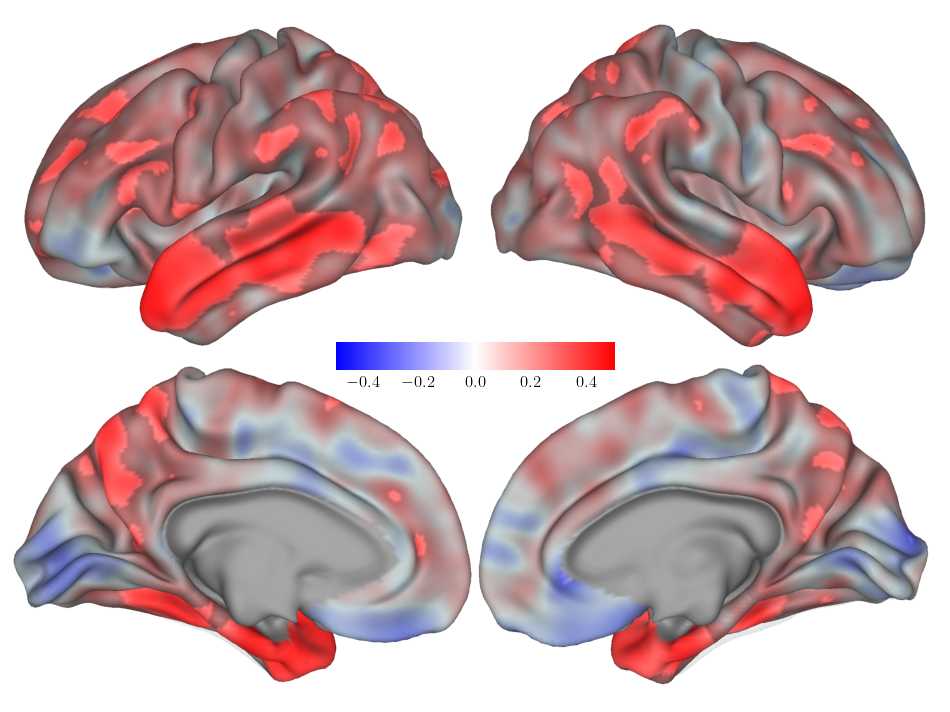

In [279]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = corr.copy()
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[(0.05<sample_nonparametric_p_value) & (sample_nonparametric_p_value<0.2)] = 1
# lims = np.percentile(signal,[2,98])
lims = [-0.5, 0.5]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=plt.cm.bwr,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    cover=(~rejected).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)


## Group differences

---

HC vs. AD

In [74]:
# Function to compute Cohen d for two sample t-test
def cohen_d_from_two_sample_t_test(samples, groups):
    # mean of each group
    mean_1 = samples[groups==1].mean(0)
    mean_2 = samples[groups==2].mean(0)
    
    # std of each group
    std_1 = samples[groups==1].std(0)
    std_2 = samples[groups==2].std(0)

    # sample sizes
    sample_size_1 = np.sum(groups==1)
    sample_size_2 = np.sum(groups==2)
    
    # pooled std
    pooled_std = np.sqrt(
        (
           ((sample_size_1 - 1) * np.power(std_1, 2)) +
           ((sample_size_2 - 1) * np.power(std_2, 2))
        ) /
        (sample_size_1 + sample_size_2 - 2)
    )
    
    # Cohen's d
    cohen_d = (mean_1 - mean_2) / pooled_std

    return cohen_d

# Function for nonparametric correction
def perform_nonparametric_correction(sample_1, sample_2, n_permutations=1000, alpha=0.05):
    samples = np.concatenate([sample_1, sample_2])
    groups = np.concatenate([np.ones(sample_1.shape[0]), 2*np.ones(sample_2.shape[0])])

    real_effect = cohen_d_from_two_sample_t_test(samples, groups)

    # FWER correction via permutation
    maximum_permutated_effect = []
    for permutation in tqdm(range(n_permutations)):
        if permutation == 0:
            maximum_permutated_effect.append(np.max(np.abs(real_effect)))
        else:
            shuffled_groups = groups.copy()
            np.random.seed(permutation)
            np.random.shuffle(shuffled_groups)
            permuted_effect = cohen_d_from_two_sample_t_test(samples, shuffled_groups)
            maximum_permutated_effect.append(np.max(np.abs(permuted_effect)))

    # now compute significance threshold
    maximum_permutated_effect = np.array(maximum_permutated_effect)
    nonparametric_significance_threshold = np.percentile(maximum_permutated_effect, 100 * (1 - alpha))
    nonparametric_significance_mask = (np.abs(real_effect) >= nonparametric_significance_threshold)

    # Use the line below if you want to get the nonparametric value
    sample_nonparametric_p_value = 1 - (stats.percentileofscore(maximum_permutated_effect, np.abs(real_effect), kind='strict') / 100)

    return real_effect, nonparametric_significance_mask, sample_nonparametric_p_value, nonparametric_significance_threshold


In [283]:
# group-level comparison of AD and helathy:
ad_mask = demography_extended_df_MACC['diagnosis'].isin(['AD',])
hc_mask = demography_extended_df_MACC['diagnosis'].isin(['NCI'])

# manual implementation of two-sample t test
sample_1 = high_resolution_normative_thickness_zscore_MACC[hc_mask]
sample_2 = high_resolution_normative_thickness_zscore_MACC[ad_mask]

sample_1.shape

# mean of each group
mean_1 = sample_1.mean(0)
mean_2 = sample_2.mean(0)

# std of each group
std_1 = sample_1.std(0)
std_2 = sample_2.std(0)

# pooled std
sample_size_1 = sample_1.shape[0]
sample_size_2 = sample_2.shape[0]
pooled_std = np.sqrt(
    (
       ((sample_size_1 - 1) * np.power(std_1, 2)) +
       ((sample_size_2 - 1) * np.power(std_2, 2))
    ) /
    (sample_size_1 + sample_size_2 - 2)
)

# t statistic
t_val = (
    (mean_1 - mean_2) /
    (
        pooled_std *
        ((1 / sample_size_1) + (1 / sample_size_2))
    )
)

# Cohen's d
cohen_d = (mean_1 - mean_2) / pooled_std

# Degrees of freedom
df = sample_size_1 + sample_size_2 - 2

# Two-tailed p-value from t-statistic
p_val = 2 * (1 - stats.t.cdf(np.abs(t_val), df=df))

from statsmodels.stats.multitest import multipletests

# Perform FDR correction using the Benjamini-Hochberg procedure
# 'fdr_bh' is for the Benjamini-Hochberg procedure
rejected, corrected_pvals, _, _ = multipletests(p_val, alpha=0.05, method='fdr_bh')



In [ ]:
%%time
t_vals, p_vals = stats.ttest_ind(sample_1, sample_2, permutations=1000)
rejected, corrected_pvals, _, _ = multipletests(p_vals, alpha=0.05, method='fdr_bh')


(59412,)

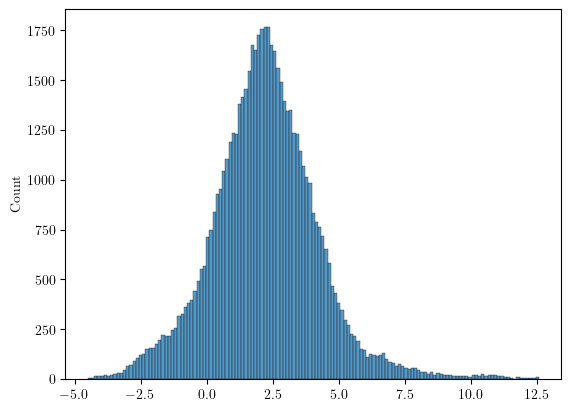

In [294]:
sns.histplot(t_vals)
t_vals.shape

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 31.4 s, sys: 290 ms, total: 31.7 s
Wall time: 36.1 s


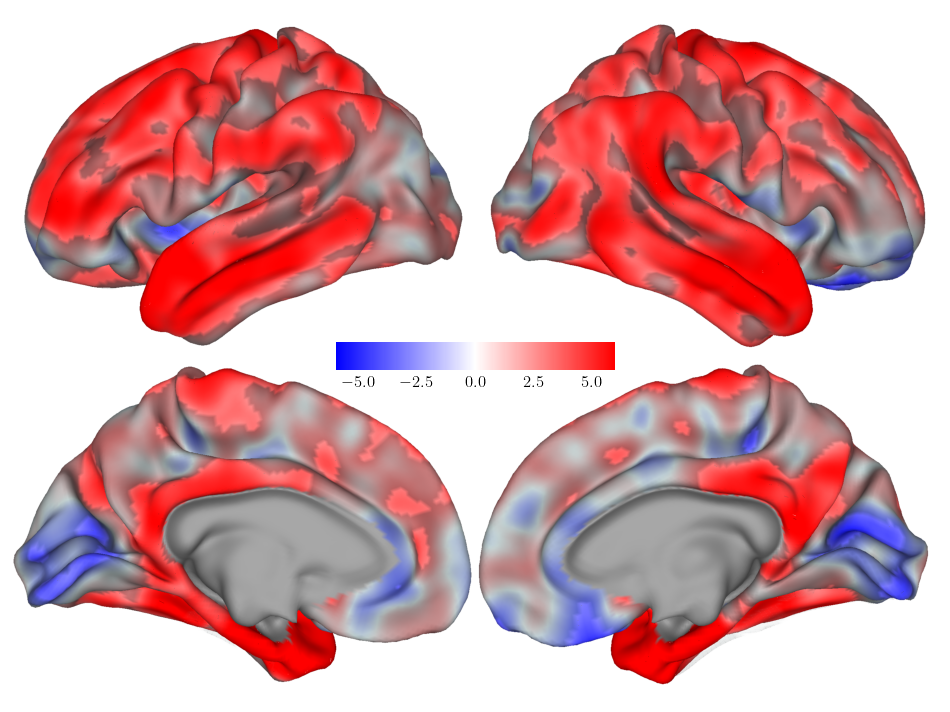

In [295]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = t_vals.copy()
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[~nonparametric_significance_mask] = signal[~nonparametric_significance_mask]/2
# signal[(0.05<sample_nonparametric_p_value) & (sample_nonparametric_p_value<0.2)] = 1
# lims = np.percentile(signal,[2,98])
lims = [-6, 6]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=plt.cm.bwr,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    cover=(~rejected).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)


## Hypothetical distance matrix

---
Hypothetical scenarios

<Axes: >

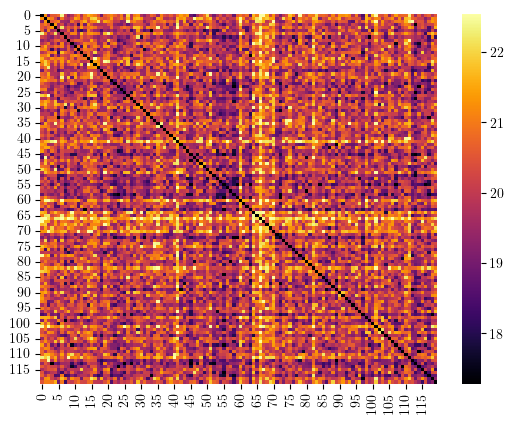

In [2713]:
# hypothetical scenarios
# deviation maps are not indicative of anything / completely random
np.random.seed(123456)

random_data = np.random.normal(size=(120, 200))

random_distance = cdist(random_data, random_data, metric='euclidean',)

sns.heatmap(random_distance, cmap=plt.cm.inferno, vmin=np.percentile(random_distance.ravel(), 1), vmax=np.percentile(random_distance.ravel(), 99))



[]

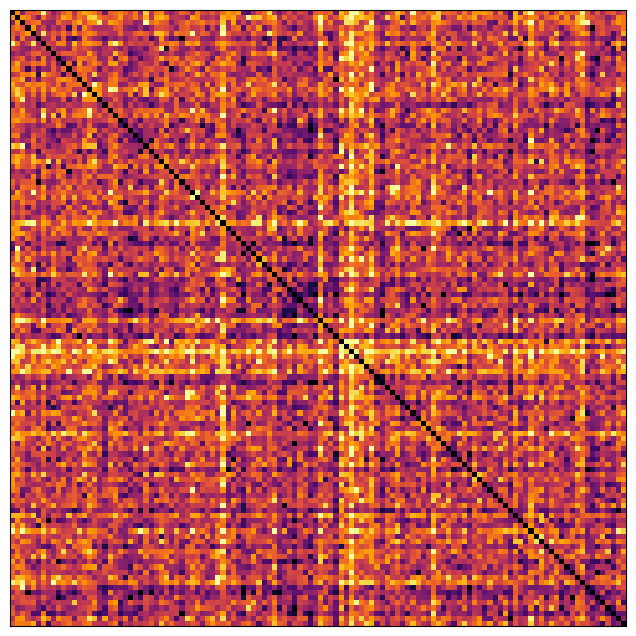

In [2721]:
# hypothetical scenarios
# deviation maps are not indicative of anything / completely random
np.random.seed(123456)

random_data = np.random.normal(size=(120, 200))

random_distance = cdist(random_data, random_data, metric='euclidean',)

fig, ax = plt.subplots(figsize=(8, 8))

ax.imshow(random_distance, cmap=plt.cm.inferno, vmin=np.percentile(random_distance.ravel(), 1), vmax=np.percentile(random_distance.ravel(), 99),)
ax.set_xticks([])
ax.set_yticks([])



<Axes: >

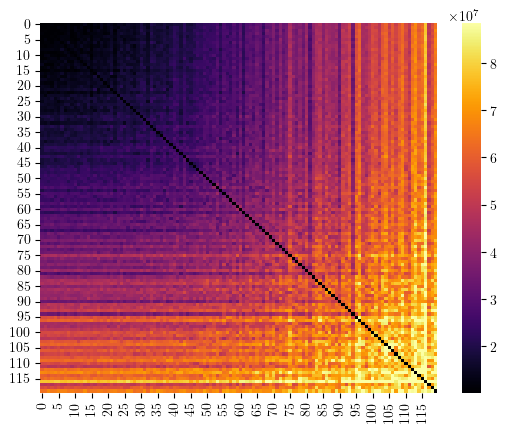

In [2706]:
# hypothetical scenarios
# deviation maps  show heterogenous extremes due to cognitive decline
np.random.seed(123456)

random_data = np.random.normal(size=(120, 40))
random_data *= (np.arange(101,221)[:,np.newaxis])**3

random_distance = cdist(random_data, random_data, metric='euclidean',)

sns.heatmap(random_distance, cmap=plt.cm.inferno, vmin=np.percentile(random_distance.ravel(), 1), vmax=np.percentile(random_distance.ravel(), 99))



[]

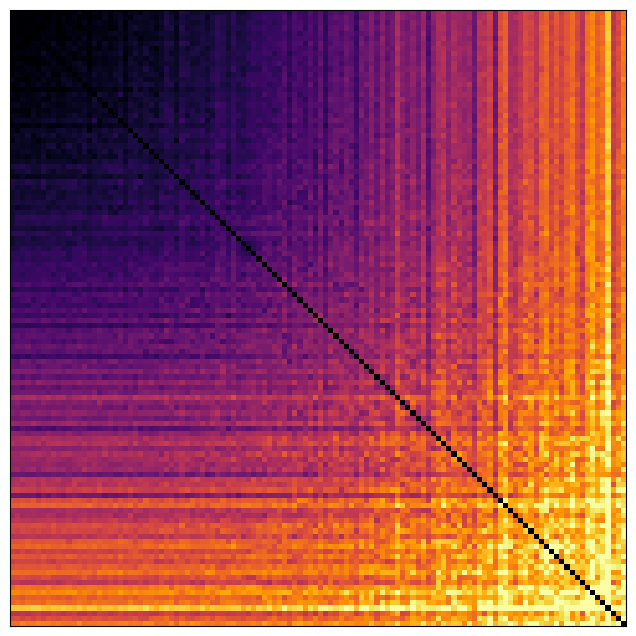

In [2722]:
# hypothetical scenarios
# deviation maps  show heterogenous extremes due to cognitive decline
np.random.seed(123456)

random_data = np.random.normal(size=(120, 40))
random_data *= (np.arange(101,221)[:,np.newaxis])**3

random_distance = cdist(random_data, random_data, metric='euclidean',)

fig, ax = plt.subplots(figsize=(8, 8))

ax.imshow(random_distance, cmap=plt.cm.inferno, vmin=np.percentile(random_distance.ravel(), 1), vmax=np.percentile(random_distance.ravel(), 99),)
ax.set_xticks([])
ax.set_yticks([])



<Axes: >

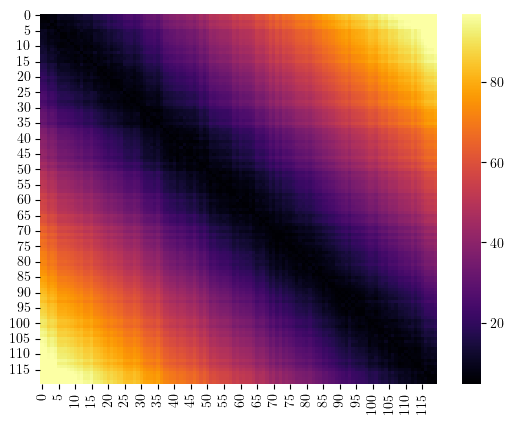

In [2708]:
# hypothetical scenarios
# deviation maps show progression differences due to cognitive decline
np.random.seed(123456)

random_data = np.random.normal(size=(120, 20))
random_data += np.arange(101,221)[:,np.newaxis]/5

random_distance = cdist(random_data, random_data, metric='euclidean',)

sns.heatmap(random_distance, cmap=plt.cm.inferno, vmin=np.percentile(random_distance.ravel(), 1), vmax=np.percentile(random_distance.ravel(), 99))



[]

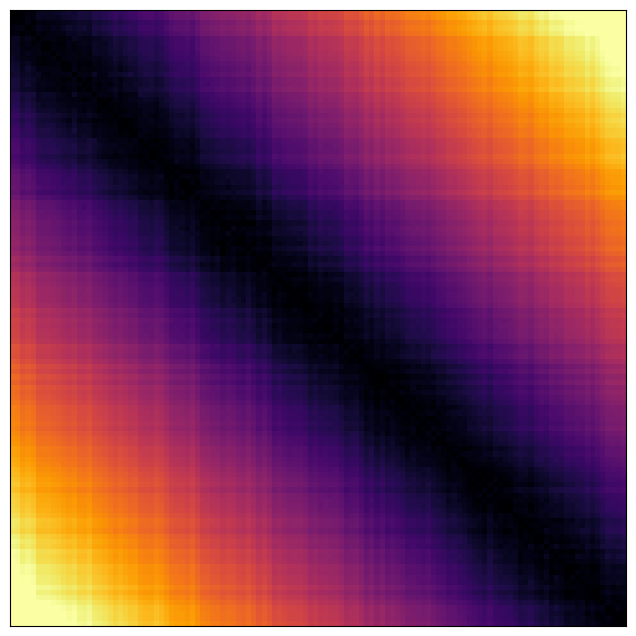

In [2723]:
# hypothetical scenarios
# deviation maps  show heterogenous extremes due to cognitive decline
np.random.seed(123456)

random_data = np.random.normal(size=(120, 20))
random_data += np.arange(101,221)[:,np.newaxis]/5

random_distance = cdist(random_data, random_data, metric='euclidean',)

fig, ax = plt.subplots(figsize=(8, 8))

ax.imshow(random_distance, cmap=plt.cm.inferno, vmin=np.percentile(random_distance.ravel(), 1), vmax=np.percentile(random_distance.ravel(), 99),)
ax.set_xticks([])
ax.set_yticks([])



<Axes: >

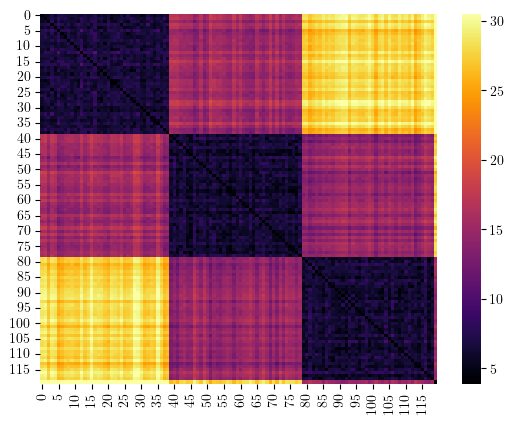

In [2715]:
# hypothetical scenarios
# deviation maps show progressional group differences
np.random.seed(123456)

random_data = np.random.normal(size=(120, 20))
random_data += (np.arange(1,121)[:,np.newaxis] // 40) * 3

random_distance = cdist(random_data, random_data, metric='euclidean',)

sns.heatmap(random_distance, cmap=plt.cm.inferno, vmin=np.percentile(random_distance.ravel(), 1), vmax=np.percentile(random_distance.ravel(), 99))



[]

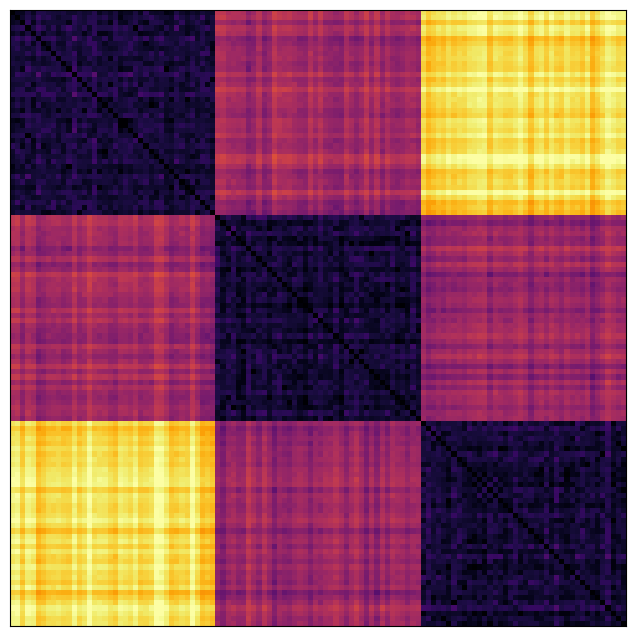

In [2725]:
# hypothetical scenarios
# deviation maps  show heterogenous extremes due to cognitive decline
np.random.seed(123456)

random_data = np.random.normal(size=(120, 20))
random_data += (np.arange(0,120)[:,np.newaxis] // 40) * 3

random_distance = cdist(random_data, random_data, metric='euclidean',)

fig, ax = plt.subplots(figsize=(8, 8))

ax.imshow(random_distance, cmap=plt.cm.inferno, vmin=np.percentile(random_distance.ravel(), 1), vmax=np.percentile(random_distance.ravel(), 99),)
ax.set_xticks([])
ax.set_yticks([])



## Capturing the heterogeous landscape of atrophy (HC, MCI, AD)

---

### Distance matrix

In [41]:
%%time
# correlation is not an appropriate similarity metric
# let's look at euclidean distance next

from scipy.spatial.distance import cdist

euclidean_distance = cdist(high_resolution_normative_thickness_zscore_MACC[study_mask], high_resolution_normative_thickness_zscore_MACC[study_mask], metric='euclidean',)
euclidean_distance.shape


CPU times: user 16.5 s, sys: 189 ms, total: 16.7 s
Wall time: 16.7 s


(542, 542)

In [306]:
euclidean_distance.shape, euclidean_distance.min(), euclidean_distance.max()

((542, 542), 0.0, 887.5495661968392)

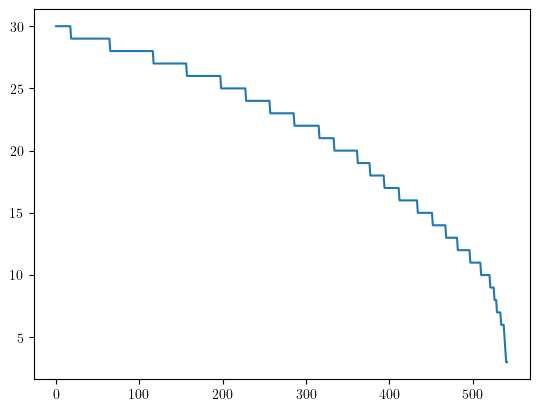

In [42]:
order = np.argsort(-cognition_score)
plt.plot(cognition_score[order])

In [43]:
study_ad_mask = (demography_extended_df_MACC['diagnosis'].isin(['AD'])[study_mask]).copy().reset_index(drop=True)
study_hc_mask = (demography_extended_df_MACC['diagnosis'].isin(['NCI'])[study_mask]).copy().reset_index(drop=True)
study_mc_mask = (demography_extended_df_MACC['diagnosis'].isin(['CIND',])[study_mask]).copy().reset_index(drop=True)


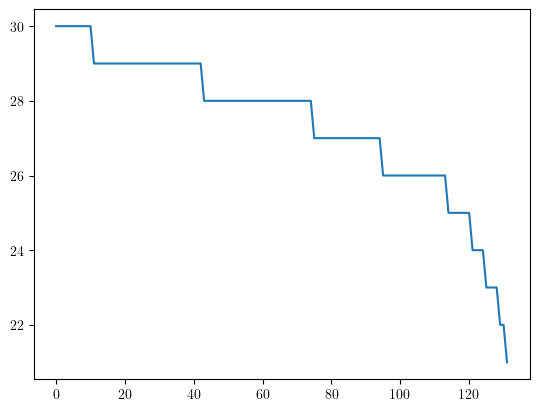

In [311]:
plt.plot(cognition_score[order][study_hc_mask[order]])


In [44]:
grouped_order = np.concatenate([
    study_hc_mask[order].index[study_hc_mask[order]],
    study_mc_mask[order].index[study_mc_mask[order]],
    study_ad_mask[order].index[study_ad_mask[order]],
])
# grouped_order = np.concatenate([np.where(hc_mask[order])[0], np.where(mc_mask[order])[0], np.where(ad_mask[order])[0]])
# grouped_order = np.concatenate([order[hc_mask], order[mc_mask], order[ad_mask]])


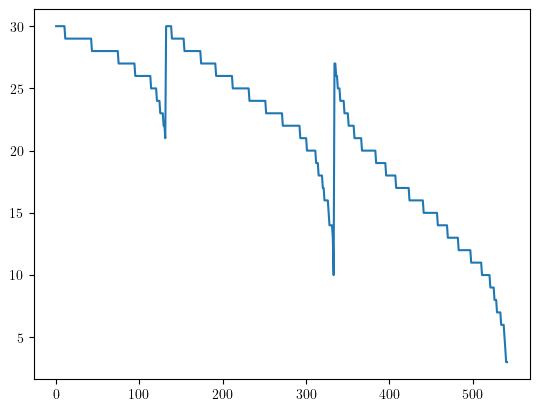

In [313]:
plt.plot(cognition_score[grouped_order])


CPU times: user 71.9 ms, sys: 0 ns, total: 71.9 ms
Wall time: 70.8 ms


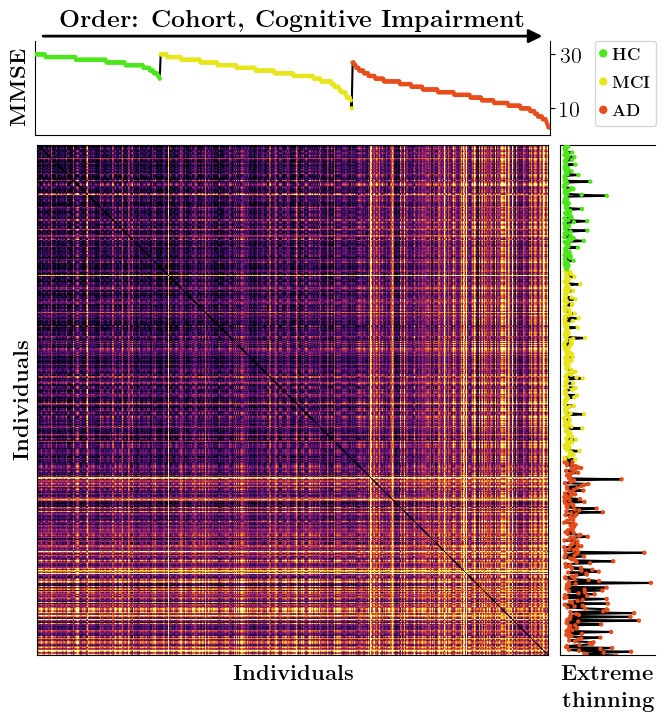

In [45]:
%%time
from matplotlib.patches import Patch
import matplotlib.patches as mpatches
from matplotlib.legend_handler import HandlerPatch
from scipy.stats import gaussian_kde

# Custom handler function to use the radius of the original Circle patch
def make_legend_circle(legend, orig_handle, xdescent, ydescent, width, height, fontsize):
    radius = orig_handle.radius  # Use the radius of the original patch
    center = (xdescent + width/2, ydescent + height/2)  # Center the circle
    return mpatches.Circle(center, radius=radius)

def get_kde_counts(data, x, bw):
    # Number of observations
    n = data.shape[0]
    # Compute KDE using gaussian_kde
    kde = gaussian_kde(data, bw_method=bw)
    # KDE is typically a density, we multiply by n to get the estimated number of observations
    kde_observations = kde(x) * n
    return kde_observations

plot_order = grouped_order.copy()
mpx = 8/6
fig = plt.figure(figsize=(6*mpx, 7*mpx))
gs = fig.add_gridspec(7, 6, wspace=0.1, hspace=0.1)

ax = ax_main = fig.add_subplot(gs[1:-1, :-1])
vmin, vmax = np.percentile(euclidean_distance.ravel(), (5, 95))
ax.imshow(euclidean_distance[plot_order,:][:,plot_order], cmap=plt.cm.inferno, vmin=vmin, vmax=vmax,)
ax.set_xticks([])
ax.set_yticks([])
ax.set_ylabel(r"\textbf{Individuals}", fontsize=16)
ax.set_xlabel(r"\textbf{Individuals}", fontsize=16, labelpad=6)

ax = ax_top = fig.add_subplot(gs[0, :-1],)

ax.plot(cognition_score[plot_order], color='black', zorder=20)
ax.set_xticks([])
ax.set_yticks([10,30])
ax.spines['top'].set_visible(False)
# ax.spines['right'].set_visible(False)
ax.yaxis.set_ticks_position('right')
ax.set_xlim(0,cognition_score.shape[0])
ax.set_ylim(0,35)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=16)
ax.tick_params(axis='both', which='major', labelsize=16)

groups_im = cognition_score * np.nan
groups_im[study_hc_mask] = 0
groups_im[study_mc_mask] = 1
groups_im[study_ad_mask] = 2
groups_cmap = [[0.3, 0.9, 0.1], [0.9, 0.9, 0.1], [0.9, 0.3, 0.1],]

ax.scatter(np.arange(cognition_score.shape[0]), cognition_score[plot_order], color=[groups_cmap[int(x)] for x in groups_im[plot_order]], zorder=30, lw=0, s=10)

ax.annotate('', xy=(0.01, 1.05), xytext=(0.99, 1.05), arrowprops=dict(arrowstyle='<|-', color='black', mutation_scale=20, linewidth=2), xycoords='axes fraction', textcoords='axes fraction')
ax.text(0.5, 1.15, rf'\textbf{{Order: Cohort, Cognitive Impairment}}', fontsize=18, color='black', ha='center', transform=ax.transAxes)


ax = ax_right = fig.add_subplot(gs[1:-1, -1])
ax.plot(extreme_thinning[study_mask][plot_order][::-1], np.arange(euclidean_distance.shape[0]), color='black', zorder=20)
ax.set_xticks([])
ax.set_yticks([])
ax.spines['right'].set_visible(False)
ax.set_ylim(0,extreme_thinning[study_mask].shape[0])
ax.set_xlabel(r"$\begin{tabular}{c}\textbf{Extreme} \\ \textbf{thinning}\end{tabular}$", fontsize=16, labelpad=6)

ax.scatter(extreme_thinning[study_mask][plot_order][::-1], np.arange(euclidean_distance.shape[0]), color=[groups_cmap[int(x)] for x in groups_im[plot_order][::-1]], zorder=30, lw=0, s=10)

legend_elements = [
    mpatches.Circle((0, 0), radius=3., facecolor=groups_cmap[0], label=r'\textbf{HC}'),
    mpatches.Circle((0, 0), radius=3., facecolor=groups_cmap[1], label=r'\textbf{MCI}'),
    mpatches.Circle((0, 0), radius=3., facecolor=groups_cmap[2], label=r'\textbf{AD}'),
]
ax.legend(
    handles=legend_elements, bbox_to_anchor=(0.35, 0.32, 0.75, 0.9), handlelength=0.2, fontsize=12, handletextpad=0.4, ncol=1, columnspacing=0.5, labelspacing=0.8,
    handler_map={mpatches.Circle: HandlerPatch(patch_func=make_legend_circle)}
)


pass


### 2D MDS Landscape

#### Landscape

In [34]:
%%time

from sklearn.manifold import MDS

def distance_to_affinity(distance_matrix):
    # Convert distance matrix to affinity
    affinity_matrix = 1 / (1 + distance_matrix)
    return affinity_matrix

# MDS
atrophy_2D_landscape = atrophy_2D_landscape = MDS(n_components=2, random_state=12345).fit_transform(high_resolution_normative_thickness_zscore_MACC[study_mask])

atrophy_2D_landscape.shape



CPU times: user 4.85 s, sys: 844 ms, total: 5.69 s
Wall time: 10.4 s


(542, 2)

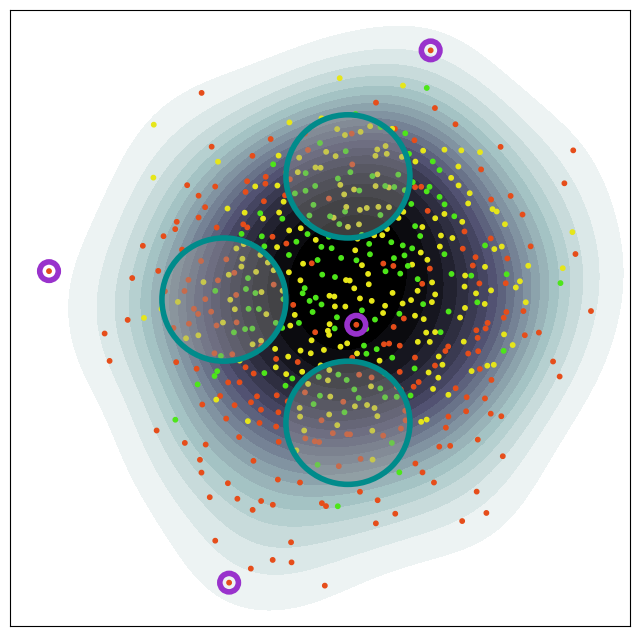

In [352]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from matplotlib.patches import Circle, Ellipse

fig, ax = plt.subplots(figsize=(8, 8))

group_idx = groups_im * np.nan
group_idx[study_hc_mask] = 0
group_idx[study_mc_mask] = 1
group_idx[study_ad_mask] = 2

ax.set_xticks([])
ax.set_yticks([])

tmp_mask = (demography_extended_df_MACC["group"] == "HC")[study_mask]
kdefit = gaussian_kde(atrophy_2D_landscape.T, bw_method=0.5)


X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]

Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T

ax.imshow(Z, cmap=ListedColormap(plt.cm.bone_r(np.linspace(0,1,20))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')

ax.scatter(
    x=atrophy_2D_landscape[:, 0],
    y=atrophy_2D_landscape[:, 1],
    color=[groups_cmap[int(x)] for x in groups_im], s=10,
)

# now let's draw a circle
def draw_ellipse(ax, rx, ry, center, **kwargs):
    ellipse = Ellipse(center, width=2*rx, height=2*ry, **kwargs)
    ax.add_patch(ellipse)

xscaler = (xmax - xmin) / 2
yscaler = (ymax - ymin) / 2
rb = 0.2
ex = 0.3
exw = 0.4
# draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([0. * xscaler, 0. * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([ex * xscaler, ex * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([ex * xscaler, -ex * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([-ex * xscaler, ex * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([-ex * xscaler, -ex * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([exw * xscaler, 0 * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([-exw * xscaler, 0 * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([0 * xscaler, exw * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([0 * xscaler, -exw * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)


# Selected subjects
# atrophy_2D_landscape[119]
# draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[119], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[81], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
# atrophy_2D_landscape[200]
# draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[200], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[139], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
# atrophy_2D_landscape[640]
# draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[640], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[510], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
# atrophy_2D_landscape[633]
# draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[633], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[503], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)

ax.invert_yaxis()


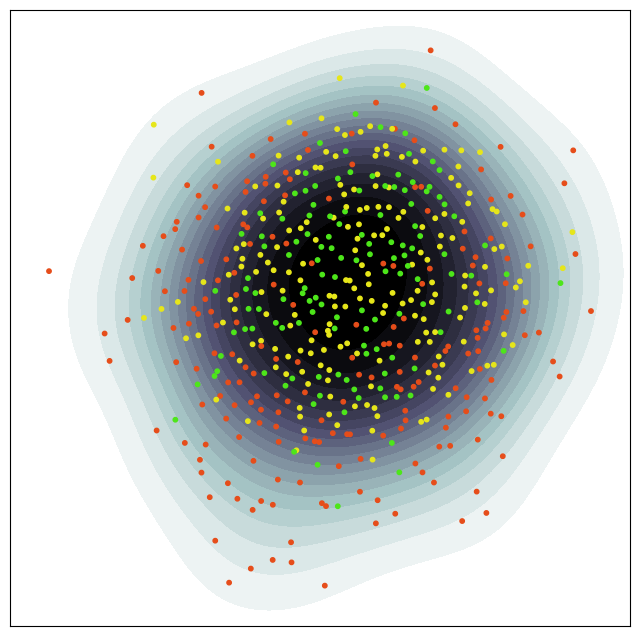

In [52]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from matplotlib.patches import Circle, Ellipse
from matplotlib.colors import ListedColormap

fig, ax = plt.subplots(figsize=(8, 8))

group_idx = groups_im * np.nan
group_idx[study_hc_mask] = 0
group_idx[study_mc_mask] = 1
group_idx[study_ad_mask] = 2

ax.set_xticks([])
ax.set_yticks([])

# tmp_mask = (demography_extended_df_MACC["group"] == "HC")[study_mask]
kdefit = gaussian_kde(atrophy_2D_landscape.T, bw_method=0.5)


X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]

Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T

ax.imshow(Z, cmap=ListedColormap(plt.cm.bone_r(np.linspace(0,1,20))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')

ax.scatter(
    x=atrophy_2D_landscape[:, 0],
    y=atrophy_2D_landscape[:, 1],
    color=[groups_cmap[int(x)] for x in groups_im], s=10,
)

# # now let's draw a circle
# def draw_ellipse(ax, rx, ry, center, **kwargs):
#     ellipse = Ellipse(center, width=2*rx, height=2*ry, **kwargs)
#     ax.add_patch(ellipse)

# xscaler = (xmax - xmin) / 2
# yscaler = (ymax - ymin) / 2
# rb = 0.2
# ex = 0.3
# exw = 0.4
# # draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([0. * xscaler, 0. * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# # draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([ex * xscaler, ex * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# # draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([ex * xscaler, -ex * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# # draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([-ex * xscaler, ex * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# # draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([-ex * xscaler, -ex * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# # draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([exw * xscaler, 0 * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([-exw * xscaler, 0 * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([0 * xscaler, exw * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)
# draw_ellipse(ax, rx=rb * xscaler, ry=rb * yscaler, center=np.array([0 * xscaler, -exw * yscaler]), edgecolor='darkcyan', facecolor=(0.6,0.6,0.6,0.4), linewidth=4,)


# # Selected subjects
# # atrophy_2D_landscape[119]
# # draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[119], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
# draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[81], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
# # atrophy_2D_landscape[200]
# # draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[200], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
# draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[139], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
# # atrophy_2D_landscape[640]
# # draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[640], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
# draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[510], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
# # atrophy_2D_landscape[633]
# # draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[633], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)
# draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[503], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)

ax.invert_yaxis()


#### Local average deviation maps

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



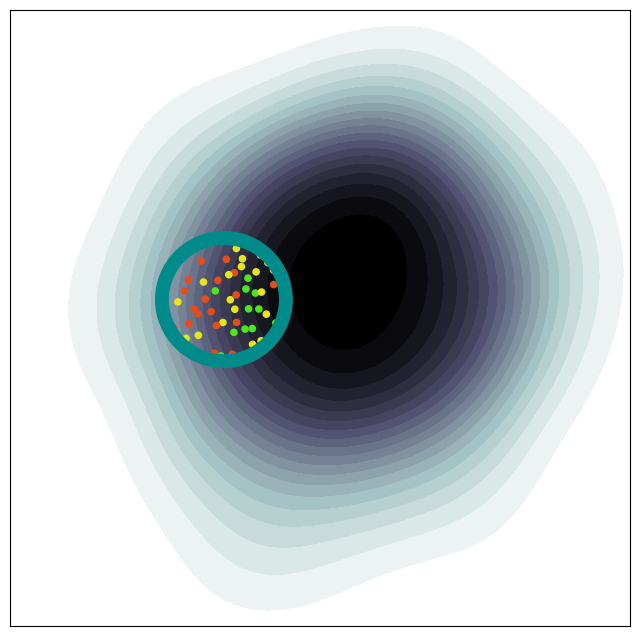

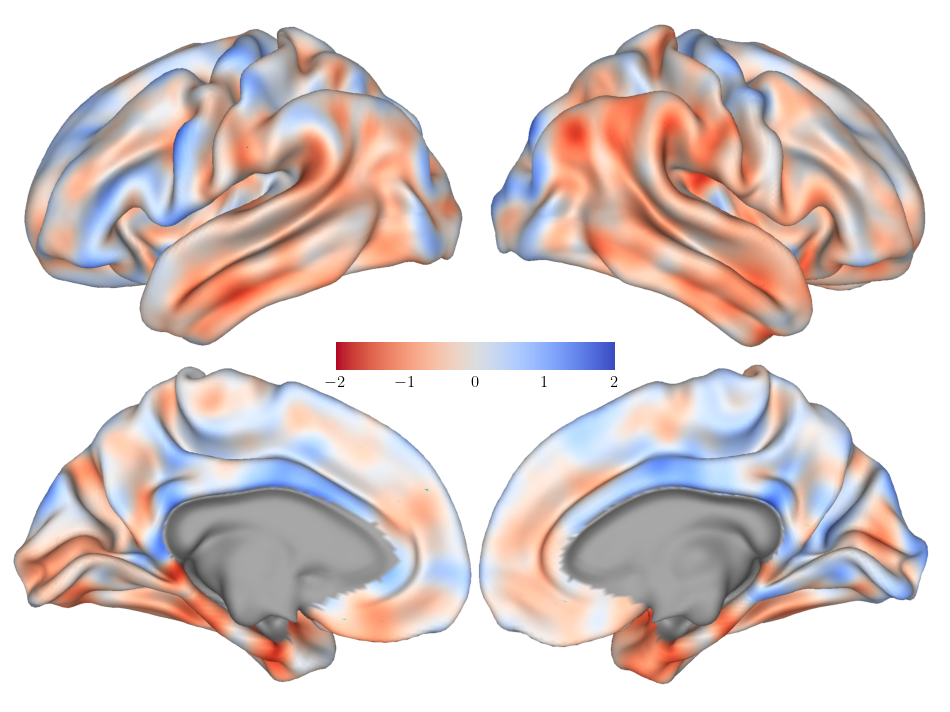

In [353]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from matplotlib.patches import Circle, Ellipse

fig, ax = plt.subplots(figsize=(8, 8))

group_idx = groups_im * np.nan
group_idx[study_hc_mask] = 0
group_idx[study_mc_mask] = 1
group_idx[study_ad_mask] = 2

ax.set_xticks([])
ax.set_yticks([])

tmp_mask = (demography_extended_df_MACC["group"] == "HC")[study_mask]
kdefit = gaussian_kde(atrophy_2D_landscape.T, bw_method=0.5)


X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]

Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T

ax.imshow(Z, cmap=ListedColormap(plt.cm.bone_r(np.linspace(0,1,20))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')

# now let's draw a circle
def draw_ellipse(ax, rx, ry, center, **kwargs):
    ellipse = Ellipse(center, width=2*rx, height=2*ry, **kwargs)
    ax.add_patch(ellipse)

xscaler = (xmax - xmin) / 2
yscaler = (ymax - ymin) / 2

cx, cy, r = -0.4, -0., 0.2

selection = (((atrophy_2D_landscape / [xscaler, yscaler]) - np.array([cx,cy]))**2).sum(1) < (r)**2

ax.scatter(
    x=atrophy_2D_landscape[selection, 0],
    y=atrophy_2D_landscape[selection, 1],
    color=np.array([groups_cmap[int(x)] for x in groups_im])[selection, :], s=20,
)
draw_ellipse(ax, rx=r * xscaler, ry=r * yscaler, center=np.array([cx * xscaler, cy * yscaler]), edgecolor='darkcyan', facecolor='none', linewidth=10, alpha=1.)

ax.invert_yaxis()

# Create a figure and an axis for cortical visualization
fig, ax = plt.subplots(figsize=(12, 9))

cmap = plt.get_cmap('coolwarm_r')
colors = cmap(np.linspace(0.0, 1., 400))
mask_color = np.array([0.3, 0.3, 0.3, 1])
mask_power = 0.3
thresh, lim = 1.96, 2
# colors[int((400 * (lim - thresh))/(2*lim)):] = ((1 - mask_power) * colors[int((400 * (lim - thresh))/(2*lim)):]) + (mask_power * mask_color)
altered_cmap = ListedColormap(colors)

signal = high_resolution_normative_thickness_zscore_MACC[study_mask][selection].mean(0)
# cover = signal > -2
lims = [-lim, lim]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=altered_cmap,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    # cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)
pass


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



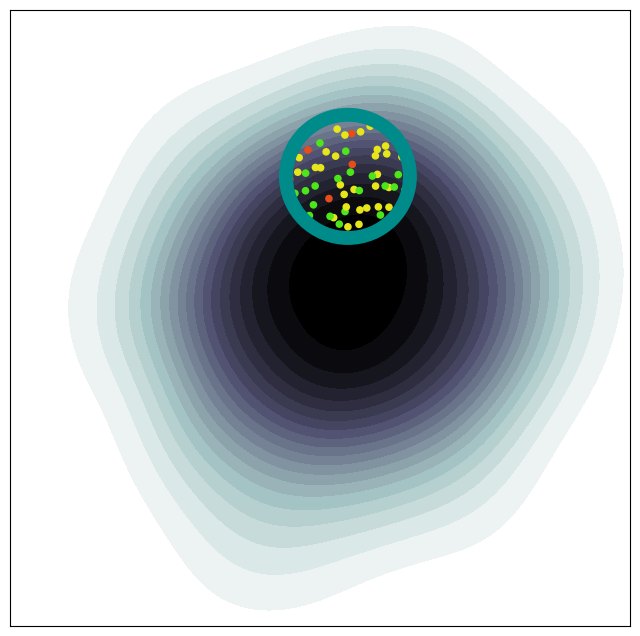

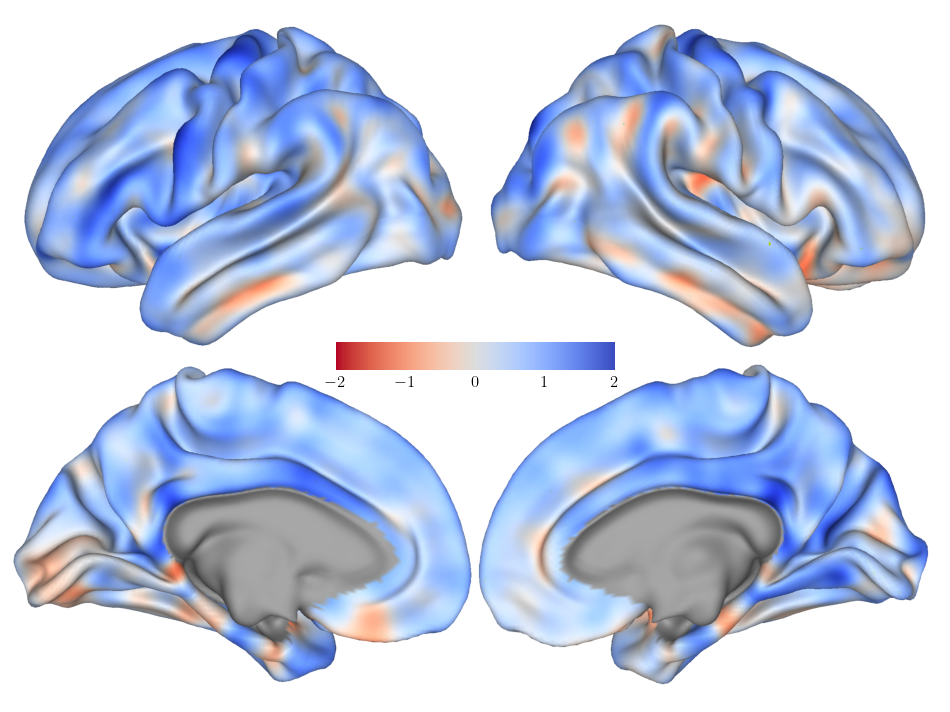

In [354]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from matplotlib.patches import Circle, Ellipse

fig, ax = plt.subplots(figsize=(8, 8))

group_idx = groups_im * np.nan
group_idx[study_hc_mask] = 0
group_idx[study_mc_mask] = 1
group_idx[study_ad_mask] = 2

ax.set_xticks([])
ax.set_yticks([])

tmp_mask = (demography_extended_df_MACC["group"] == "HC")[study_mask]
kdefit = gaussian_kde(atrophy_2D_landscape.T, bw_method=0.5)


X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]

Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T

ax.imshow(Z, cmap=ListedColormap(plt.cm.bone_r(np.linspace(0,1,20))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')

# now let's draw a circle
def draw_ellipse(ax, rx, ry, center, **kwargs):
    ellipse = Ellipse(center, width=2*rx, height=2*ry, **kwargs)
    ax.add_patch(ellipse)

xscaler = (xmax - xmin) / 2
yscaler = (ymax - ymin) / 2

cx, cy, r = -0.0, -0.4, 0.2

selection = (((atrophy_2D_landscape / [xscaler, yscaler]) - np.array([cx,cy]))**2).sum(1) < (r)**2

ax.scatter(
    x=atrophy_2D_landscape[selection, 0],
    y=atrophy_2D_landscape[selection, 1],
    color=np.array([groups_cmap[int(x)] for x in groups_im])[selection, :], s=20,
)
draw_ellipse(ax, rx=r * xscaler, ry=r * yscaler, center=np.array([cx * xscaler, cy * yscaler]), edgecolor='darkcyan', facecolor='none', linewidth=10, alpha=1.)

ax.invert_yaxis()

# Create a figure and an axis for cortical visualization
fig, ax = plt.subplots(figsize=(12, 9))

cmap = plt.get_cmap('coolwarm_r')
colors = cmap(np.linspace(0.0, 1., 400))
mask_color = np.array([0.3, 0.3, 0.3, 1])
mask_power = 0.3
thresh, lim = 1.96, 2
# colors[int((400 * (lim - thresh))/(2*lim)):] = ((1 - mask_power) * colors[int((400 * (lim - thresh))/(2*lim)):]) + (mask_power * mask_color)
altered_cmap = ListedColormap(colors)

signal = high_resolution_normative_thickness_zscore_MACC[study_mask][selection].mean(0)
# cover = signal > -2
lims = [-lim, lim]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=altered_cmap,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    # cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)
pass


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



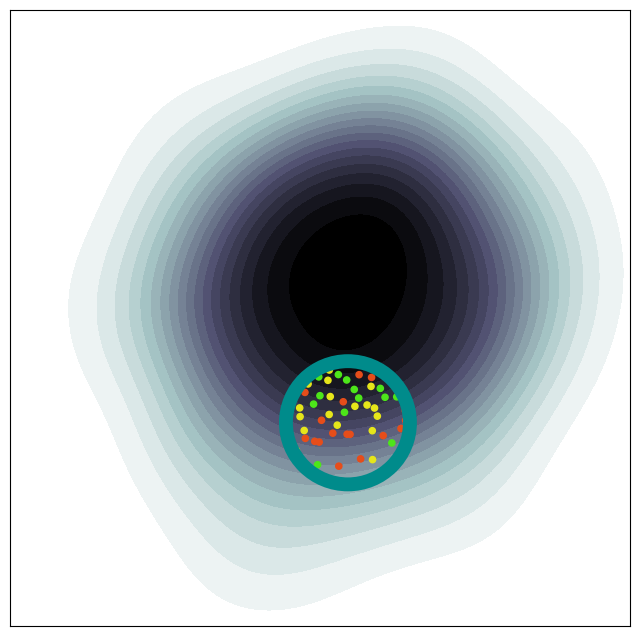

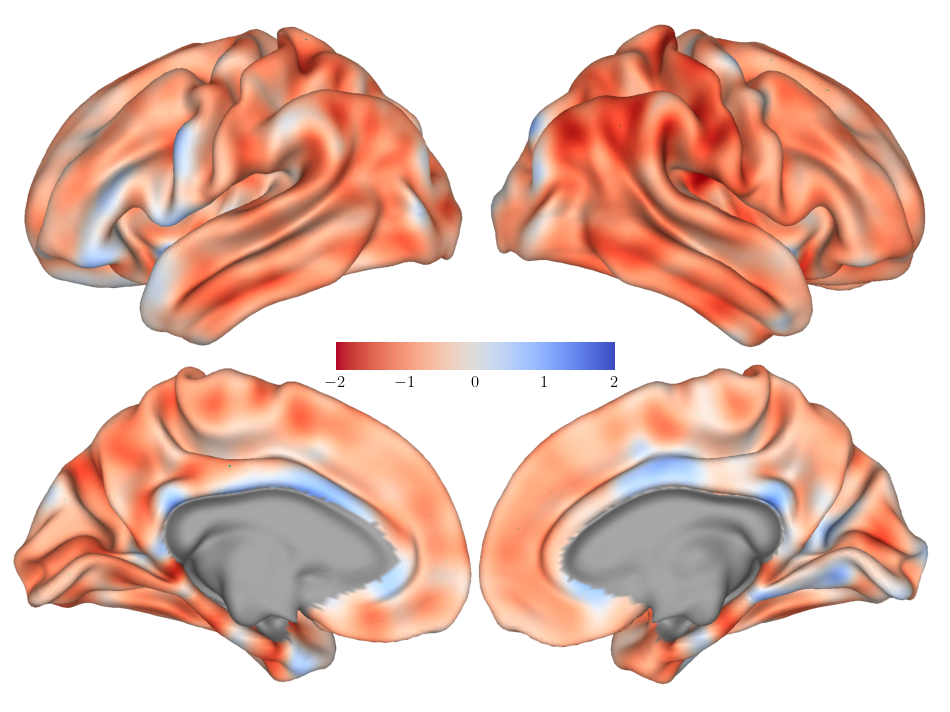

In [355]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from matplotlib.patches import Circle, Ellipse

fig, ax = plt.subplots(figsize=(8, 8))

group_idx = groups_im * np.nan
group_idx[study_hc_mask] = 0
group_idx[study_mc_mask] = 1
group_idx[study_ad_mask] = 2

ax.set_xticks([])
ax.set_yticks([])

tmp_mask = (demography_extended_df_MACC["group"] == "HC")[study_mask]
kdefit = gaussian_kde(atrophy_2D_landscape.T, bw_method=0.5)


X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]

Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T

ax.imshow(Z, cmap=ListedColormap(plt.cm.bone_r(np.linspace(0,1,20))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')

# now let's draw a circle
def draw_ellipse(ax, rx, ry, center, **kwargs):
    ellipse = Ellipse(center, width=2*rx, height=2*ry, **kwargs)
    ax.add_patch(ellipse)

xscaler = (xmax - xmin) / 2
yscaler = (ymax - ymin) / 2

cx, cy, r = -0.0, 0.4, 0.2

selection = (((atrophy_2D_landscape / [xscaler, yscaler]) - np.array([cx,cy]))**2).sum(1) < (r)**2

ax.scatter(
    x=atrophy_2D_landscape[selection, 0],
    y=atrophy_2D_landscape[selection, 1],
    color=np.array([groups_cmap[int(x)] for x in groups_im])[selection, :], s=20,
)
draw_ellipse(ax, rx=r * xscaler, ry=r * yscaler, center=np.array([cx * xscaler, cy * yscaler]), edgecolor='darkcyan', facecolor='none', linewidth=10, alpha=1.)

ax.invert_yaxis()

# Create a figure and an axis for cortical visualization
fig, ax = plt.subplots(figsize=(12, 9))

cmap = plt.get_cmap('coolwarm_r')
colors = cmap(np.linspace(0.0, 1., 400))
mask_color = np.array([0.3, 0.3, 0.3, 1])
mask_power = 0.3
thresh, lim = 1.96, 2
# colors[int((400 * (lim - thresh))/(2*lim)):] = ((1 - mask_power) * colors[int((400 * (lim - thresh))/(2*lim)):]) + (mask_power * mask_color)
altered_cmap = ListedColormap(colors)

signal = high_resolution_normative_thickness_zscore_MACC[study_mask][selection].mean(0)
# cover = signal > -2
lims = [-lim, lim]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=altered_cmap,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    # cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)
pass


#### Individual deviation maps

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



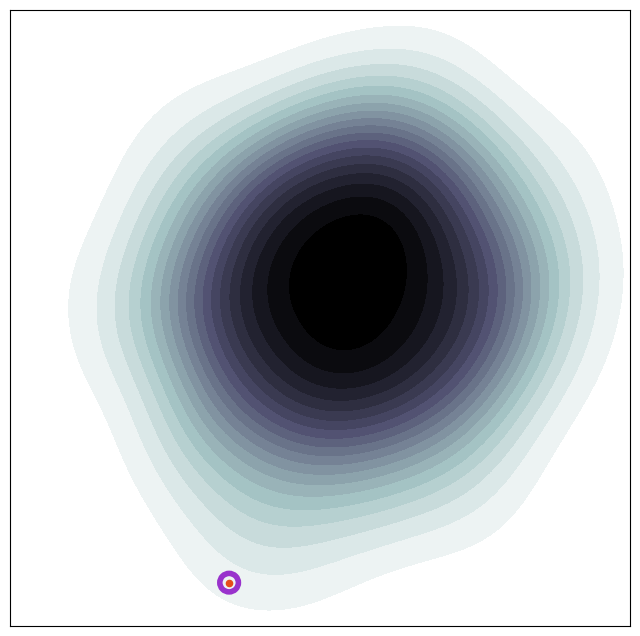

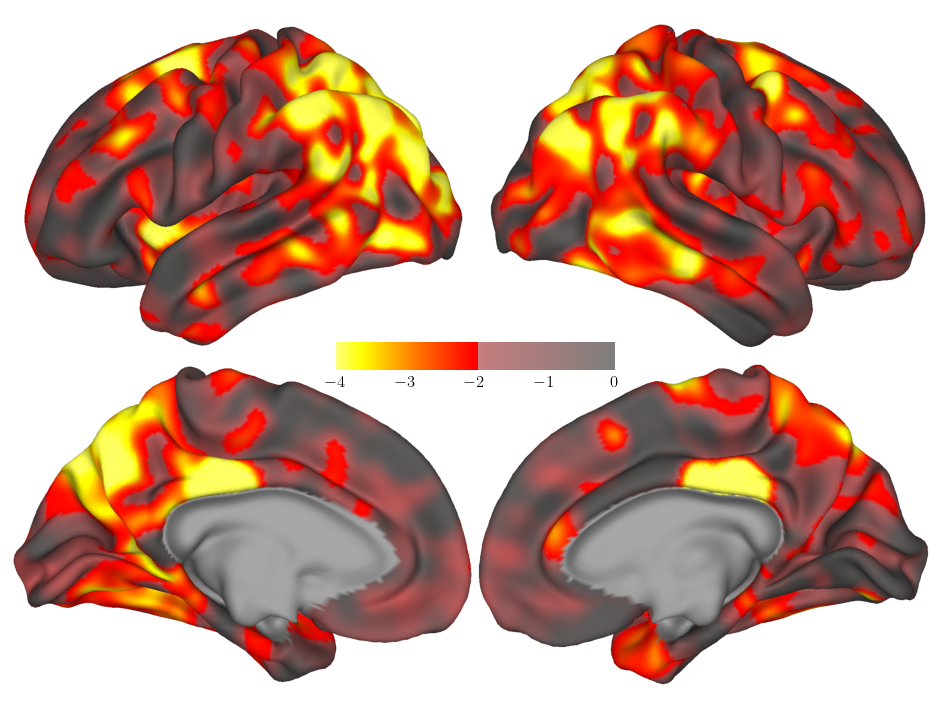

In [358]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from matplotlib.patches import Circle, Ellipse

fig, ax = plt.subplots(figsize=(8, 8))

group_idx = groups_im * np.nan
group_idx[study_hc_mask] = 0
group_idx[study_mc_mask] = 1
group_idx[study_ad_mask] = 2

ax.set_xticks([])
ax.set_yticks([])

tmp_mask = (demography_extended_df_MACC["group"] == "HC")[study_mask]
kdefit = gaussian_kde(atrophy_2D_landscape.T, bw_method=0.5)


X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]

Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T

ax.imshow(Z, cmap=ListedColormap(plt.cm.bone_r(np.linspace(0,1,20))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')

# now let's draw a circle
def draw_ellipse(ax, rx, ry, center, **kwargs):
    ellipse = Ellipse(center, width=2*rx, height=2*ry, **kwargs)
    ax.add_patch(ellipse)

xscaler = (xmax - xmin) / 2
yscaler = (ymax - ymin) / 2

subjid = 81

ax.scatter(
    x=atrophy_2D_landscape[subjid, 0],
    y=atrophy_2D_landscape[subjid, 1],
    color=np.array([groups_cmap[int(x)] for x in groups_im])[subjid, :], s=20,
)
draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[subjid], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)

ax.invert_yaxis()

# Create a figure and an axis for cortical visualization
fig, ax = plt.subplots(figsize=(12, 9))

# cmap = plt.get_cmap('coolwarm_r')
# colors = cmap(np.linspace(0.0, 1., 400))
# mask_color = np.array([0.3, 0.3, 0.3, 1])
# mask_power = 0.3
# thresh, lim = 1.96, 4
# colors[int((400 * (lim - thresh))/(2*lim)):] = ((1 - mask_power) * colors[int((400 * (lim - thresh))/(2*lim)):]) + (mask_power * mask_color)
# altered_cmap = ListedColormap(colors)
# lims = [-lim, lim]

cmap = plt.get_cmap('hot_r')
colors = cmap(np.linspace(0.05, 1., 400)**0.7)
mask_color = np.array([0.7, 0.7, 0.7, 1])
mask_power = 0.7
colors[205:] = ((1 - mask_power) * colors[205:]) + (mask_power * mask_color)
altered_cmap = ListedColormap(colors)
lims = [-4, 0]


signal = high_resolution_normative_thickness_zscore_MACC[study_mask][subjid]
# cover = signal > -2
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=altered_cmap,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    # cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)
pass


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



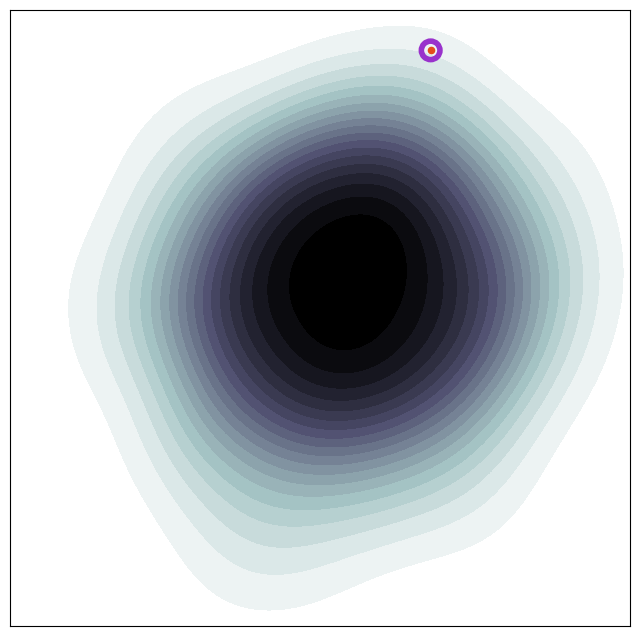

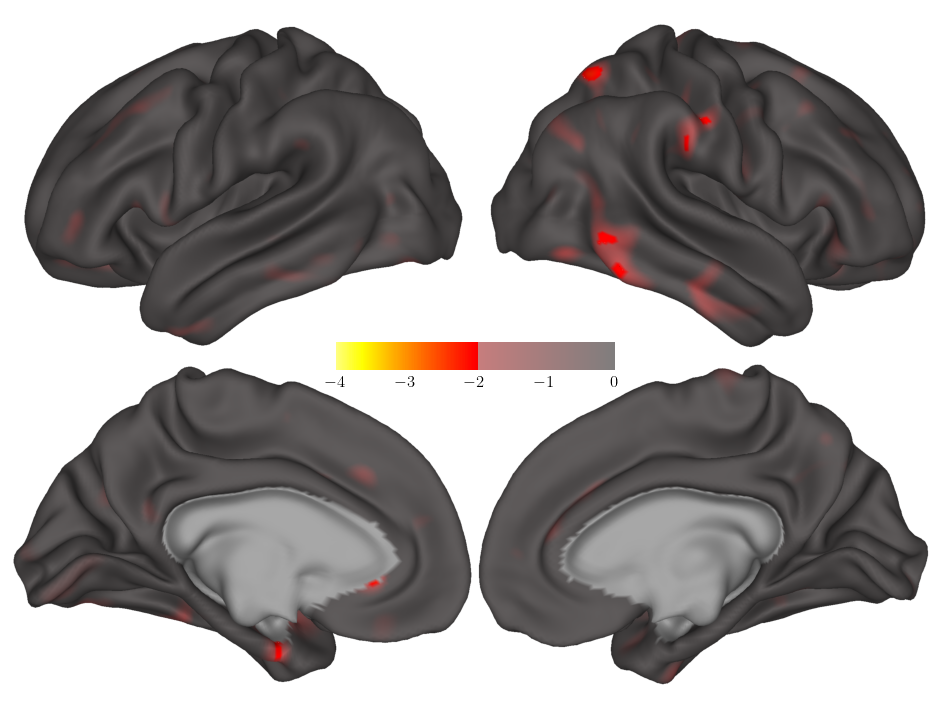

In [359]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from matplotlib.patches import Circle, Ellipse

fig, ax = plt.subplots(figsize=(8, 8))

group_idx = groups_im * np.nan
group_idx[study_hc_mask] = 0
group_idx[study_mc_mask] = 1
group_idx[study_ad_mask] = 2

ax.set_xticks([])
ax.set_yticks([])

tmp_mask = (demography_extended_df_MACC["group"] == "HC")[study_mask]
kdefit = gaussian_kde(atrophy_2D_landscape.T, bw_method=0.5)


X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]

Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T

ax.imshow(Z, cmap=ListedColormap(plt.cm.bone_r(np.linspace(0,1,20))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')

# now let's draw a circle
def draw_ellipse(ax, rx, ry, center, **kwargs):
    ellipse = Ellipse(center, width=2*rx, height=2*ry, **kwargs)
    ax.add_patch(ellipse)

xscaler = (xmax - xmin) / 2
yscaler = (ymax - ymin) / 2

subjid = 139

ax.scatter(
    x=atrophy_2D_landscape[subjid, 0],
    y=atrophy_2D_landscape[subjid, 1],
    color=np.array([groups_cmap[int(x)] for x in groups_im])[subjid, :], s=20,
)
draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[subjid], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)

ax.invert_yaxis()

# Create a figure and an axis for cortical visualization
fig, ax = plt.subplots(figsize=(12, 9))

# cmap = plt.get_cmap('coolwarm_r')
# colors = cmap(np.linspace(0.0, 1., 400))
# mask_color = np.array([0.3, 0.3, 0.3, 1])
# mask_power = 0.3
# thresh, lim = 1.96, 4
# colors[int((400 * (lim - thresh))/(2*lim)):] = ((1 - mask_power) * colors[int((400 * (lim - thresh))/(2*lim)):]) + (mask_power * mask_color)
# altered_cmap = ListedColormap(colors)
# lims = [-lim, lim]

cmap = plt.get_cmap('hot_r')
colors = cmap(np.linspace(0.05, 1., 400)**0.7)
mask_color = np.array([0.7, 0.7, 0.7, 1])
mask_power = 0.7
colors[205:] = ((1 - mask_power) * colors[205:]) + (mask_power * mask_color)
altered_cmap = ListedColormap(colors)
lims = [-4, 0]


signal = high_resolution_normative_thickness_zscore_MACC[study_mask][subjid]
# cover = signal > -2
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=altered_cmap,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    # cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)
pass


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



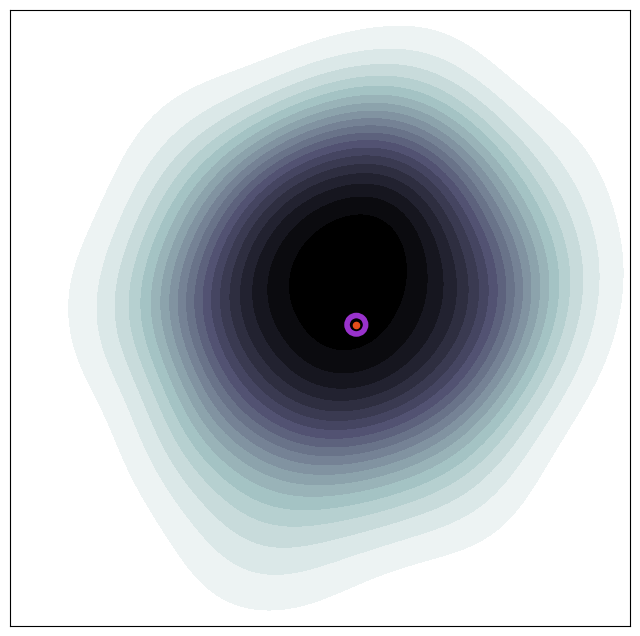

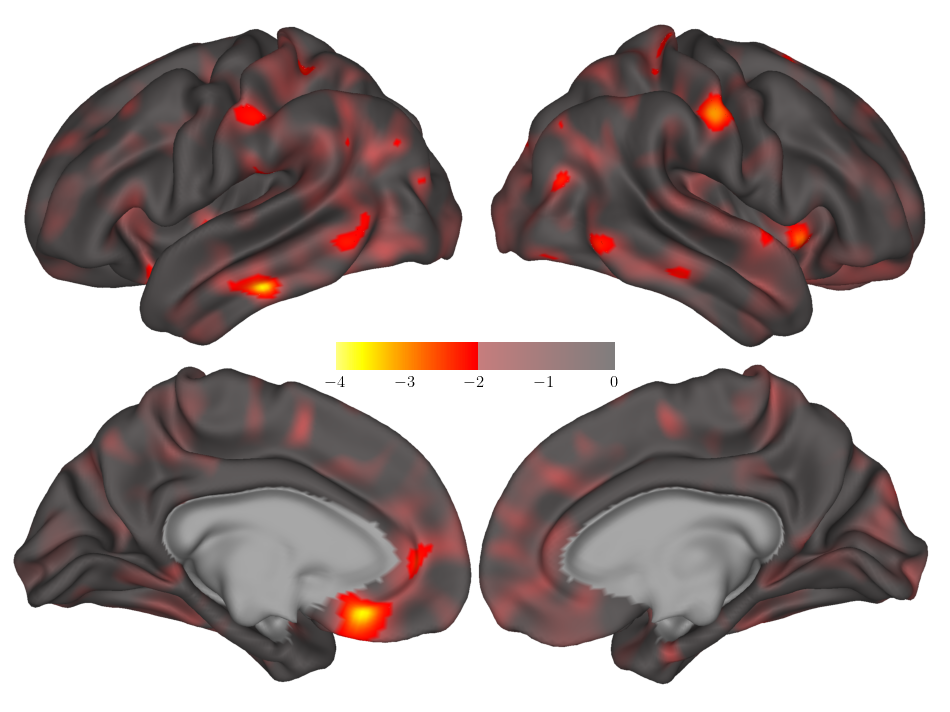

In [360]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from matplotlib.patches import Circle, Ellipse

fig, ax = plt.subplots(figsize=(8, 8))

group_idx = groups_im * np.nan
group_idx[study_hc_mask] = 0
group_idx[study_mc_mask] = 1
group_idx[study_ad_mask] = 2

ax.set_xticks([])
ax.set_yticks([])

tmp_mask = (demography_extended_df_MACC["group"] == "HC")[study_mask]
kdefit = gaussian_kde(atrophy_2D_landscape.T, bw_method=0.5)


X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]

Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T

ax.imshow(Z, cmap=ListedColormap(plt.cm.bone_r(np.linspace(0,1,20))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')

# now let's draw a circle
def draw_ellipse(ax, rx, ry, center, **kwargs):
    ellipse = Ellipse(center, width=2*rx, height=2*ry, **kwargs)
    ax.add_patch(ellipse)

xscaler = (xmax - xmin) / 2
yscaler = (ymax - ymin) / 2

subjid = 510

ax.scatter(
    x=atrophy_2D_landscape[subjid, 0],
    y=atrophy_2D_landscape[subjid, 1],
    color=np.array([groups_cmap[int(x)] for x in groups_im])[subjid, :], s=20,
)
draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[subjid], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)

ax.invert_yaxis()

# Create a figure and an axis for cortical visualization
fig, ax = plt.subplots(figsize=(12, 9))

# cmap = plt.get_cmap('coolwarm_r')
# colors = cmap(np.linspace(0.0, 1., 400))
# mask_color = np.array([0.3, 0.3, 0.3, 1])
# mask_power = 0.3
# thresh, lim = 1.96, 4
# colors[int((400 * (lim - thresh))/(2*lim)):] = ((1 - mask_power) * colors[int((400 * (lim - thresh))/(2*lim)):]) + (mask_power * mask_color)
# altered_cmap = ListedColormap(colors)
# lims = [-lim, lim]

cmap = plt.get_cmap('hot_r')
colors = cmap(np.linspace(0.05, 1., 400)**0.7)
mask_color = np.array([0.7, 0.7, 0.7, 1])
mask_power = 0.7
colors[205:] = ((1 - mask_power) * colors[205:]) + (mask_power * mask_color)
altered_cmap = ListedColormap(colors)
lims = [-4, 0]


signal = high_resolution_normative_thickness_zscore_MACC[study_mask][subjid]
# cover = signal > -2
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=altered_cmap,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    # cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)
pass


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



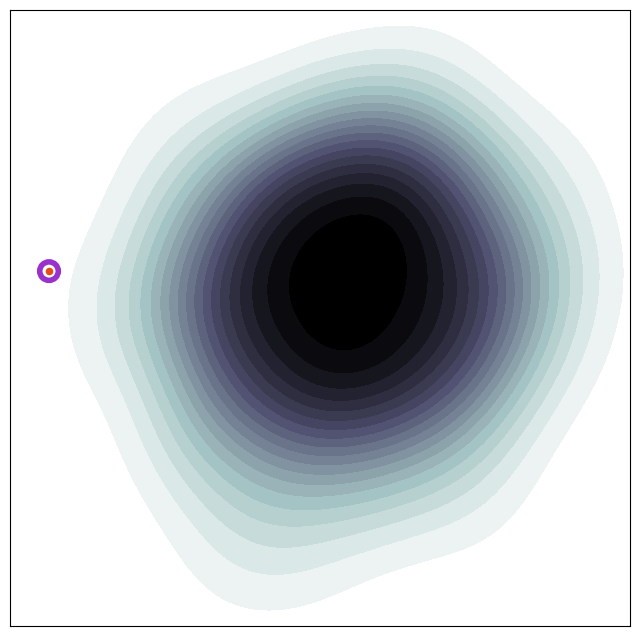

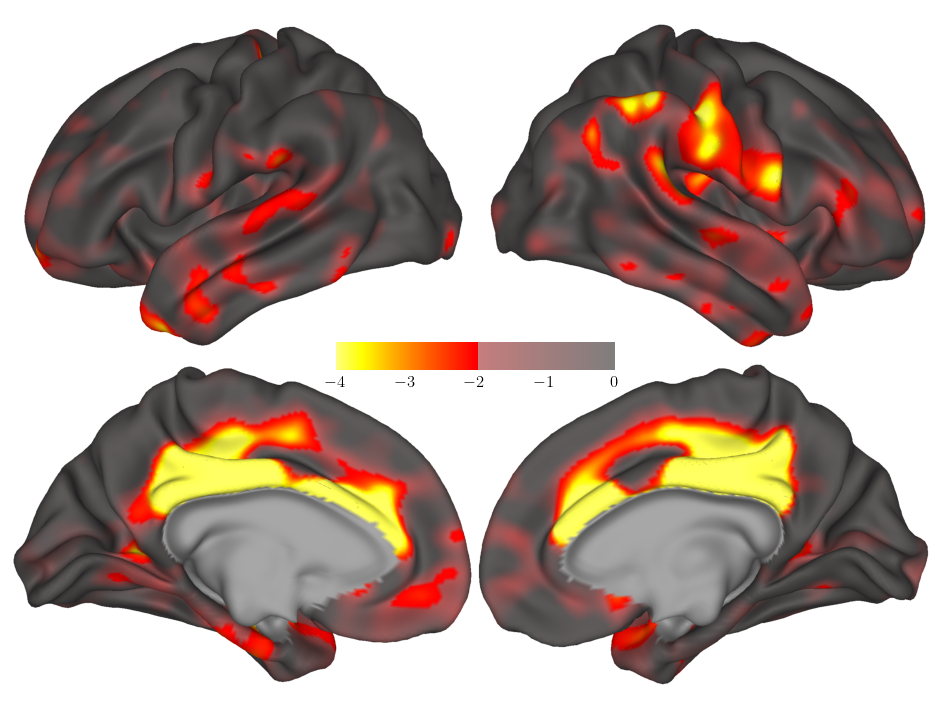

In [361]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from matplotlib.patches import Circle, Ellipse

fig, ax = plt.subplots(figsize=(8, 8))

group_idx = groups_im * np.nan
group_idx[study_hc_mask] = 0
group_idx[study_mc_mask] = 1
group_idx[study_ad_mask] = 2

ax.set_xticks([])
ax.set_yticks([])

tmp_mask = (demography_extended_df_MACC["group"] == "HC")[study_mask]
kdefit = gaussian_kde(atrophy_2D_landscape.T, bw_method=0.5)


X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]

Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T

ax.imshow(Z, cmap=ListedColormap(plt.cm.bone_r(np.linspace(0,1,20))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')

# now let's draw a circle
def draw_ellipse(ax, rx, ry, center, **kwargs):
    ellipse = Ellipse(center, width=2*rx, height=2*ry, **kwargs)
    ax.add_patch(ellipse)

xscaler = (xmax - xmin) / 2
yscaler = (ymax - ymin) / 2

subjid = 503

ax.scatter(
    x=atrophy_2D_landscape[subjid, 0],
    y=atrophy_2D_landscape[subjid, 1],
    color=np.array([groups_cmap[int(x)] for x in groups_im])[subjid, :], s=20,
)
draw_ellipse(ax, rx=0.03 * xscaler, ry=0.03 * yscaler, center=atrophy_2D_landscape[subjid], edgecolor='darkorchid', facecolor='none', linewidth=4, alpha=1.)

ax.invert_yaxis()

# Create a figure and an axis for cortical visualization
fig, ax = plt.subplots(figsize=(12, 9))

# cmap = plt.get_cmap('coolwarm_r')
# colors = cmap(np.linspace(0.0, 1., 400))
# mask_color = np.array([0.3, 0.3, 0.3, 1])
# mask_power = 0.3
# thresh, lim = 1.96, 4
# colors[int((400 * (lim - thresh))/(2*lim)):] = ((1 - mask_power) * colors[int((400 * (lim - thresh))/(2*lim)):]) + (mask_power * mask_color)
# altered_cmap = ListedColormap(colors)
# lims = [-lim, lim]

cmap = plt.get_cmap('hot_r')
colors = cmap(np.linspace(0.05, 1., 400)**0.7)
mask_color = np.array([0.7, 0.7, 0.7, 1])
mask_power = 0.7
colors[205:] = ((1 - mask_power) * colors[205:]) + (mask_power * mask_color)
altered_cmap = ListedColormap(colors)
lims = [-4, 0]


signal = high_resolution_normative_thickness_zscore_MACC[study_mask][subjid]
# cover = signal > -2
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=altered_cmap,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    # cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
)
pass


#### Cohort-based distributions

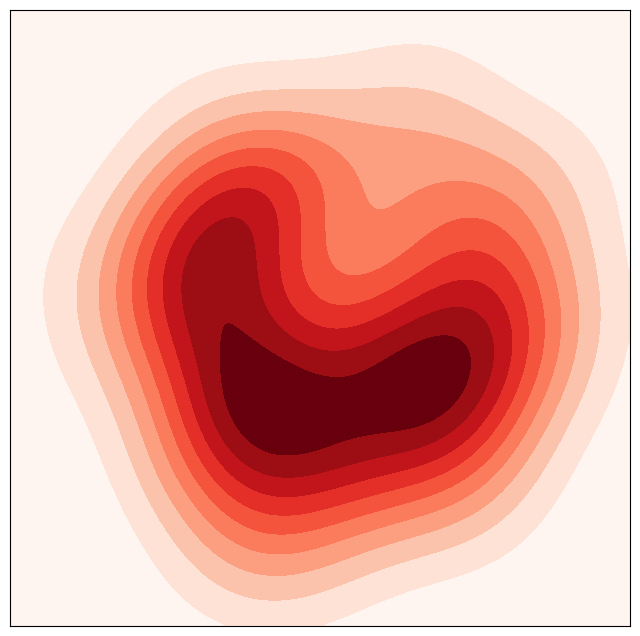

In [364]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

fig, ax = plt.subplots(figsize=(8, 8))

group_idx = groups_im * np.nan
group_idx[study_hc_mask] = 0
group_idx[study_mc_mask] = 1
group_idx[study_ad_mask] = 2

ax.set_xticks([])
ax.set_yticks([])

tmp_mask = (demography_extended_df_MACC["group"] == "HC")[study_mask]
kdefit = gaussian_kde(atrophy_2D_landscape[study_ad_mask].T, bw_method=0.5)


X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]

Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T

ax.imshow(Z, cmap=ListedColormap(plt.cm.Reds(np.linspace(0,1,10))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')

ax.invert_yaxis()


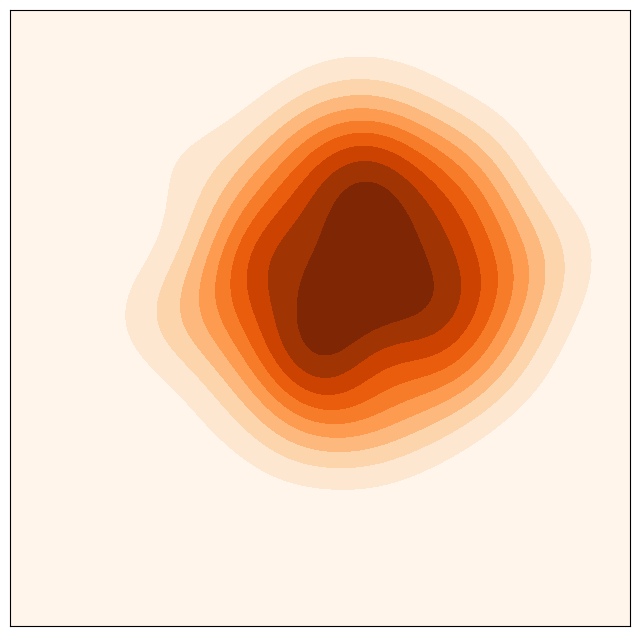

In [365]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

fig, ax = plt.subplots(figsize=(8, 8))

group_idx = groups_im * np.nan
group_idx[study_hc_mask] = 0
group_idx[study_mc_mask] = 1
group_idx[study_ad_mask] = 2

ax.set_xticks([])
ax.set_yticks([])

tmp_mask = (demography_extended_df_MACC["group"] == "HC")[study_mask]
kdefit = gaussian_kde(atrophy_2D_landscape[study_mc_mask].T, bw_method=0.5)


X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]

Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T

ax.imshow(Z, cmap=ListedColormap(plt.cm.Oranges(np.linspace(0,1,10))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')

ax.invert_yaxis()


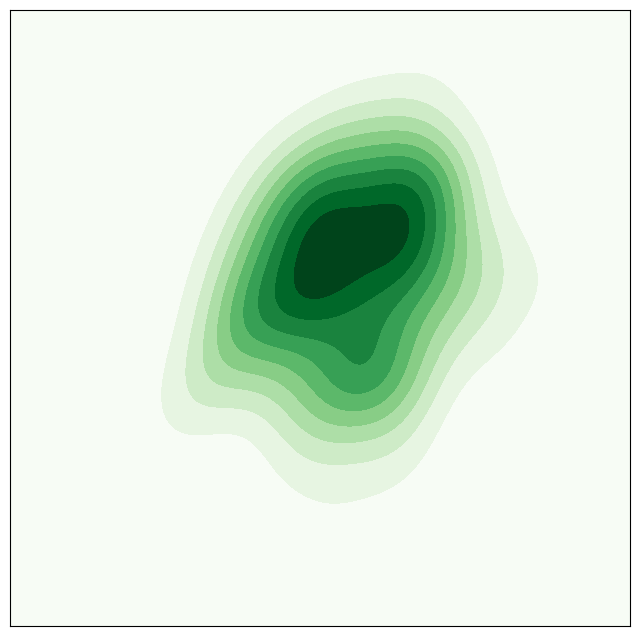

In [366]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

fig, ax = plt.subplots(figsize=(8, 8))

group_idx = groups_im * np.nan
group_idx[study_hc_mask] = 0
group_idx[study_mc_mask] = 1
group_idx[study_ad_mask] = 2

ax.set_xticks([])
ax.set_yticks([])

tmp_mask = (demography_extended_df_MACC["group"] == "HC")[study_mask]
kdefit = gaussian_kde(atrophy_2D_landscape[study_hc_mask].T, bw_method=0.5)


X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]

Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T

ax.imshow(Z, cmap=ListedColormap(plt.cm.Greens(np.linspace(0,1,10))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')

ax.invert_yaxis()


#### Making videos

##### Testing the function

In [589]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from matplotlib.patches import Circle, Ellipse

def draw_ellipse(ax, rx, ry, center, **kwargs):
    ellipse = Ellipse(center, width=2*rx, height=2*ry, **kwargs)
    ax.add_patch(ellipse)


plt.close("all")
    
def plot_mean_z_score_of_landscape(ax, cx, cy, r, out_file):
    xscaler = (xmax - xmin) / 2
    yscaler = (ymax - ymin) / 2
    
    # cx, cy, r = 0.3, -0.3, 0.2
    
    selection = (((atrophy_2D_landscape / [xscaler, yscaler]) - np.array([cx,cy]))**2).sum(1) < (r)**2
    
    cmap = plt.get_cmap('coolwarm_r')
    colors = cmap(np.linspace(0.0, 1., 400))
    mask_color = np.array([0.3, 0.3, 0.3, 1])
    mask_power = 0.3
    thresh, lim = 1.96, 2
    # colors[int((400 * (lim - thresh))/(2*lim)):] = ((1 - mask_power) * colors[int((400 * (lim - thresh))/(2*lim)):]) + (mask_power * mask_color)
    altered_cmap = ListedColormap(colors)
    
    signal = high_resolution_normative_thickness_zscore_MACC[study_mask][selection].mean(0)
    # cover = signal > -2
    lims = [-lim, lim]
    plot_left_right_surface_with_cerebro(
        # signal, ax, clims=lims, show_colorbar=False, colormap=altered_cmap,
        signal, ax, clims=lims, show_colorbar=True, colormap=altered_cmap,
        # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
        # cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
    )
    
    hax = inset_axes(
        ax,
        width="54%",
        height="72%",
        loc="center right",
        bbox_to_anchor=(0.54, 0.0, 1., 1.),
        bbox_transform=ax.transAxes,
        borderpad=0,
    )
    
    group_idx = groups_im * np.nan
    group_idx[study_hc_mask[study_mask]] = 0
    group_idx[study_mc_mask[study_mask]] = 1
    group_idx[study_ad_mask[study_mask]] = 2
    
    hax.set_xticks([])
    hax.set_yticks([])
    
    kdefit = gaussian_kde(atrophy_2D_landscape.T, bw_method=0.5)
    
    
    X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]
    
    Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T
    
    hax.imshow(Z, cmap=ListedColormap(plt.cm.bone_r(np.linspace(0,1,20))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')
    
    hax.scatter(
        x=atrophy_2D_landscape[selection, 0],
        y=atrophy_2D_landscape[selection, 1],
        color=np.array([groups_cmap[int(x)] for x in groups_im])[selection, :], s=30,
    )
    draw_ellipse(hax, rx=r * xscaler, ry=r * yscaler, center=np.array([cx * xscaler, cy * yscaler]), edgecolor='darkcyan', facecolor='none', linewidth=8, alpha=1.)
    
    # Remove all spines (borders)
    for spine in hax.spines.values():
        spine.set_visible(False)

    hax.invert_yaxis()
    
    plt.savefig(out_file, bbox_inches='tight')
    # plt.savefig("/home/sina/storage/Normative_Modeling/figs/test.png")

    # plt.close()

pass


In [590]:

# Create a figure and an axis for cortical visualization
fig, ax = plt.subplots(figsize=(12, 9))

plot_mean_z_score_of_landscape(ax=ax, cx= 0.3, cy=-0.3, r=0.2, out_file="/home/sina/storage/Normative_Modeling/figs/test.png")

plt.close()

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



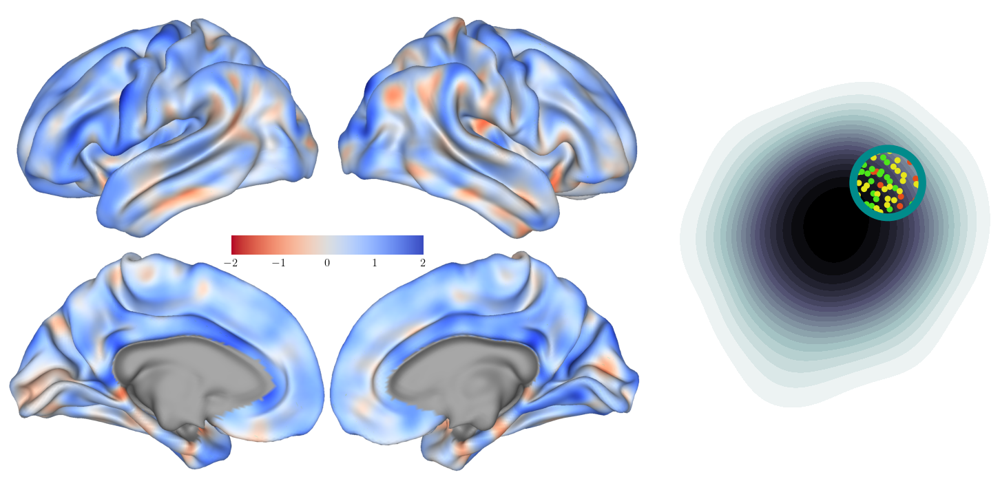

In [591]:
from IPython.display import Image
Image(filename="/home/sina/storage/Normative_Modeling/figs/test.png")

In [592]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from matplotlib.patches import Circle, Ellipse

def draw_ellipse(ax, rx, ry, center, **kwargs):
    ellipse = Ellipse(center, width=2*rx, height=2*ry, **kwargs)
    ax.add_patch(ellipse)


plt.close("all")
    
def plot_mean_z_score_of_masked_landscape(ax, cx, cy, r, mask, out_file):
    xscaler = (xmax - xmin) / 2
    yscaler = (ymax - ymin) / 2
    
    # cx, cy, r = 0.3, -0.3, 0.2
    
    selection = (((atrophy_2D_landscape / [xscaler, yscaler]) - np.array([cx,cy]))**2).sum(1) < (r)**2
    selection = selection & mask
    
    cmap = plt.get_cmap('coolwarm_r')
    colors = cmap(np.linspace(0.0, 1., 400))
    mask_color = np.array([0.3, 0.3, 0.3, 1])
    mask_power = 0.3
    thresh, lim = 1.96, 2
    # colors[int((400 * (lim - thresh))/(2*lim)):] = ((1 - mask_power) * colors[int((400 * (lim - thresh))/(2*lim)):]) + (mask_power * mask_color)
    altered_cmap = ListedColormap(colors)
    
    signal = high_resolution_normative_thickness_zscore_MACC[study_mask][selection].mean(0)
    # cover = signal > -2
    lims = [-lim, lim]
    plot_left_right_surface_with_cerebro(
        # signal, ax, clims=lims, show_colorbar=False, colormap=altered_cmap,
        signal, ax, clims=lims, show_colorbar=True, colormap=altered_cmap,
        # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
        # cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.15
    )
    
    hax = inset_axes(
        ax,
        width="54%",
        height="72%",
        loc="center right",
        bbox_to_anchor=(0.54, 0.0, 1., 1.),
        bbox_transform=ax.transAxes,
        borderpad=0,
    )
    
    group_idx = groups_im * np.nan
    group_idx[study_hc_mask[study_mask]] = 0
    group_idx[study_hc_mask[study_mask]] = 1
    group_idx[study_hc_mask[study_mask]] = 2
    
    hax.set_xticks([])
    hax.set_yticks([])
    
    kdefit = gaussian_kde(atrophy_2D_landscape.T, bw_method=0.5)
    
    
    X, Y = np.mgrid[xmin:xmax:200j, ymin:ymax:200j]
    
    Z = np.reshape(kdefit(np.vstack([X.ravel(), Y.ravel()])).T, X.shape).T
    
    hax.imshow(Z, cmap=ListedColormap(plt.cm.bone_r(np.linspace(0,1,20))), aspect='auto', extent=(xmin,xmax,ymin,ymax), origin='lower', interpolation='bicubic')
    
    hax.scatter(
        x=atrophy_2D_landscape[selection, 0],
        y=atrophy_2D_landscape[selection, 1],
        color=np.array([groups_cmap[int(x)] for x in groups_im])[selection, :], s=30,
    )
    draw_ellipse(hax, rx=r * xscaler, ry=r * yscaler, center=np.array([cx * xscaler, cy * yscaler]), edgecolor='darkcyan', facecolor='none', linewidth=8, alpha=1.)
    
    # Remove all spines (borders)
    for spine in hax.spines.values():
        spine.set_visible(False)

    hax.invert_yaxis()
    
    plt.savefig(out_file, bbox_inches='tight')
    # plt.savefig("/home/sina/storage/Normative_Modeling/figs/test.png")

    # plt.close()

pass


In [593]:

# Create a figure and an axis for cortical visualization
fig, ax = plt.subplots(figsize=(12, 9))

plot_mean_z_score_of_masked_landscape(ax=ax, cx= 0.3, cy=-0.3, r=0.2, mask=study_ad_mask[study_mask], out_file="/home/sina/storage/Normative_Modeling/figs/test.png")

plt.close()

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



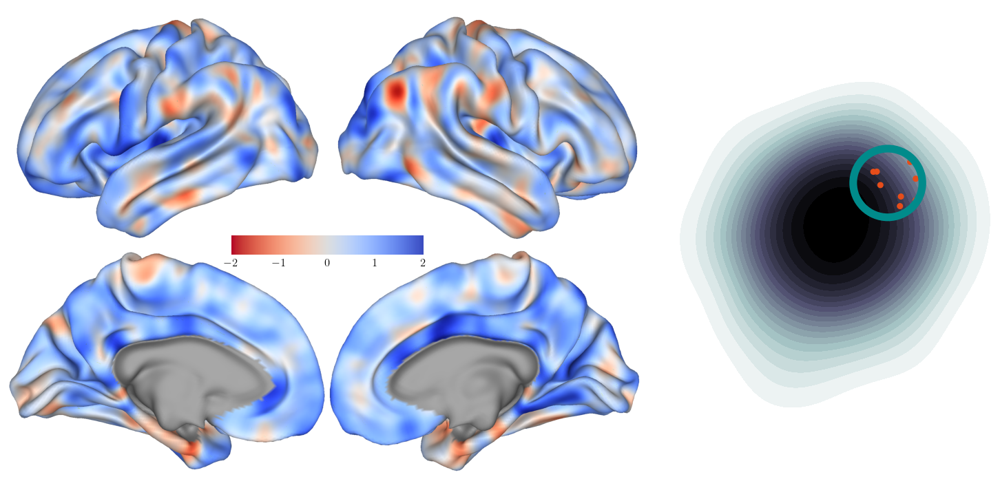

In [594]:
from IPython.display import Image
Image(filename="/home/sina/storage/Normative_Modeling/figs/test.png")

##### All sample circular video

In [597]:
k=200
r = 0.2
d = 0.4
for i in tqdm(range(k)):
    cx = np.cos(2*np.pi*i/k)*d
    cy = np.sin(2*np.pi*i/k)*d
    fig, ax = plt.subplots(figsize=(12, 9))
    plot_mean_z_score_of_landscape(ax=ax, cx=cx, cy=cy, r=r, out_file=f"/home/sina/storage/Normative_Modeling/figs/figure_ad_landscape_r={r}_d={d}_angle={i}|{k}.png")
    plt.close()
    

  0%|          | 0/200 [00:00<?, ?it/s]

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol

In [598]:
# Now let's make a video from that: (using opencv)
import cv2

# Get list of image files
image_files = ([f"/home/sina/storage/Normative_Modeling/figs/figure_ad_landscape_r={r}_d={d}_angle={i}|{k}.png" for i in range(k)])

# Load the first image to get dimensions
first_image = cv2.imread(image_files[0])
height, width, layers = first_image.shape

# Create a video writer object
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # codec for .mp4
fps = 30  # Frames per second for the video
output_video = ensure_dir(f'/home/sina/storage/Normative_Modeling/videos/landscape_traversal_all_r={r}_d={d}.mp4')
video = cv2.VideoWriter(output_video, fourcc, fps, (width, height))

# Loop through the image files and write them to the video
for image_file in tqdm(image_files):
    img = cv2.imread(image_file)
    video.write(img)

# Release the video writer object
video.release()

print(f"Video saved as {output_video}")

  0%|          | 0/200 [00:00<?, ?it/s]

Video saved as /home/sina/storage/Normative_Modeling/videos/landscape_traversal_all_r=0.2_d=0.4.mp4


##### HC only circular video

In [599]:
k=200
r = 0.2
d = 0.4
for i in tqdm(range(k)):
    cx = np.cos(2*np.pi*i/k)*d
    cy = np.sin(2*np.pi*i/k)*d
    fig, ax = plt.subplots(figsize=(12, 9))
    plot_mean_z_score_of_masked_landscape(ax=ax, cx=cx, cy=cy, r=r, mask=study_hc_mask[study_mask], out_file=f"/home/sina/storage/Normative_Modeling/figs/figure_hc_mask_ad_landscape_r={r}_d={d}_angle={i}|{k}.png")
    plt.close()
    

  0%|          | 0/200 [00:00<?, ?it/s]

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol

In [600]:
# Now let's make a video from that: (using opencv)
import cv2

# Get list of image files
image_files = ([f"/home/sina/storage/Normative_Modeling/figs/figure_hc_mask_ad_landscape_r={r}_d={d}_angle={i}|{k}.png" for i in range(k)])

# Load the first image to get dimensions
first_image = cv2.imread(image_files[0])
height, width, layers = first_image.shape

# Create a video writer object
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # codec for .mp4
fps = 30  # Frames per second for the video
output_video = ensure_dir(f'/home/sina/storage/Normative_Modeling/videos/landscape_traversal_hc_r={r}_d={d}.mp4')
video = cv2.VideoWriter(output_video, fourcc, fps, (width, height))

# Loop through the image files and write them to the video
for image_file in tqdm(image_files):
    img = cv2.imread(image_file)
    video.write(img)

# Release the video writer object
video.release()

print(f"Video saved as {output_video}")

  0%|          | 0/200 [00:00<?, ?it/s]

Video saved as /home/sina/storage/Normative_Modeling/videos/landscape_traversal_hc_r=0.2_d=0.4.mp4


##### MCI only circular video

In [ ]:
k=200
r = 0.2
d = 0.4
for i in tqdm(range(k)):
    cx = np.cos(2*np.pi*i/k)*d
    cy = np.sin(2*np.pi*i/k)*d
    fig, ax = plt.subplots(figsize=(12, 9))
    plot_mean_z_score_of_masked_landscape(ax=ax, cx=cx, cy=cy, r=r, mask=study_mc_mask[study_mask], out_file=f"/home/sina/storage/Normative_Modeling/figs/figure_mc_mask_ad_landscape_r={r}_d={d}_angle={i}|{k}.png")
    plt.close()
    

  0%|          | 0/200 [00:00<?, ?it/s]

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



In [ ]:
# Now let's make a video from that: (using opencv)
import cv2

# Get list of image files
image_files = ([f"/home/sina/storage/Normative_Modeling/figs/figure_mc_mask_ad_landscape_r={r}_d={d}_angle={i}|{k}.png" for i in range(k)])

# Load the first image to get dimensions
first_image = cv2.imread(image_files[0])
height, width, layers = first_image.shape

# Create a video writer object
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # codec for .mp4
fps = 30  # Frames per second for the video
output_video = ensure_dir(f'/home/sina/storage/Normative_Modeling/videos/landscape_traversal_mc_r={r}_d={d}.mp4')
video = cv2.VideoWriter(output_video, fourcc, fps, (width, height))

# Loop through the image files and write them to the video
for image_file in tqdm(image_files):
    img = cv2.imread(image_file)
    video.write(img)

# Release the video writer object
video.release()

print(f"Video saved as {output_video}")

##### AD only circular video

In [ ]:
k=200
r = 0.2
d = 0.4
for i in tqdm(range(k)):
    cx = np.cos(2*np.pi*i/k)*d
    cy = np.sin(2*np.pi*i/k)*d
    fig, ax = plt.subplots(figsize=(12, 9))
    plot_mean_z_score_of_masked_landscape(ax=ax, cx=cx, cy=cy, r=r, mask=study_ad_mask[study_mask], out_file=f"/home/sina/storage/Normative_Modeling/figs/figure_ad_mask_ad_landscape_r={r}_d={d}_angle={i}|{k}.png")
    plt.close()
    

In [ ]:
# Now let's make a video from that: (using opencv)
import cv2

# Get list of image files
image_files = ([f"/home/sina/storage/Normative_Modeling/figs/figure_ad_mask_ad_landscape_r={r}_d={d}_angle={i}|{k}.png" for i in range(k)])

# Load the first image to get dimensions
first_image = cv2.imread(image_files[0])
height, width, layers = first_image.shape

# Create a video writer object
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # codec for .mp4
fps = 30  # Frames per second for the video
output_video = ensure_dir(f'/home/sina/storage/Normative_Modeling/videos/landscape_traversal_ad_r={r}_d={d}.mp4')
video = cv2.VideoWriter(output_video, fourcc, fps, (width, height))

# Loop through the image files and write them to the video
for image_file in tqdm(image_files):
    img = cv2.imread(image_file)
    video.write(img)

# Release the video writer object
video.release()

print(f"Video saved as {output_video}")

## An exemplary individual

---

### Finding individual pair

---

Find two individuals with similar mmse, and similar extreme thinning, but different patterns.

mask ad patients with similar mmse and thinning, try to match for age, sex, but different pattern of thinning


In [642]:
# mmse between 15 and 20
mmse_band_mask = (demography_extended_df_MACC["mmse"] < 20) & (demography_extended_df_MACC["mmse"] > 15)
print(f'Total of {mmse_band_mask.sum()} individuals with MMSE in (15,20) range.')

# extreme thinning between 4000, 6000
thinning_band_mask = (demography_extended_df_MACC["extreme_thinning"] < 6000) & (demography_extended_df_MACC["extreme_thinning"] > 4000)
print(f'Total of {thinning_band_mask.sum()} individuals with extreme thinning in (4000, 6000) range.')


print(f'Total of {(thinning_band_mask & mmse_band_mask).sum()} individuals in the intersection.')


Total of 90 individuals with MMSE in (15,20) range.
Total of 67 individuals with extreme thinning in (4000, 6000) range.
Total of 12 individuals in the intersection.


In [643]:
demography_extended_df_MACC[thinning_band_mask & mmse_band_mask]

,subject_ID,sex,age,diagnosis,mmse,thickness_connectome_pc_0,thickness_connectome_pc_1,thickness_connectome_pc_2,thickness_connectome_pc_3,thickness_connectome_pc_4,...,thickness_connectome_pc_996,thickness_connectome_pc_997,thickness_connectome_pc_998,thickness_connectome_pc_999,age_bins,split,extreme_thinning,log_extreme_thinning,stat_thinning,extreme_centile
15,HD016,1,61.600000,AD,17.0,588.054941,3.505498,28.471926,-41.826815,16.050012,...,1.591929,1.153245,1.394883,-3.183776,0,Test,4173,3.250908,-3.981663,-2.188207
81,HD083,1,78.000000,AD,17.0,528.454143,-4.187635,23.943017,-42.329040,7.989145,...,0.788077,-0.030616,-4.324352,-1.438167,7,Test,4250,2.895423,-3.591592,-2.110055
127,HD133,0,65.000000,VAD,19.0,596.468367,-15.966175,32.168747,-38.029192,7.276114,...,3.450135,-1.251467,0.214043,-0.304359,1,Test,5023,3.387212,-4.008112,-2.404313
160,HD169,0,71.000000,VAD,16.0,558.033051,-5.320479,9.121217,-39.352255,0.829343,...,4.842332,2.514277,-2.782764,-2.729243,3,Test,5154,3.199481,-3.868326,-2.267750
201,HD212,1,79.000000,AD,16.0,563.451500,5.656672,37.717765,-22.651691,4.808477,...,-0.076353,1.441353,-4.288378,-3.797360,7,Test,4090,3.250908,-3.902391,-2.191285
405,HD427,1,70.200000,AD,17.0,552.719284,-10.211267,27.250149,-45.911725,7.150536,...,0.848027,-0.502648,-1.476895,-0.114147,3,Test,5187,3.151063,-3.837080,-2.256568
465,HD491,0,69.884932,AD,19.0,553.277987,6.493166,19.384726,-37.564567,15.992832,...,3.082466,0.400543,0.641407,-1.841377,3,Test,4760,3.037825,-3.710239,-2.181355
500,HD528,1,80.000000,CIND,16.0,538.231397,-17.624087,28.880641,-36.806335,18.622327,...,3.137408,3.268752,3.457382,-7.552287,7,Test,4881,3.065206,-3.748630,-2.209399
514,HD542,0,68.000000,AD,16.0,583.950274,-3.257286,28.568496,-57.487328,12.334382,...,-1.973922,-0.643908,-3.785991,-2.099217,2,Test,4019,3.159868,-3.889536,-2.150329
522,HD550,0,66.000000,AD,17.0,568.921385,-1.890249,25.055768,-52.139420,3.504288,...,0.904357,-1.028481,2.910808,-3.409419,1,Test,4628,3.187239,-3.980038,-2.225344


In [839]:
# manually selected pair of individuals
s1, s2 = 81, 201
demography_extended_df_MACC.iloc[[s1, s2]][['sex', 'age', 'mmse', 'diagnosis', 'extreme_thinning']]

,sex,age,mmse,diagnosis,extreme_thinning
81,1,78.0,17.0,AD,4250
201,1,79.0,16.0,AD,4090


In [ ]:
# statistically different?

In [2635]:
# compare their extremely thin regions:
hrz1, hrz2 = high_resolution_normative_thickness_zscore_MACC[s1].copy(), high_resolution_normative_thickness_zscore_MACC[s2].copy()

mask1, mask2 = (hrz1 < z_threshold), (hrz2 < z_threshold)

print(f"S1 has {mask1.sum()} extremely thin vertices, and S2 has {mask2.sum()}")

print(f"The intersection is {(mask1 & mask2).sum()} vertices.")

print(f"The dice coefficien is {(2*(mask1 & mask2).sum())/((mask1).sum() + (mask2).sum()):.3f} vertices.")

print(f"The weighted deviation maps (before masking) have a correlation of {pearsonr(hrz1, hrz2)[0]:.3f}")


S1 has 4250 extremely thin vertices, and S2 has 4090
The intersection is 372 vertices.
The dice coefficien is 0.089 vertices.
The weighted deviation maps (before masking) have a correlation of 0.054


In [2684]:
def non_parametric_spin_test(
        data_l1,
        data_r1,
        data_l2,
        data_r2,
        vertices_l,
        vertices_r,
        permutations=1000,
        random_seed=None,
        method='pearson',
        two_tailed=False):
    """
    Calculate the p-value of correlation between two surface maps based on
    the null distribution of spins of map 2

    Args:
        data_l1 (list):
            surface map 1 for the left hemisphere data (length N).
        data_r1 (list):
            surface map 1 for the right hemisphere data (length N).
        data_l2 (list):
            surface map 2 for the left hemisphere data (length N).
        data_r2 (list):
            surface map 2 for the right hemisphere data (length N).
        vertices_l (array):
            x,y,z location of each suraface vertex from left surface
            sphere mesh (shape (N,3)).
        vertices_r (array):
            x,y,z location of each suraface vertex from right surface
            sphere mesh (shape (N,3)).
        permutations (int):
            The number of permutations, default=1000.
        random_seed (int):
            Seed used for replicability in the random number generation.
            defualt=None,
        method (string):
            Choice of correspondence methods: from "pearson" and "spearman".
        two_tailed (bool):
            a flag to indicate whether the non-parametric test should be
            one- or two-tailed. It is recommended to use the more stringent
            two-tailed test, unless a hypothesis is pointing to the expected
            correspondence direction (positive/negative)
            default=False

    Returns:
        dict:
            {
                'corellation r': The Pearson's corellation of the surface maps,
                'parametric p-val': parametric p-value of the correlation in a t-test,
                'non-parametric p-val': non-parametric p-value from the spin test (main result),
                'null distribution of r values': distribution of null,
            }
    """
    if random_seed is not None:
        np.random.seed(random_seed)

    # build kd-tree from surfaces
    ckdtree_l = spatial.cKDTree(vertices_l)
    ckdtree_r = spatial.cKDTree(vertices_r)

    # keep data1, rotate data2, and permute.
    data1 = np.concatenate([data_l1, data_r1])
    data2 = np.concatenate([data_l2, data_r2])
    mask = ~np.isnan(data1) & ~np.isnan(data2)

    # get the unrotated actual Pearson's correlation
    if method == 'spearman':
        real_rho, parametric_p = stats.spearmanr(data1[mask], data2[mask])
    else:
        real_rho, parametric_p = stats.pearsonr(data1[mask], data2[mask])

    null_rhos = []
    for p in range(permutations):
        # generate random spin
        A = np.random.normal(0, 1, (3, 3))
        TL, temp = np.linalg.qr(A)
        TL = TL.dot(np.diag(np.sign(np.diag(temp))))
        if (np.linalg.det(TL) < 0):
            TL[:, 0] = -TL[:, 0]
        I1 = np.diag([-1, 1, 1])
        TR = I1.dot(TL.dot(I1))

        # get rotated vertices
        rotated_vertices_l = vertices_l.dot(TL)
        rotated_vertices_r = vertices_r.dot(TR)

        # find nearest neighbors
        Il = ckdtree_l.query(rotated_vertices_l)[1]
        Ir = ckdtree_r.query(rotated_vertices_r)[1]

        # get rotated data
        rotated_data_l2 = [data_l2[Il[x]] for x in range(len(data_l2))]
        rotated_data_r2 = [data_r2[Ir[x]] for x in range(len(data_r2))]
        rotated_data2 = np.concatenate([rotated_data_l2, rotated_data_r2])

        # get the rotated rho for null
        mask = ~np.isnan(data1) & ~np.isnan(rotated_data2)
        if method == 'spearman':
            null_rhos.append(stats.spearmanr(data1[mask], rotated_data2[mask])[0])
        else:
            null_rhos.append(stats.pearsonr(data1[mask], rotated_data2[mask])[0])

    # compute non-parametric p-value
    if two_tailed:
        np_pval = len([x for x in null_rhos if np.abs(x) > np.abs(real_rho)]) / len(null_rhos)

    else:
        if real_rho >= 0:
            np_pval = len([x for x in null_rhos if x > real_rho]) / len(null_rhos)

        else:
            np_pval = len([x for x in null_rhos if x < real_rho]) / len(null_rhos)

    # return the statistics
    return {
        'corellation r': real_rho,
        'parametric p-val': parametric_p,
        'non-parametric p-val': np_pval,
        'null distribution of r values': null_rhos,
    }

In [2685]:
cbu.get_left_and_right_GIFTI_template_surface('inflated')

('/home/sina/storage/miniconda/envs/normative_env/lib/python3.10/site-packages/data/templates/HCP/surfaces/S1200.L.inflated_MSMAll.32k_fs_LR.surf.gii',
 '/home/sina/storage/miniconda/envs/normative_env/lib/python3.10/site-packages/data/templates/HCP/surfaces/S1200.R.inflated_MSMAll.32k_fs_LR.surf.gii')

In [2687]:
left_sphere_file = "/home/sina/storage/miniconda/envs/normative_env/lib/python3.10/site-packages/data/templates/HCP/surfaces/S1200.L.sphere.32k_fs_LR.surf.gii"
right_sphere_file = "/home/sina/storage/miniconda/envs/normative_env/lib/python3.10/site-packages/data/templates/HCP/surfaces/S1200.R.sphere.32k_fs_LR.surf.gii"
left_sphere = nib.load(left_sphere_file)
right_sphere = nib.load(right_sphere_file)
vertices_l = left_sphere.darrays[0].data
vertices_r = right_sphere.darrays[0].data


In [2689]:
vertices_l.shape, vertices_r.shape

((32492, 3), (32492, 3))

In [2690]:
dscalar = nib.load(cbu.cifti_template_file)
brain_models = [x for x in dscalar.header.get_index_map(1).brain_models]
left_cortical_surface_model, right_cortical_surface_model = brain_models[0], brain_models[1]


In [2691]:
def cifti_32k_spintest(data_1, data_2, permutations=1000, random_seed=None, method='pearson', two_tailed=False):
    data_l1 = np.zeros(vertices_l.shape[0]) * np.nan
    data_r1 = np.zeros(vertices_r.shape[0]) * np.nan
    data_l2 = np.zeros(vertices_l.shape[0]) * np.nan
    data_r2 = np.zeros(vertices_r.shape[0]) * np.nan

    data_l1[np.array(left_cortical_surface_model.vertex_indices)] = data_1[left_cortical_surface_model.index_offset:left_cortical_surface_model.index_offset+left_cortical_surface_model.index_count]
    data_r1[np.array(right_cortical_surface_model.vertex_indices)] = data_1[right_cortical_surface_model.index_offset:right_cortical_surface_model.index_offset+right_cortical_surface_model.index_count]
    data_l2[np.array(left_cortical_surface_model.vertex_indices)] = data_2[left_cortical_surface_model.index_offset:left_cortical_surface_model.index_offset+left_cortical_surface_model.index_count]
    data_r2[np.array(right_cortical_surface_model.vertex_indices)] = data_2[right_cortical_surface_model.index_offset:right_cortical_surface_model.index_offset+right_cortical_surface_model.index_count]
    
    return non_parametric_spin_test(
        data_l1,
        data_r1,
        data_l2,
        data_r2,
        vertices_l,
        vertices_r,
        permutations=permutations,
        random_seed=random_seed,
        method=method,
        two_tailed=two_tailed)

In [2692]:
spintest_result = cifti_32k_spintest(hrz1, hrz2, random_seed=12345)
spintest_result

{'corellation r': 0.054465677648526264,
 'parametric p-val': 2.8149937284575463e-40,
 'non-parametric p-val': 0.235,
 'null distribution of r values': [0.008027879305067279,
  -0.014250487852548746,
  0.05880325577016351,
  0.13876300494471927,
  -0.11919875075097347,
  0.02343799561604363,
  0.08250629552224112,
  -0.005149442484387364,
  0.1431409885483717,
  0.0620029045803914,
  0.04016526597852,
  0.06971691472833677,
  -0.04038316191267191,
  -0.05462012942099377,
  0.03253459809881091,
  -0.025225395615722714,
  0.007007973440416485,
  0.06024226913715389,
  0.10507814475311598,
  0.07823924862584963,
  0.04188606864994156,
  -0.05216813369954286,
  -0.02947706955263109,
  -0.014410721065196593,
  -0.016672714869151506,
  -0.005923948666108401,
  -0.06571406219261314,
  0.006772775445384697,
  -0.11593451027172255,
  -0.038586858020843134,
  0.010140358189098057,
  0.08040621282324144,
  0.025000957527910216,
  0.03972778902824556,
  -0.07313841576418806,
  0.14118144137332633,


-0.3725382041894656 1.8788096969815908e-21


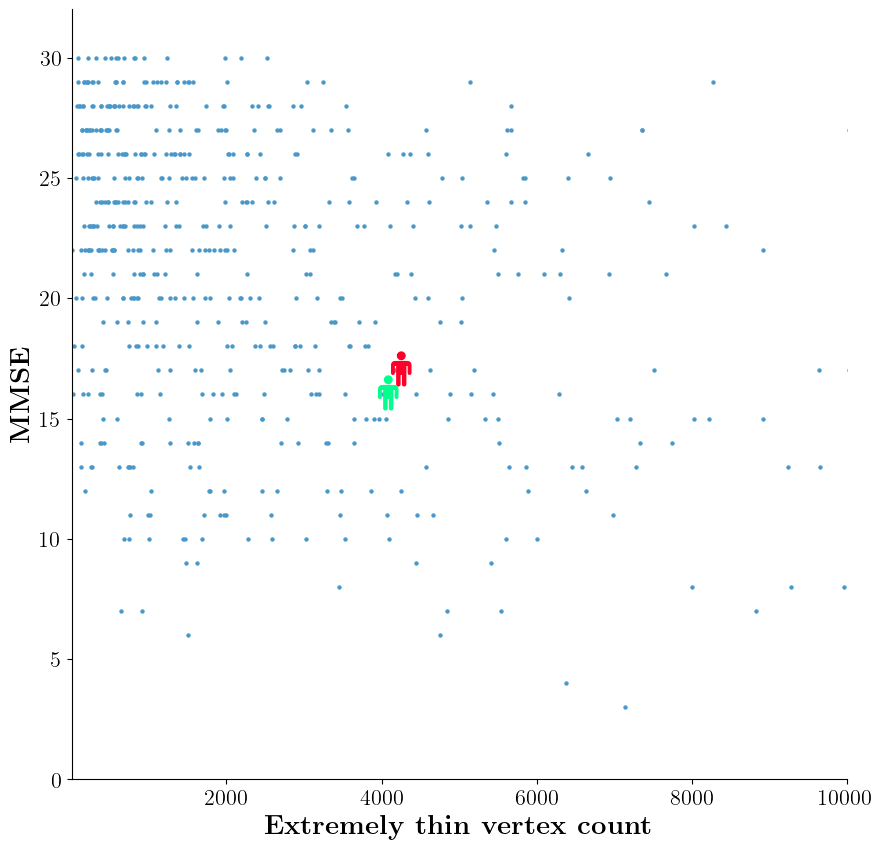

In [1164]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()
sample_df = sample_df[sample_df['split'] != 'Train']
x="extreme_thinning"
y="mmse"
xlims=[1,10000]
ylims=[0,32]

sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "CI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
ad_df = sample_df[sample_df['diagnosis'].isin(['AD', 'VAD'])]
ci_df = sample_df[sample_df['diagnosis'].isin(['CIND', 'VCIND'])]

# Calculate correlation
# rho, pval = spearmanr(sample_df["extreme_thinning"], sample_df["mmse"])
rho, pval = pearsonr(sample_df["extreme_thinning"], sample_df["mmse"])
print(rho, pval)

fig = plt.figure(figsize=(10, 10))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[:, :])

sns.scatterplot(data=sample_df, x=x, y=y, ax=ax, color=plt.cm.Blues(0.6), linewidths=0, s=10,)

for o, i in enumerate(sample_df.loc[[s1, s2]].index):
    ax.text(sample_df.loc[i, x], sample_df.loc[i, y], r"\faMale", 
            fontsize=26, color=plt.cm.gist_rainbow(o/2), ha='center', va='center')
    # ax.text(sample_df.loc[i, x], sample_df.loc[i, y], rf"\textbf{{{o}}}", 
    #         fontsize=12, color="white", ha='center', va='center')

# sns.kdeplot(data=sample_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Blues", plt.cm.Blues(np.linspace(0.05, 1, 256))), ax=ax, fill=True, levels=16, thresh=0.05)
# sns.kdeplot(data=ad_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Reds", plt.cm.Reds(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=ci_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Oranges", plt.cm.Oranges(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=healthy_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Greens", plt.cm.Greens(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{Extremely thin vertex count}", fontsize=20)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Add bold text with the correlation coefficient
# plt.figtext(0.15, 0.15, rf'\textbf{{Spearman rho = {rho:.2f}}}', 
#             fontsize=16, color='black', ha='left')
# message = rf'\textbf{{r = {rho:.2f}}}'
# if pval < 0.0001:
#     message = rf'{message} , \textbf{{p $<$ 0.0001}}'
# ax.text(0.05, 0.05, message, 
#         fontsize=16, color='black', ha='left', transform=ax.transAxes)

pass


-0.3725382041894656 1.8788096969815908e-21


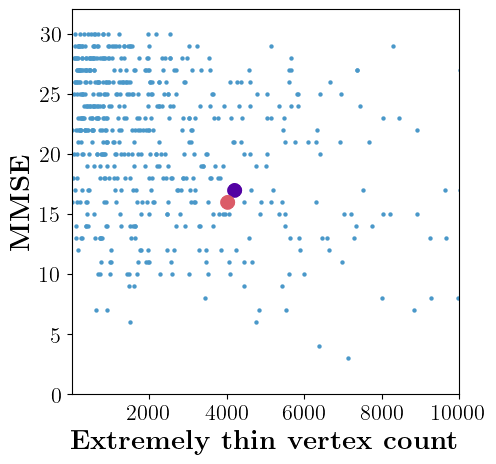

In [2633]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()
sample_df = sample_df[sample_df['split'] != 'Train']
x="extreme_thinning"
y="mmse"
xlims=[1,10000]
ylims=[0,32]

sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "CI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
ad_df = sample_df[sample_df['diagnosis'].isin(['AD', 'VAD'])]
ci_df = sample_df[sample_df['diagnosis'].isin(['CIND', 'VCIND'])]

# Calculate correlation
# rho, pval = spearmanr(sample_df["extreme_thinning"], sample_df["mmse"])
rho, pval = pearsonr(sample_df["extreme_thinning"], sample_df["mmse"])
print(rho, pval)

fig = plt.figure(figsize=(5, 5))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[:, :])

sns.scatterplot(data=sample_df, x=x, y=y, ax=ax, color=plt.cm.Blues(0.6), linewidths=0, s=10,)

for o, i in enumerate(sample_df.loc[[s1, s2]].index):
    ax.text(sample_df.loc[i, x], sample_df.loc[i, y], r"$\bullet$",
            fontsize=28, color=plt.cm.plasma((1 + 3*o)/7), ha='center', va='center')
    # ax.text(sample_df.loc[i, x], sample_df.loc[i, y], rf"\textbf{{{o}}}", 
    #         fontsize=12, color="white", ha='center', va='center')

# sns.kdeplot(data=sample_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Blues", plt.cm.Blues(np.linspace(0.05, 1, 256))), ax=ax, fill=True, levels=16, thresh=0.05)
# sns.kdeplot(data=ad_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Reds", plt.cm.Reds(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=ci_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Oranges", plt.cm.Oranges(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=healthy_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Greens", plt.cm.Greens(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# ax.spines['top'].set_visible(False)
# ax.spines['right'].set_visible(False)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{Extremely thin vertex count}", fontsize=20)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Add bold text with the correlation coefficient
# plt.figtext(0.15, 0.15, rf'\textbf{{Spearman rho = {rho:.2f}}}', 
#             fontsize=16, color='black', ha='left')
# message = rf'\textbf{{r = {rho:.2f}}}'
# if pval < 0.0001:
#     message = rf'{message} , \textbf{{p $<$ 0.0001}}'
# ax.text(0.05, 0.05, message, 
#         fontsize=16, color='black', ha='left', transform=ax.transAxes)

pass


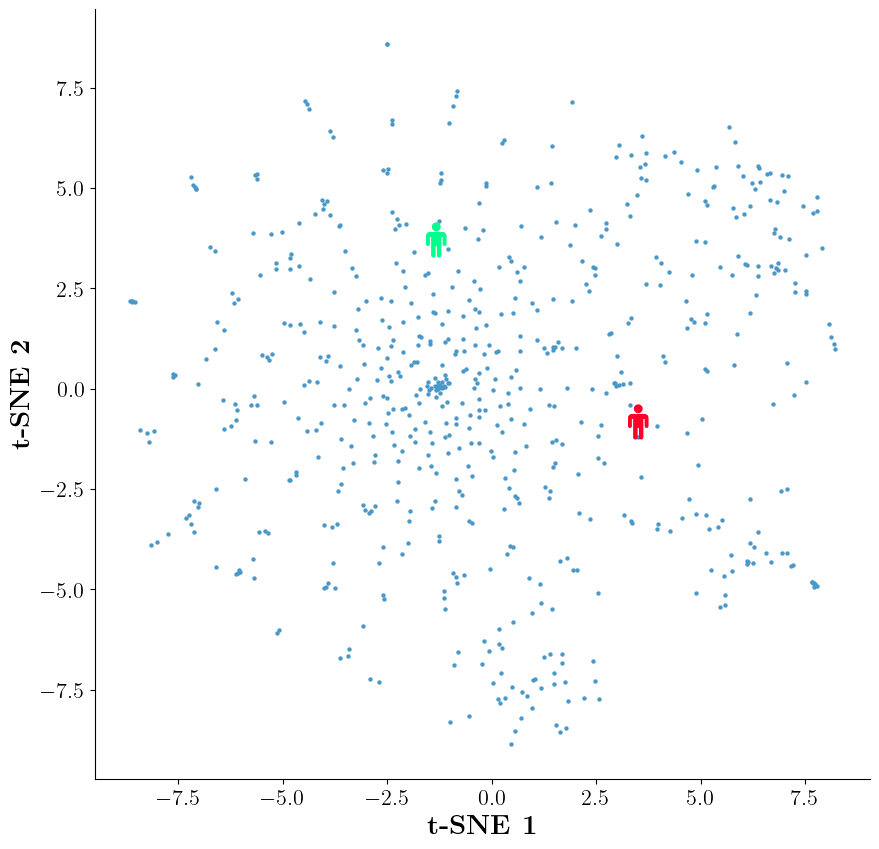

In [1165]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()
tmp_mask = sample_df['split'] != 'Train'

fig = plt.figure(figsize=(10, 10))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[:, :])

sns.scatterplot(x=tsne_of_AD_atrophy[:,0], y=tsne_of_AD_atrophy[:,1], ax=ax, color=plt.cm.Blues(0.6), linewidths=0, s=10,)

for o, i in enumerate([s1, s2]):
    ax.text(tsne_of_AD_atrophy[i,0], tsne_of_AD_atrophy[i,1], r"\faMale", 
            fontsize=26, color=plt.cm.gist_rainbow(o/2), ha='center', va='center')
#     # ax.text(sample_df.loc[i, x], sample_df.loc[i, y], rf"\textbf{{{o}}}", 
#     #         fontsize=12, color="white", ha='center', va='center')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# ax.set_xlim(xlims)
# ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{t-SNE 1}", fontsize=20)
ax.set_ylabel(r"\textbf{t-SNE 2}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

pass


### Visualizing deviations on group template

---

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 1min 29s, sys: 2.25 s, total: 1min 32s
Wall time: 1min 33s


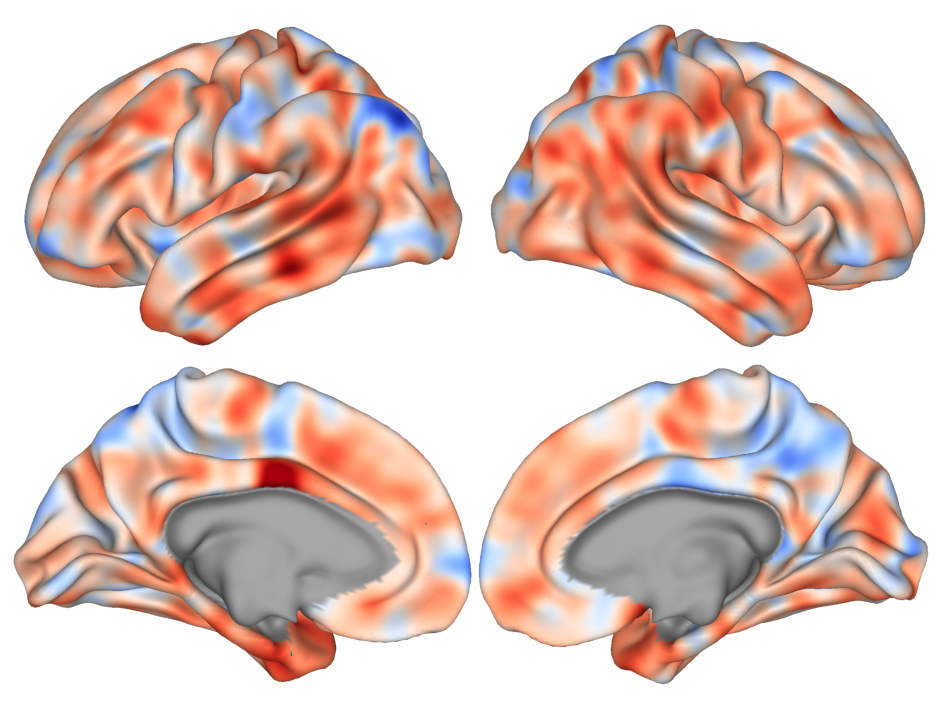

In [2636]:
%%time

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz1
# lims = np.percentile(signal,[2,98])
lims = [-4,4]
plot_left_right_surface_with_cerebro(signal, ax, clims=lims, show_colorbar=False, colormap=plt.cm.coolwarm_r)


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 1min 51s, sys: 2.96 s, total: 1min 54s
Wall time: 1min 54s


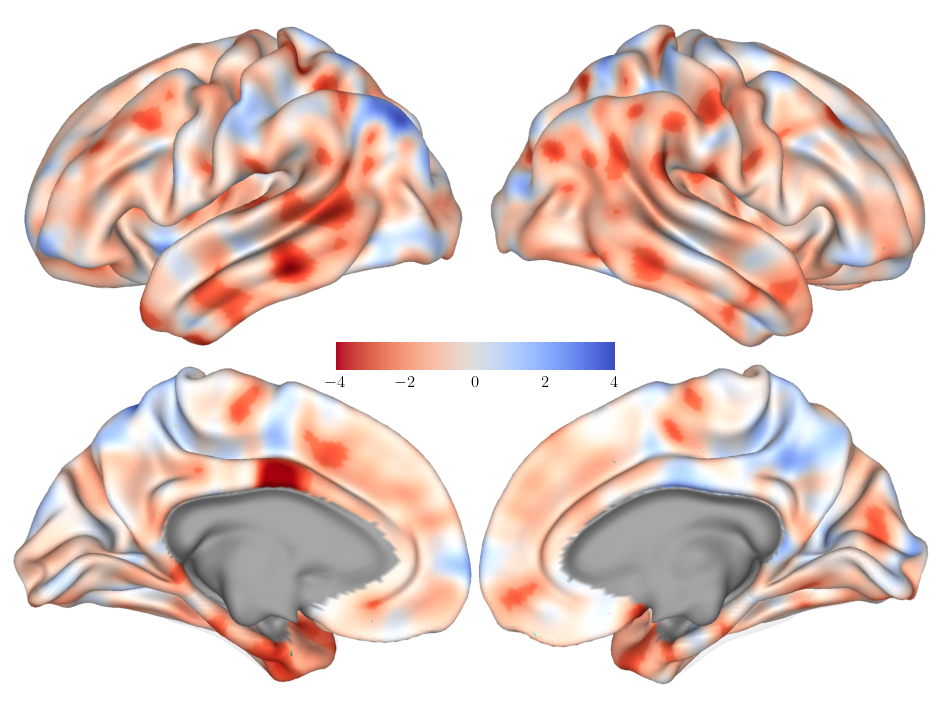

In [2647]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz1.copy()
cover = signal > z_threshold
lims = [-4, 4]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=plt.cm.coolwarm_r,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    cover=(cover).astype(float), cover_colormap=ListedColormap(['snow']), cover_alpha=0.15
)


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 1min 51s, sys: 2.88 s, total: 1min 54s
Wall time: 1min 54s


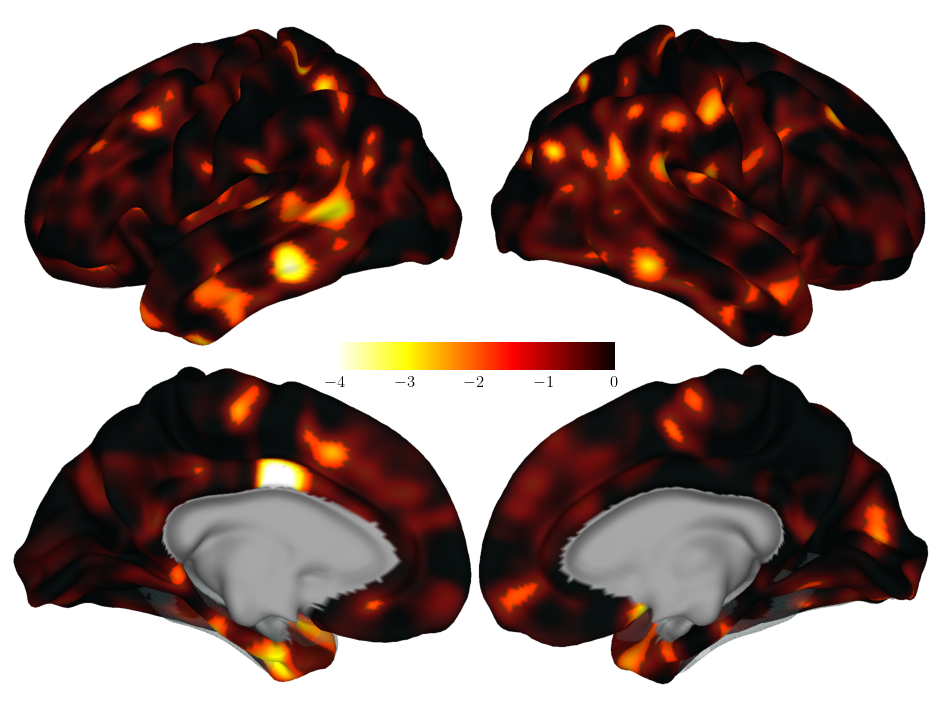

In [2646]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz1.copy()
cover = signal > z_threshold
lims = [-4, 0]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=plt.cm.hot_r,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.3
)


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 41.1 s, sys: 1.49 s, total: 42.6 s
Wall time: 47.4 s


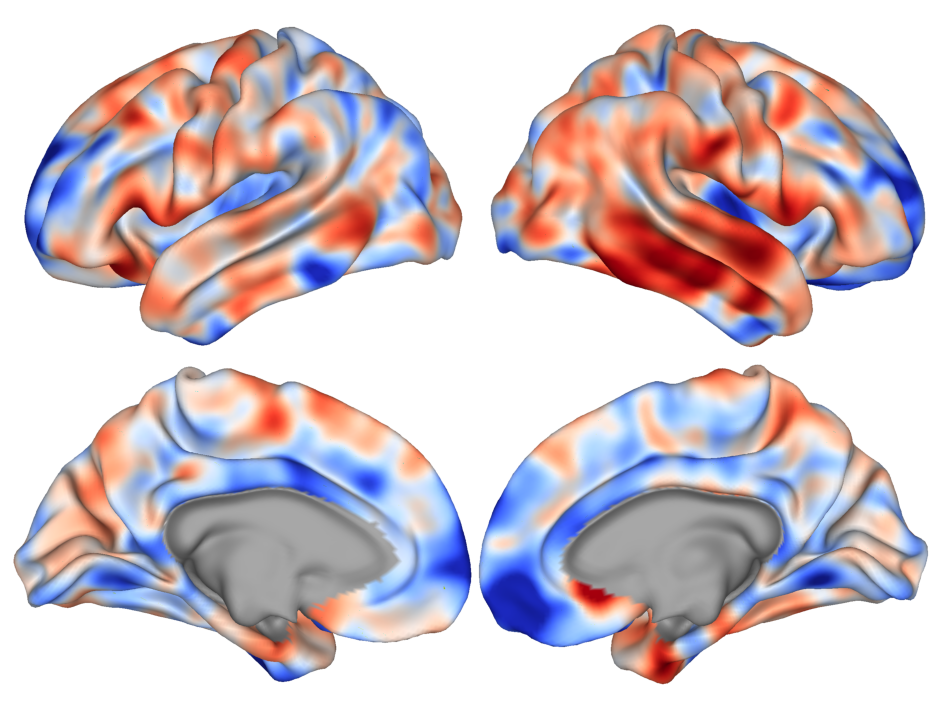

In [650]:
%%time

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz2
# lims = np.percentile(signal,[2,98])
lims = [-4,4]
plot_left_right_surface_with_cerebro(signal, ax, clims=lims, show_colorbar=False, colormap=plt.cm.coolwarm_r)


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 1min 51s, sys: 2.88 s, total: 1min 54s
Wall time: 1min 54s


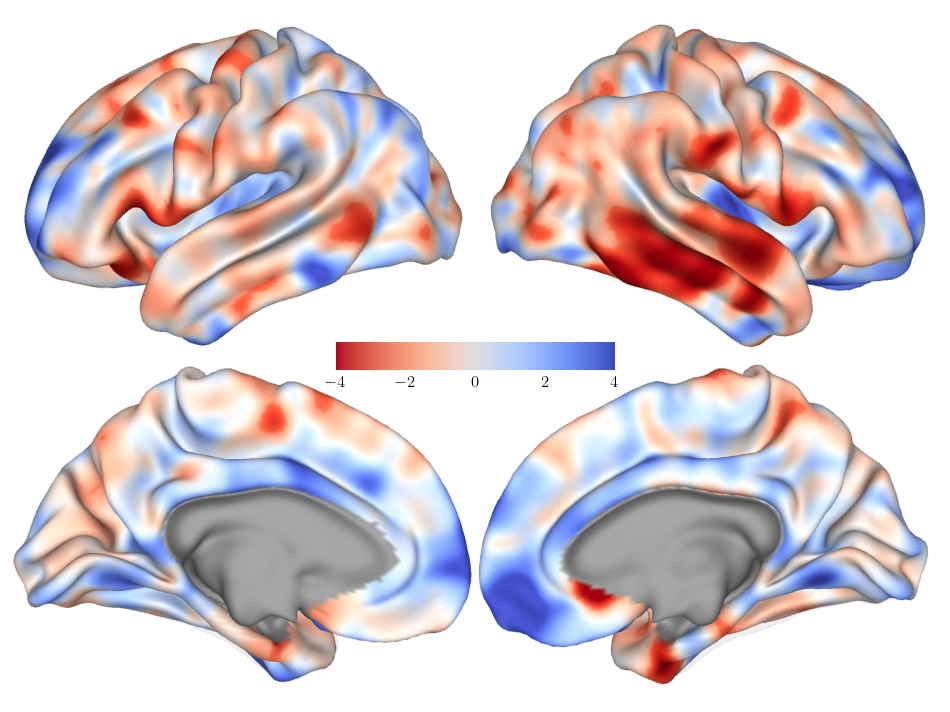

In [2649]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz2.copy()
cover = signal > z_threshold
lims = [-4, 4]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=plt.cm.coolwarm_r,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    cover=(cover).astype(float), cover_colormap=ListedColormap(['snow']), cover_alpha=0.15
)


In [886]:
z_threshold

-1.96

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 51.1 s, sys: 2.66 s, total: 53.8 s
Wall time: 56.9 s


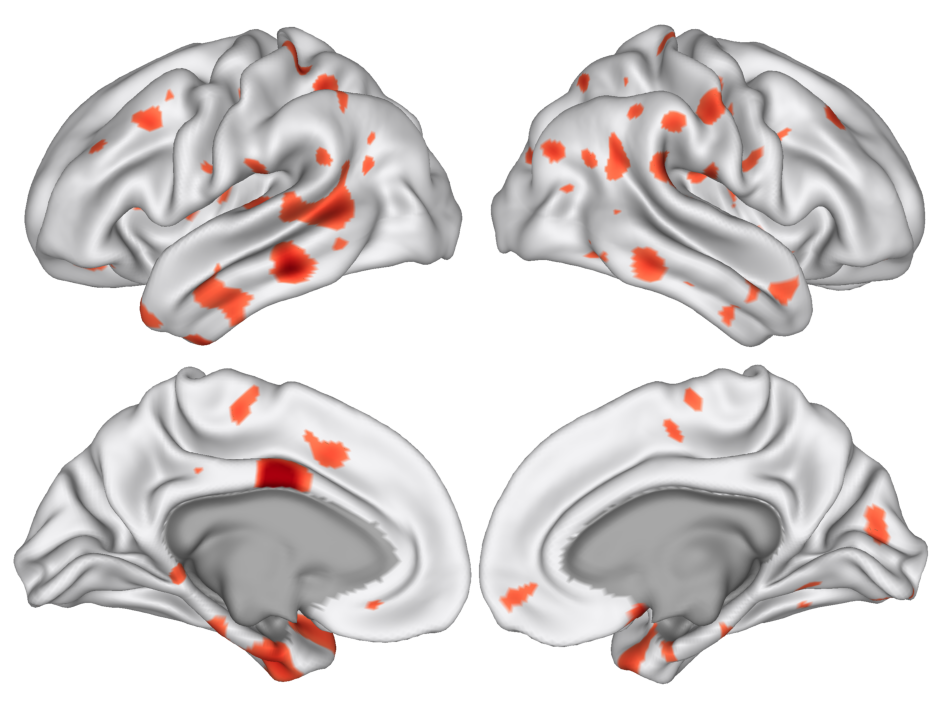

In [887]:
%%time

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz1.copy()
signal[signal > z_threshold] = 0
# lims = np.percentile(signal,[2,98])
lims = [-4,4]
plot_left_right_surface_with_cerebro(signal, ax, clims=lims, show_colorbar=False, colormap=plt.cm.coolwarm_r)


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 52.5 s, sys: 2.66 s, total: 55.2 s
Wall time: 59.6 s


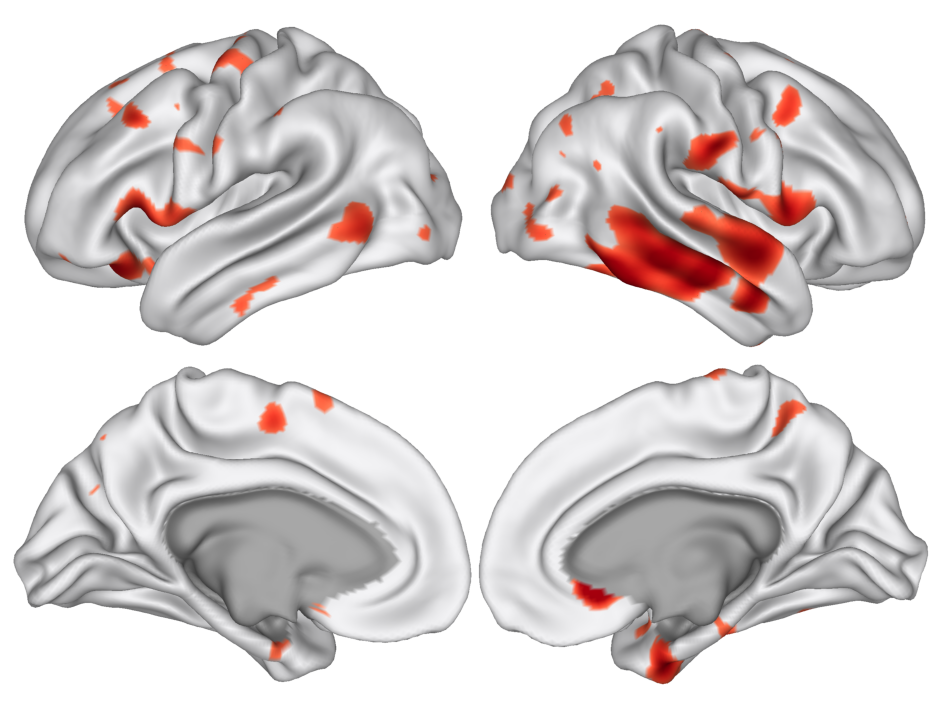

In [888]:
%%time

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz2.copy()
signal[signal > z_threshold] = 0
# lims = np.percentile(signal,[2,98])
lims = [-4,4]
plot_left_right_surface_with_cerebro(signal, ax, clims=lims, show_colorbar=False, colormap=plt.cm.coolwarm_r)


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 40.2 s, sys: 1.42 s, total: 41.6 s
Wall time: 46.5 s


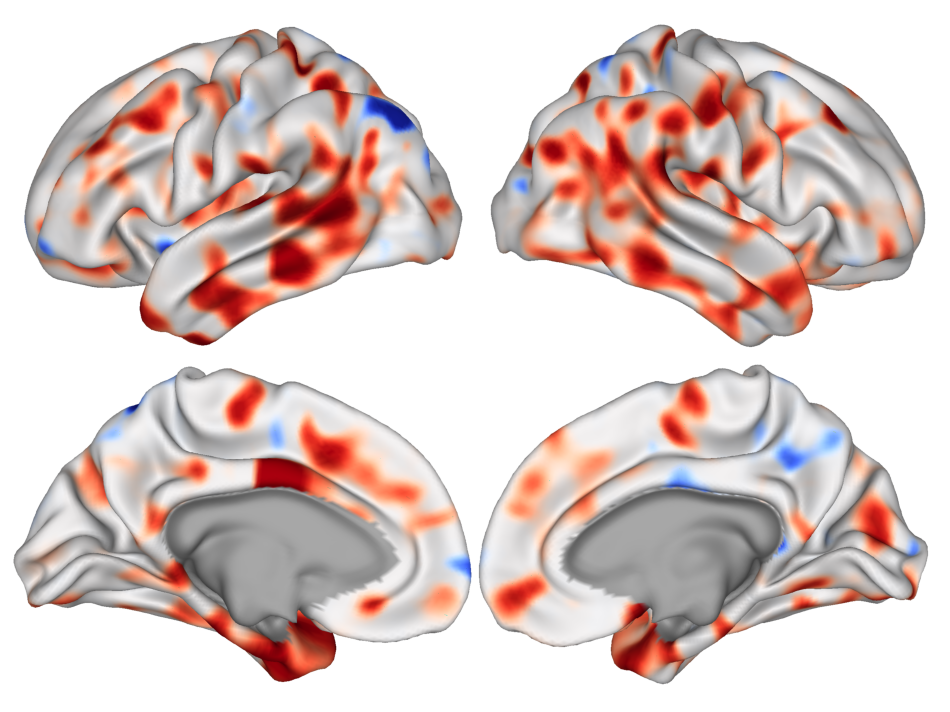

In [655]:
%%time
from matplotlib.colors import ListedColormap

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = stats.norm.cdf(hrz1) * 100
# lims = np.percentile(signal,[2,98])
lims = [0,100]
plot_left_right_surface_with_cerebro(signal, ax, clims=lims, show_colorbar=False, colormap=ListedColormap(plt.cm.coolwarm_r((((np.linspace(-1, 1, 200))**7)/2)+0.5)))


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 41.2 s, sys: 1.58 s, total: 42.8 s
Wall time: 46.8 s


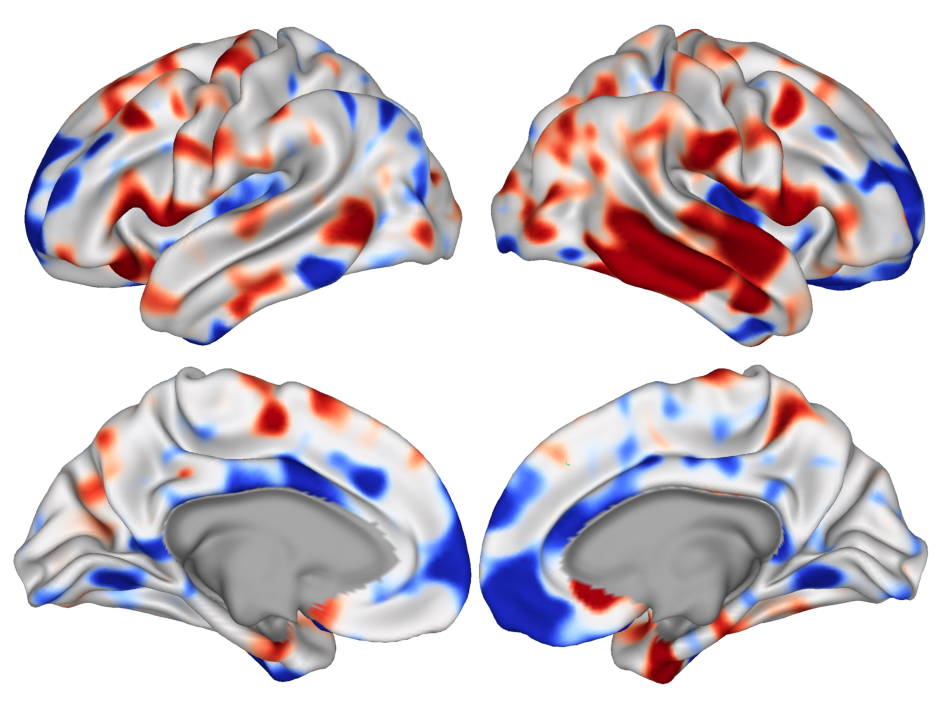

In [653]:
%%time
from matplotlib.colors import ListedColormap

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = stats.norm.cdf(hrz2) * 100
# lims = np.percentile(signal,[2,98])
lims = [0,100]
plot_left_right_surface_with_cerebro(signal, ax, clims=lims, show_colorbar=False, colormap=ListedColormap(plt.cm.coolwarm_r((((np.linspace(-1, 1, 200))**7)/2)+0.5)))


### Visualizing deviations on individual brains

---

Here, we'll use the resampled surfaces (native to fs-LR) to visualize native meshes with the statistics


In [1169]:
demography_extended_df_MACC.iloc[[s1, s2]][['subject_ID', 'sex', 'age', 'mmse', 'diagnosis', 'extreme_thinning']]

,subject_ID,sex,age,mmse,diagnosis,extreme_thinning
81,HD083,1,78.0,17.0,AD,4250
201,HD212,1,79.0,16.0,AD,4090


In [1170]:
f"/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/{demography_extended_df_MACC.iloc[s1]['subject_ID']}/lh.pial.32k_fs_LR.surf.gii"

'/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/HD083/lh.pial.32k_fs_LR.surf.gii'

In [1172]:
f"{main_dir}/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/{demography_extended_df_MACC.iloc[s1]['subject_ID']}/lh.pial.32k_fs_LR.surf.gii"

'/home/sina/storage/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/HD083/lh.pial.32k_fs_LR.surf.gii'

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 55.9 s, sys: 2.52 s, total: 58.5 s
Wall time: 1min 1s


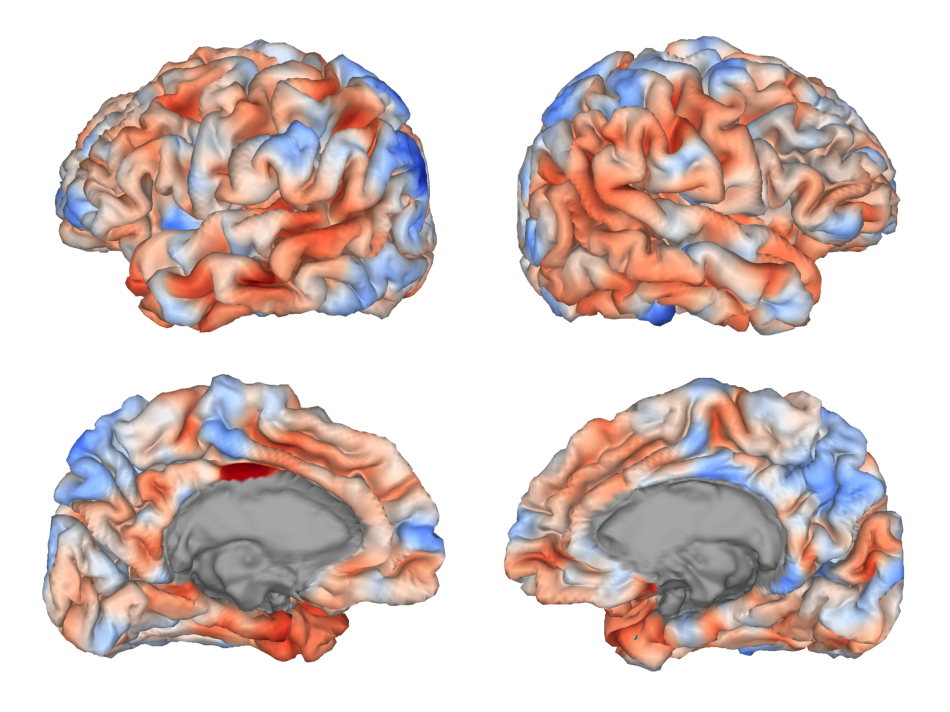

In [1175]:
%%time

individual_1_surface_files = [
    f"{main_dir}/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/{demography_extended_df_MACC.iloc[s1]['subject_ID']}/lh.pial.32k_fs_LR.surf.gii",
    f"{main_dir}/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/{demography_extended_df_MACC.iloc[s1]['subject_ID']}/rh.pial.32k_fs_LR.surf.gii",
]

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz1
# lims = np.percentile(signal,[2,98])
lims = [-4,4]
plot_left_right_surface_with_cerebro(signal, ax, clims=lims, show_colorbar=False, colormap=plt.cm.coolwarm_r, surface_files = individual_1_surface_files)


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 1min 53s, sys: 3.6 s, total: 1min 57s
Wall time: 1min 58s


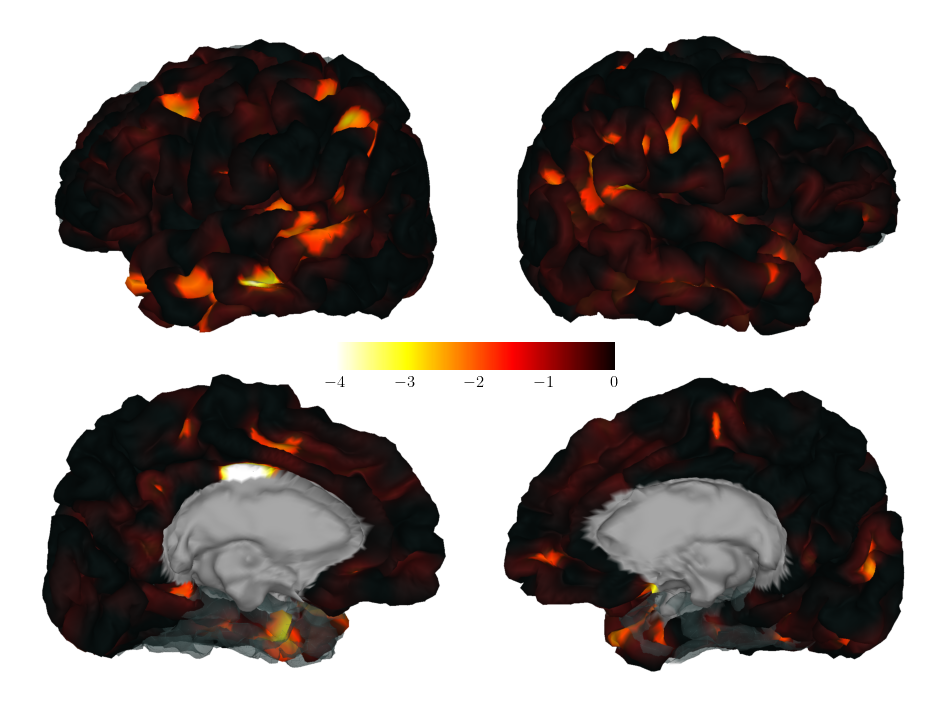

In [2651]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz1.copy()
cover = signal > z_threshold
lims = [-4, 0]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=plt.cm.hot_r, surface_files=individual_1_surface_files,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.4
)


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 1min 30s, sys: 2.82 s, total: 1min 33s
Wall time: 1min 34s


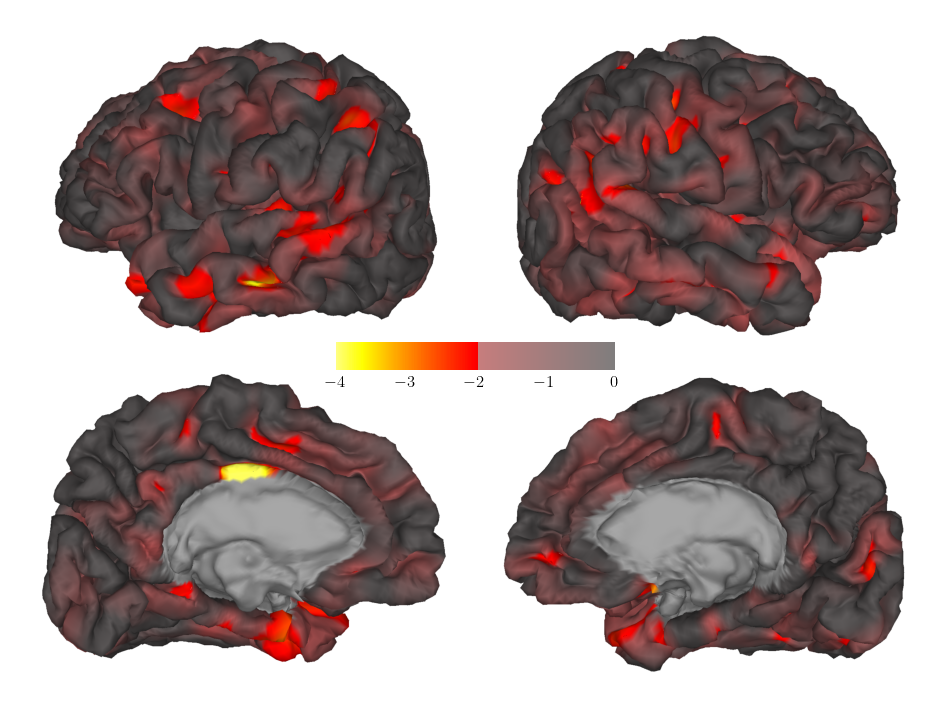

In [2682]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

cmap = plt.get_cmap('hot_r')
colors = cmap(np.linspace(0.05, 1., 400)**0.7)
mask_color = np.array([0.7, 0.7, 0.7, 1])
mask_power = 0.7
colors[205:] = ((1 - mask_power) * colors[205:]) + (mask_power * mask_color)
altered_cmap = ListedColormap(colors)

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz1.copy()
cover = signal > z_threshold
lims = [-4, 0]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=altered_cmap, surface_files=individual_1_surface_files,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    # cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.4
)


In [ ]:
1

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 56.2 s, sys: 2 s, total: 58.2 s
Wall time: 59.7 s


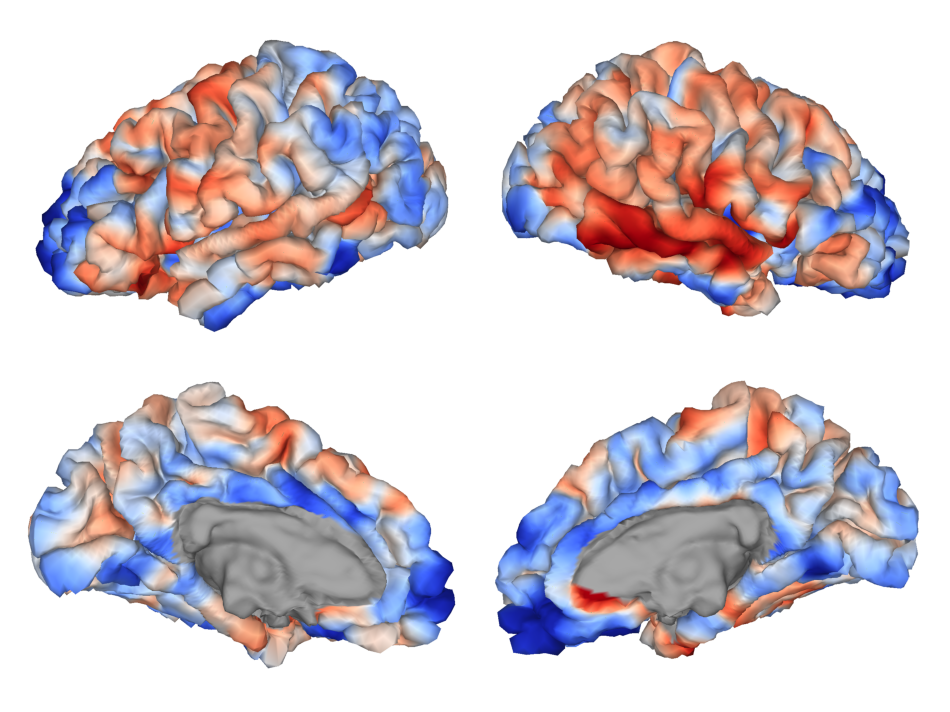

In [1176]:
%%time

individual_2_surface_files = [
    f"{main_dir}/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/{demography_extended_df_MACC.iloc[s2]['subject_ID']}/lh.pial.32k_fs_LR.surf.gii",
    f"{main_dir}/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/{demography_extended_df_MACC.iloc[s2]['subject_ID']}/rh.pial.32k_fs_LR.surf.gii",
]

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz2
# lims = np.percentile(signal,[2,98])
lims = [-4,4]
plot_left_right_surface_with_cerebro(signal, ax, clims=lims, show_colorbar=False, colormap=plt.cm.coolwarm_r, surface_files = individual_2_surface_files)


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 1min 53s, sys: 3.93 s, total: 1min 57s
Wall time: 1min 57s


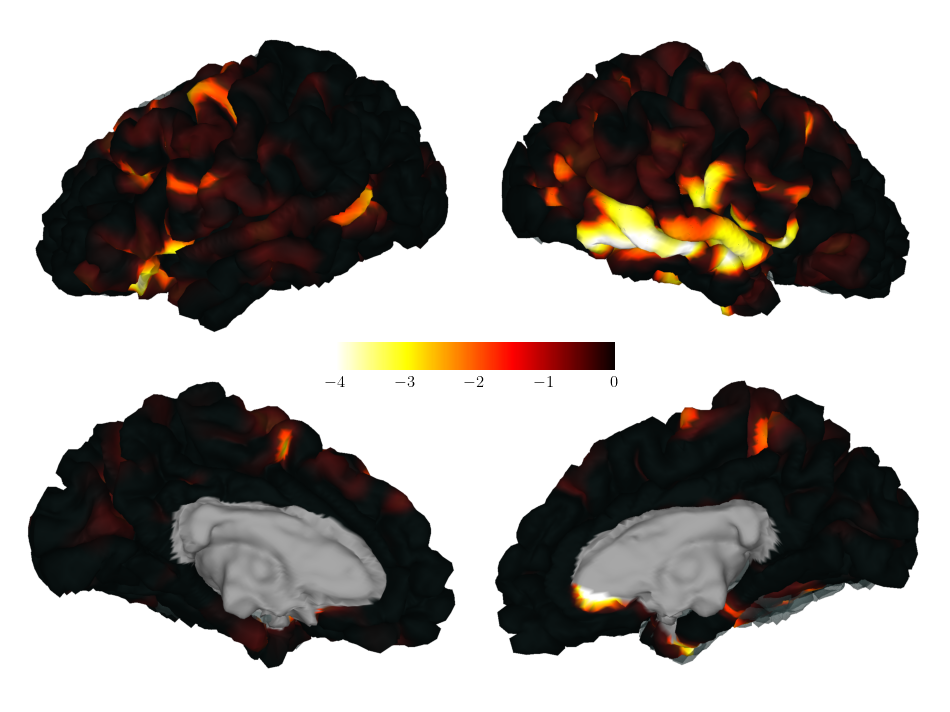

In [2656]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz2.copy()
cover = signal > z_threshold
lims = [-4, 0]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=plt.cm.hot_r, surface_files=individual_2_surface_files,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.4
)


In [2661]:
cmap = plt.get_cmap('hot_r')
colors = cmap(np.linspace(0, 1, 400))
colors[100:] += (1, 1, 1, 1)
colors[100:] /= 2
colors


array([[1.        , 1.        , 1.        , 1.        ],
       [1.        , 1.        , 1.        , 1.        ],
       [1.        , 1.        , 0.98455881, 1.        ],
       ...,
       [0.52594742, 0.5       , 0.5       , 1.        ],
       [0.5208    , 0.5       , 0.5       , 1.        ],
       [0.5208    , 0.5       , 0.5       , 1.        ]])

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 1min 30s, sys: 2.81 s, total: 1min 33s
Wall time: 1min 33s


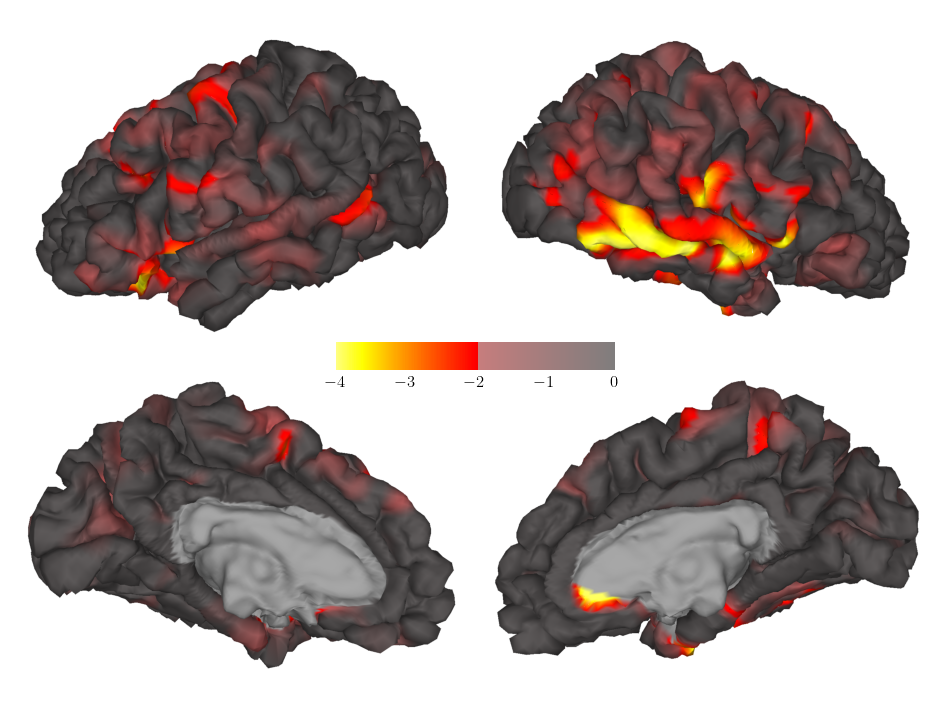

In [2683]:
%%time
from matplotlib.colors import ListedColormap

# difference in thickness normality between the healthy and AD cohort

cmap = plt.get_cmap('hot_r')
colors = cmap(np.linspace(0.05, 1., 400)**0.7)
mask_color = np.array([0.7, 0.7, 0.7, 1])
mask_power = 0.7
colors[205:] = ((1 - mask_power) * colors[205:]) + (mask_power * mask_color)
altered_cmap = ListedColormap(colors)

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz2.copy()
cover = signal > z_threshold
lims = [-4, 0]
plot_left_right_surface_with_cerebro(
    signal, ax, clims=lims, show_colorbar=True, colormap=altered_cmap, surface_files=individual_2_surface_files,
    # cover=(~nonparametric_significance_mask).astype(float), cover_colormap=plt.cm.gray, cover_alpha=0.1
    # cover=(cover).astype(float), cover_colormap=ListedColormap(['darkslategray']), cover_alpha=0.4
)


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 54.8 s, sys: 1.46 s, total: 56.3 s
Wall time: 58 s


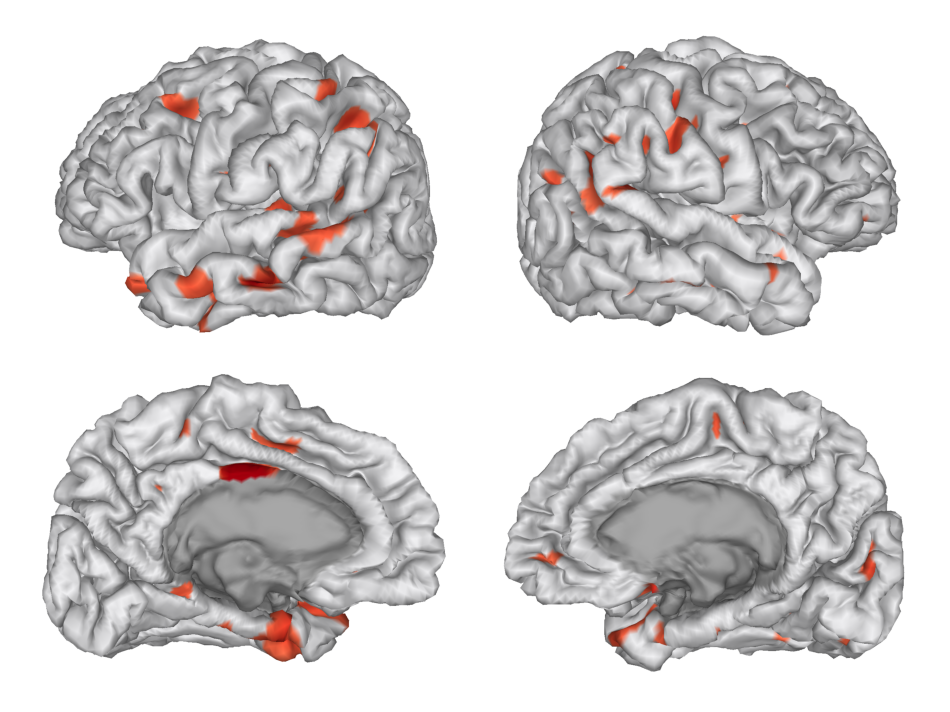

In [1177]:
%%time

individual_1_surface_files = [
    f"{main_dir}/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/{demography_extended_df_MACC.iloc[s1]['subject_ID']}/lh.pial.32k_fs_LR.surf.gii",
    f"{main_dir}/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/{demography_extended_df_MACC.iloc[s1]['subject_ID']}/rh.pial.32k_fs_LR.surf.gii",
]

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz1
signal[signal > z_threshold] = 0
# lims = np.percentile(signal,[2,98])
lims = [-4,4]
plot_left_right_surface_with_cerebro(signal, ax, clims=lims, show_colorbar=False, colormap=plt.cm.coolwarm_r, surface_files = individual_1_surface_files)


No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified

No protocol specified



CPU times: user 56.6 s, sys: 2.15 s, total: 58.8 s
Wall time: 1min 4s


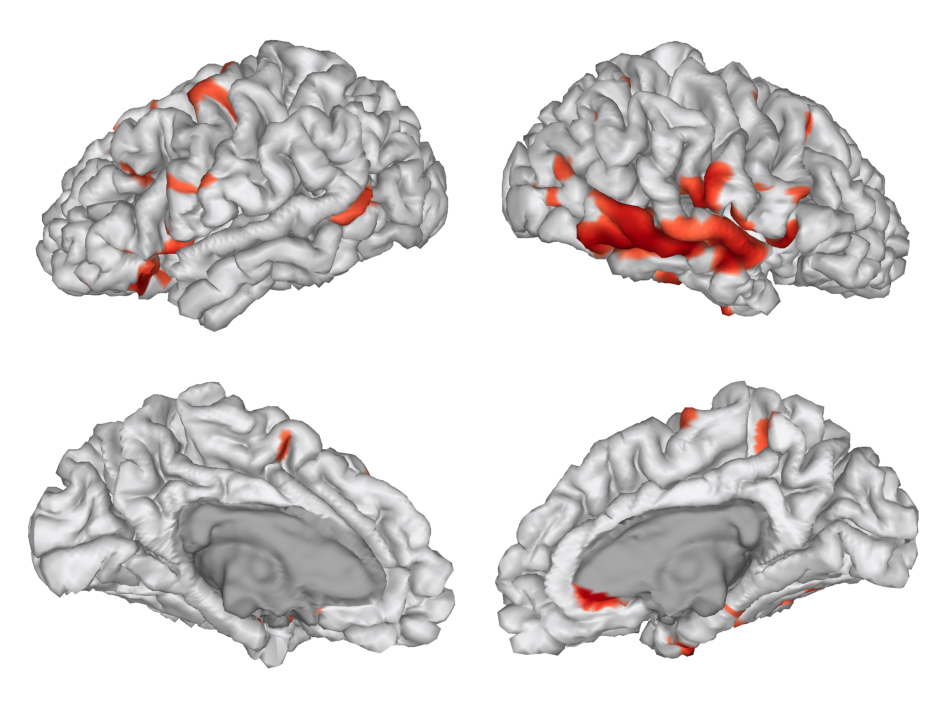

In [1178]:
%%time

individual_2_surface_files = [
    f"{main_dir}/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/{demography_extended_df_MACC.iloc[s2]['subject_ID']}/lh.pial.32k_fs_LR.surf.gii",
    f"{main_dir}/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/{demography_extended_df_MACC.iloc[s2]['subject_ID']}/rh.pial.32k_fs_LR.surf.gii",
]

# Create a figure and an axis
fig, ax = plt.subplots(figsize=(12, 9))

signal = hrz2
signal[signal > z_threshold] = 0
# lims = np.percentile(signal,[2,98])
lims = [-4,4]
plot_left_right_surface_with_cerebro(signal, ax, clims=lims, show_colorbar=False, colormap=plt.cm.coolwarm_r, surface_files = individual_2_surface_files)


First, the results need to be mapped from fs_LR back to fsaverage, and then from fsaverage to fsnative.

Then, that could be projected on the individual's suface mesh.

In [811]:
hrz1[None,:].shape

(1, 59412)

In [822]:
# cifti.shape
ba = cifti.header.get_axis(1)


In [823]:
hrz1.shape

(59412,)

In [828]:
%%time
# store individual subject outputs as dscalar files
cifti=nib.load(css._sample_cifti_dscalar)

data_holder = np.zeros((1,91282)) * np.nan
data_holder[0,:59412] = hrz1
cifti2_img = nib.Cifti2Image(
    dataobj=data_holder,
    header=nib.cifti2.Cifti2Header.from_axes((nib.cifti2.ScalarAxis([f"Subject#{s1}_deviations"]), cifti.header.get_axis(1))),
)
out_file=ensure_dir(f"/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject#{s1}_deviations.dscalar.nii")
nib.save(cifti2_img, out_file)
print(out_file)


/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject#81_deviations.dscalar.nii
CPU times: user 1.71 s, sys: 30.6 ms, total: 1.74 s
Wall time: 1.93 s


In [829]:
%%time
# store individual subject outputs as dscalar files
cifti=nib.load(css._sample_cifti_dscalar)

data_holder = np.zeros((1,91282)) * np.nan
data_holder[0,:59412] = hrz2
cifti2_img = nib.Cifti2Image(
    dataobj=data_holder,
    header=nib.cifti2.Cifti2Header.from_axes((nib.cifti2.ScalarAxis([f"Subject#{s1}_deviations"]), cifti.header.get_axis(1))),
)
out_file=ensure_dir(f"/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject#{s2}_deviations.dscalar.nii")
nib.save(cifti2_img, out_file)
print(out_file)


/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject#201_deviations.dscalar.nii
CPU times: user 1.7 s, sys: 59.2 ms, total: 1.76 s
Wall time: 1.97 s


In [831]:
%%bash

# separate left and right metrics

wb_command -cifti-separate \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject#81_deviations.dscalar.nii" \
     COLUMN -metric CORTEX_LEFT \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/fs_LR.L.Subject#81_deviations.gii"

wb_command -cifti-separate \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject#81_deviations.dscalar.nii" \
     COLUMN -metric CORTEX_RIGHT \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/fs_LR.R.Subject#81_deviations.gii"


wb_command -cifti-separate \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject#201_deviations.dscalar.nii" \
     COLUMN -metric CORTEX_LEFT \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/fs_LR.L.Subject#201_deviations.gii"

wb_command -cifti-separate \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject#201_deviations.dscalar.nii" \
     COLUMN -metric CORTEX_RIGHT \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/fs_LR.R.Subject#201_deviations.gii"


In [832]:
%%bash

# now convert to fsaverage

wb_command -metric-resample \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/fs_LR.L.Subject#81_deviations.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fs_LR-deformed_to-fsaverage.L.sphere.32k_fs_LR.surf.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fsaverage_std_sphere.L.164k_fsavg_L.surf.gii" \
    ADAP_BARY_AREA \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/lh.fsaverage.Subject#81_deviations.gii" \
    -area-metrics \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fs_LR.L.midthickness_va_avg.32k_fs_LR.shape.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fsaverage.L.midthickness_va_avg.164k_fsavg_L.shape.gii"

wb_command -metric-resample \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/fs_LR.R.Subject#81_deviations.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fs_LR-deformed_to-fsaverage.R.sphere.32k_fs_LR.surf.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fsaverage_std_sphere.R.164k_fsavg_R.surf.gii" \
    ADAP_BARY_AREA \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/rh.fsaverage.Subject#81_deviations.gii" \
    -area-metrics \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fs_LR.R.midthickness_va_avg.32k_fs_LR.shape.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fsaverage.R.midthickness_va_avg.164k_fsavg_R.shape.gii"


wb_command -metric-resample \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/fs_LR.L.Subject#201_deviations.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fs_LR-deformed_to-fsaverage.L.sphere.32k_fs_LR.surf.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fsaverage_std_sphere.L.164k_fsavg_L.surf.gii" \
    ADAP_BARY_AREA \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/lh.fsaverage.Subject#201_deviations.gii" \
    -area-metrics \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fs_LR.L.midthickness_va_avg.32k_fs_LR.shape.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fsaverage.L.midthickness_va_avg.164k_fsavg_L.shape.gii"

wb_command -metric-resample \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/fs_LR.R.Subject#201_deviations.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fs_LR-deformed_to-fsaverage.R.sphere.32k_fs_LR.surf.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fsaverage_std_sphere.R.164k_fsavg_R.surf.gii" \
    ADAP_BARY_AREA \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/rh.fsaverage.Subject#201_deviations.gii" \
    -area-metrics \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fs_LR.R.midthickness_va_avg.32k_fs_LR.shape.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fsaverage.R.midthickness_va_avg.164k_fsavg_R.shape.gii"


In [1189]:
%%bash

# now directly convert to fsnative using BARYCENTRIC

wb_command -metric-resample \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/fs_LR.L.Subject#81_deviations.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fs_LR-deformed_to-fsaverage.L.sphere.32k_fs_LR.surf.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/HD083/lh.sphere.reg.fsnative_to_fsaverage.surf.gii" \
    BARYCENTRIC \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/lh.fsnative.Subject81_deviations.func.gii" \

wb_command -metric-resample \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/fs_LR.R.Subject#81_deviations.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fs_LR-deformed_to-fsaverage.R.sphere.32k_fs_LR.surf.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/HD083/rh.sphere.reg.fsnative_to_fsaverage.surf.gii" \
    BARYCENTRIC \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/rh.fsnative.Subject81_deviations.func.gii" \


wb_command -metric-resample \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/fs_LR.L.Subject#201_deviations.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fs_LR-deformed_to-fsaverage.L.sphere.32k_fs_LR.surf.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/HD212/lh.sphere.reg.fsnative_to_fsaverage.surf.gii" \
    BARYCENTRIC \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/lh.fsnative.Subject201_deviations.func.gii" \

wb_command -metric-resample \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/fs_LR.R.Subject#201_deviations.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/HCPpipelines/global/templates/standard_mesh_atlases/resample_fsaverage/fs_LR-deformed_to-fsaverage.R.sphere.32k_fs_LR.surf.gii" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/thickness_fs_LR/Baseline/HD212/rh.sphere.reg.fsnative_to_fsaverage.surf.gii" \
    BARYCENTRIC \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/rh.fsnative.Subject201_deviations.func.gii" \


In [1193]:
%%bash
source ~/.bashrc

which mri_surf2vol

/apps/freesurfer/6.0.0/bin/mri_surf2vol


In [1213]:
%%bash

# convert the surface deviation metric to a volumetric image
source ~/.bashrc # to load freesurfer6

export SUBJECTS_DIR="/mnt/isilon/CSC2/Yeolab/Data/MACC/process/recon_all_CBIG/Baseline"

mri_surf2vol \
    --subject HD083 \
    --so "/mnt/isilon/CSC2/Yeolab/Data/MACC/process/recon_all_CBIG/Baseline/HD083/surf/lh.white" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/lh.fsnative.Subject81_deviations.func.gii" \
    --so "/mnt/isilon/CSC2/Yeolab/Data/MACC/process/recon_all_CBIG/Baseline/HD083/surf/rh.white" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/rh.fsnative.Subject81_deviations.func.gii" \
    --o "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject_81_deviations.nii.gz"

mri_surf2vol \
    --subject HD212 \
    --so "/mnt/isilon/CSC2/Yeolab/Data/MACC/process/recon_all_CBIG/Baseline/HD212/surf/lh.white" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/lh.fsnative.Subject201_deviations.func.gii" \
    --so "/mnt/isilon/CSC2/Yeolab/Data/MACC/process/recon_all_CBIG/Baseline/HD212/surf/rh.white" \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/rh.fsnative.Subject201_deviations.func.gii" \
    --o "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject_201_deviations.nii.gz"



gdiagno = -1
Loading /mnt/isilon/CSC2/Yeolab/Data/MACC/process/recon_all_CBIG/Baseline/HD083/mri/ribbon.mgz
INFO: writing output volume to /mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject_81_deviations.nii.gz
gdiagno = -1
Loading /mnt/isilon/CSC2/Yeolab/Data/MACC/process/recon_all_CBIG/Baseline/HD212/mri/ribbon.mgz
INFO: writing output volume to /mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject_201_deviations.nii.gz


In [1214]:
%%bash

# also invert the map
# source ~/.bashrc # to load freesurfer6

fslmaths \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject_81_deviations.nii.gz" \
    -mul -1 \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject_81_deviations_inverted.nii.gz"

fslmaths \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject_201_deviations.nii.gz" \
    -mul -1 \
    "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/data/MACC/normative_deviations/Subject_201_deviations_inverted.nii.gz"

    # --targ input_image.nii.gz \


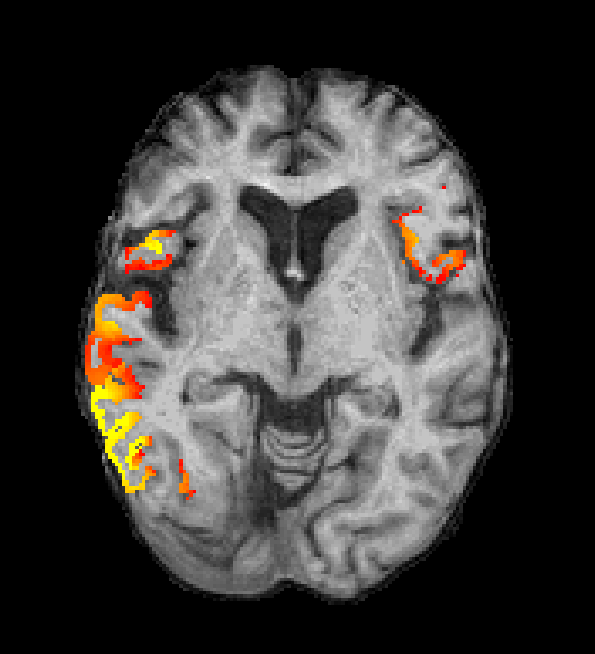

In [1216]:
# fsleyes screenshop of subject 212
from PIL import Image
from IPython.display import display

# Load the image
image_path = "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/Screenshots/HD212.png"
img = Image.open(image_path)

# Display the image
display(img)

In [ ]:
# Same slices for both individuals

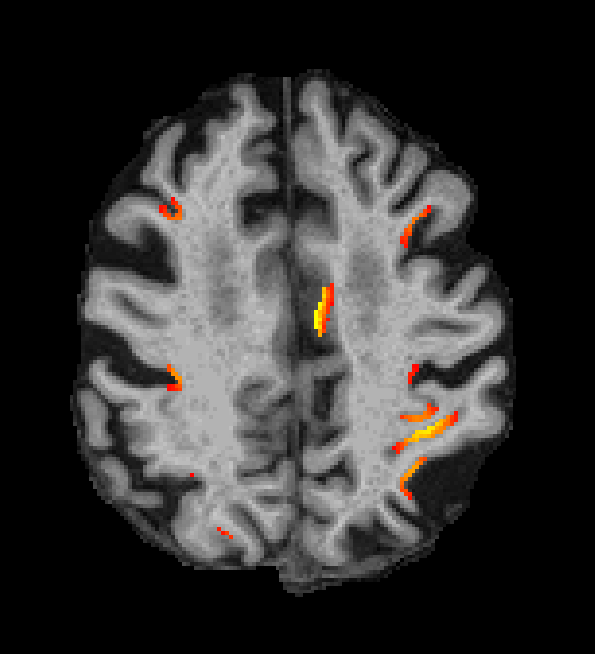

In [1217]:
# fsleyes screenshop of subject 212
from PIL import Image
from IPython.display import display

# Load the image
image_path = "/mnt/isilon/CSC1/Yeolab/Users/sina/Normative_Modeling/Screenshots/HD083.png"
img = Image.open(image_path)

# Display the image
display(img)

In [ ]:
# freeview command used
freeview -v /mnt/isilon/CSC2/Yeolab/Data/MACC/process/recon_all_CBIG/Baseline/HD212/mri/brain.mgz -f /mnt/isilon/CSC2/Yeolab/Data/MACC/process/recon_all_CBIG/Baseline/HD212/surf/lh.pial:overlay=/home/sina/storage/Normative_Modeling/data/MACC/normative_deviations/lh.fsnative.Subject201_deviations.func.gii -f /mnt/isilon/CSC2/Yeolab/Data/MACC/process/recon_all_CBIG/Baseline/HD212/surf/rh.pial:overlay=/home/sina/storage/Normative_Modeling/data/MACC/normative_deviations/rh.fsnative.Subject201_deviations.func.gii -f /mnt/isilon/CSC2/Yeolab/Data/MACC/process/recon_all_CBIG/Baseline/HD212/surf/lh.white -f /mnt/isilon/CSC2/Yeolab/Data/MACC/process/recon_all_CBIG/Baseline/HD212/surf/rh.white


## Comparing to simple approaches

---

In [239]:
# Let's limit the evaluations to NCI, CIND, and AD (not to complicate findings by between diagnosis differences)
study_mask = demography_extended_df_MACC['diagnosis'].isin(['NCI', 'CIND', 'AD'])


In [431]:
study_ad_mask = (demography_extended_df_MACC['diagnosis'].isin(['AD'])).copy().reset_index(drop=True)
study_hc_mask = (demography_extended_df_MACC['diagnosis'].isin(['NCI'])).copy().reset_index(drop=True)
study_mc_mask = (demography_extended_df_MACC['diagnosis'].isin(['CIND',])).copy().reset_index(drop=True)


In [459]:
# Function to compute several pearson correlations
def evaluate_association(metric1, metric2):
    # normalize metrics
    metric1_norm = (metric1 - metric1.mean()) / metric1.std()
    metric2_norm = (metric2 - metric2.mean(1)[:, None]) / metric2.std(1)[:, None]
    # Correlation is the dot product of normalized metrics
    association = metric2_norm.dot(metric1_norm)/metric1_norm.shape[0]
    return association


#### Mean thickness normative deviation

In [528]:
sigmoid = lambda x: 1/(1 + np.exp(-x))

# A function to automatically generate the high-resolution normative range for a set of parameters
def get_query_thickness_norm_at_age(query, age_of_interest, sex_of_interest=0):
    n_kernel = N_kernels
    # sex was flipped in model training
    # sex_of_interest = - sex_of_interest # alternatively, replacing isel with sel should solve the issue in a more elegant way
    
    # fixed B-spline
    age_min=5
    age_max=100
    num_knots = 3
    patsy_knots = np.linspace(age_min, age_max, num_knots)[1:-1]
    # site_of_interest = 2 # HCP Aging

    prediction_B_spline_age = patsy.dmatrix(
        "bs(xi, knots=knots, degree=3, include_intercept=True) - 1",
        {
            "xi": xr.DataArray([age_min, age_of_interest, age_max], dims=["obs_id"]),
            "knots": patsy_knots
        }
    )[1]
    
    # reduce to a particular number of kernels
    kernel_posterior_means_subset = kernel_posterior_means.isel(kernel=range(n_kernel))

    kernels_y_ppc_mu_mean = (
        kernel_posterior_means_subset['intercept_sex'].sel(sex=sex_of_interest) +
        kernel_posterior_means_MACC['intercept_site'].isel(site=0) +
        xr.dot(
            xr.DataArray(np.asarray(prediction_B_spline_age), dims=["splines"]),
            kernel_posterior_means_subset['w_age']
        )
    ) * xr.DataArray(kernel_stds[:n_kernel], dims=["kernel"]) + xr.DataArray(kernel_means[:n_kernel], dims=["kernel"])
    
    feature_encoding = query.dot(connectome_kernel_eigenvectors[:, :n_kernel])

    # high_resolution_mean_thickness_of_interest = np.array(kernels_y_ppc_mu_mean).dot(connectome_kernel_eigenvectors[:,:n_kernel].T)
    query_mean_thickness_of_interest = np.array(kernels_y_ppc_mu_mean).dot(feature_encoding.T)
    
    # reduce to a particular number of kernels
    rho_kernel_posterior_means_subset = rho_kernel_posterior_means.isel(kernel_pair=np.where(selected_pair_mask)[0])
    
    rho_ppc_mean = 2 * sigmoid(
        rho_kernel_posterior_means_subset['intercept_sex_rho'].sel(sex=sex_of_interest).data +
        rho_kernel_posterior_means_MACC['intercept_site_rho'].isel(site=0).data +
        xr.DataArray(np.asarray(prediction_B_spline_age), dims=["splines"]).dot(
            rho_kernel_posterior_means_subset['w_age_rho']
        ).data
    ) - 1

    kernels_y_ppc_sigma_mean = (
        kernel_posterior_means_subset['error_sex'].sel(sex=sex_of_interest) +
        kernel_posterior_means_MACC['error_site'].isel(site=0) +
        xr.dot(
            xr.DataArray(np.asarray(prediction_B_spline_age), dims=["splines"]),
            kernel_posterior_means_subset['w_error_age']
        )
    ) * xr.DataArray(kernel_stds[:n_kernel], dims=["kernel"])

    sparse_correlations = sparse_filler_N_kernels_masked.copy()
    sparse_correlations.data = rho_ppc_mean
    sparse_correlations = (sparse_correlations + sparse_correlations.T)
    sparse_correlations.setdiag(1)
    sparse_correlations = sparse_correlations.tocsr()[:n_kernel, :n_kernel]
    
    encoded_y_ppc_sigma_mean = np.multiply(feature_encoding, np.array(kernels_y_ppc_sigma_mean))

    query_std_thickness_of_interest = np.power(
        np.multiply(
            encoded_y_ppc_sigma_mean,
            sparse_correlations.dot(encoded_y_ppc_sigma_mean.T).T,
        ).sum(1),
        0.5
    )
    
    return query_mean_thickness_of_interest, query_std_thickness_of_interest



In [547]:
# mean thickness query
query = (np.ones((1, 59412))/59412)

normative_moments_of_average_thickness_MACC = np.array([
    get_query_thickness_norm_at_age(
        query,
        age_of_interest=demography_extended_df_MACC.iloc[i]["age"],
        sex_of_interest=demography_extended_df_MACC.iloc[i]["sex"]
    ) for i in tqdm(range(674))
])


  0%|          | 0/674 [00:00<?, ?it/s]

In [551]:
normative_mean_of_average_thickness_MACC = normative_moments_of_average_thickness_MACC[:, 0, 0]
normative_std_of_average_thickness_MACC = normative_moments_of_average_thickness_MACC[:, 1, 0]


In [552]:
normative_mean_thickness_zscore_MACC = (all_thickness_data_MACC.mean(1) - normative_mean_of_average_thickness_MACC) / normative_std_of_average_thickness_MACC


0.3128614380427366 8.998335959086101e-14


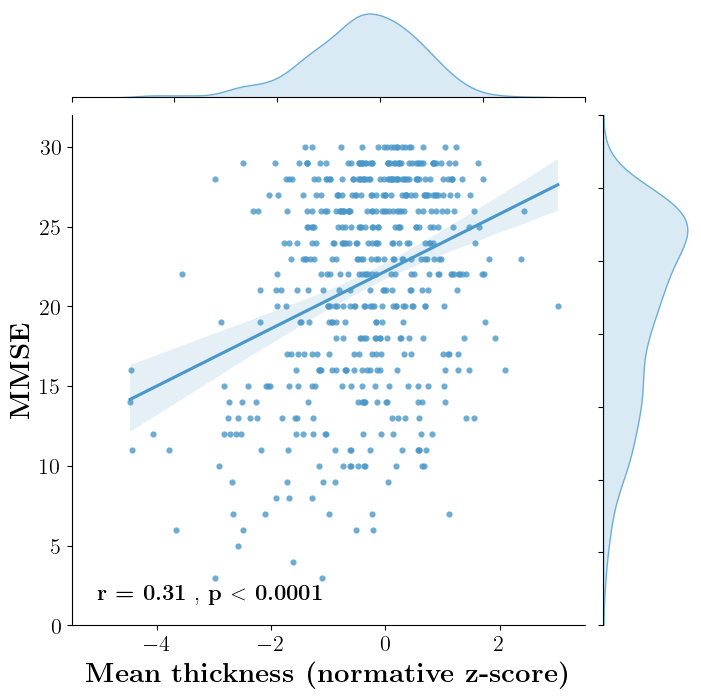

In [606]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()[study_mask]
# sample_df = sample_df[sample_df['split'] != 'Train']
x="mean_thickness_norm_z"
y="mmse"
xlims=[-5.5,3.5]
ylims=[0,32]

sample_df["mean_thickness_norm_z"] = normative_mean_thickness_zscore_MACC[study_mask]


sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "CI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
# ad_df = sample_df[sample_df['diagnosis'].isin(['AD', 'VAD'])]
# mci_df = sample_df[sample_df['diagnosis'].isin(['CIND', 'VCIND'])]
ad_df = sample_df[sample_df['diagnosis'].isin(['AD',])]
mci_df = sample_df[sample_df['diagnosis'].isin(['CIND',])]

# Calculate correlation
# rho, pval = spearmanr(sample_df["extreme_thinning"], sample_df["mmse"])
rho, pval = pearsonr(sample_df[x], sample_df["mmse"])
print(rho, pval)

fig = plt.figure(figsize=(8, 8))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[1:, :-1])

sns.regplot(data=sample_df, x=x, y=y, ax=ax, color=plt.cm.Blues(0.6), scatter_kws={'linewidths': 0, 's': 20,})
# sns.kdeplot(data=sample_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Blues", plt.cm.Blues(np.linspace(0.05, 1, 256))), ax=ax, fill=True, levels=16, thresh=0.05)
# sns.kdeplot(data=ad_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Reds", plt.cm.Reds(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=ci_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Oranges", plt.cm.Oranges(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=healthy_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Greens", plt.cm.Greens(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{Mean thickness (normative z-score)}", fontsize=20)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Add bold text with the correlation coefficient
# plt.figtext(0.15, 0.15, rf'\textbf{{Spearman rho = {rho:.2f}}}', 
#             fontsize=16, color='black', ha='left')
message = rf'\textbf{{r = {rho:.2f}}}'
if pval < 0.0001:
    message = rf'{message} , \textbf{{p $<$ 0.0001}}'
ax.text(0.05, 0.05, message, 
        fontsize=16, color='black', ha='left', transform=ax.transAxes)


ax = ax_top = fig.add_subplot(gs[0, :-1],)

sns.kdeplot(data=sample_df, x=x, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, x=x, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.5), plt.cm.Oranges(0.5), plt.cm.Reds(0.5)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_xlabel('')
ax.set_xlim(xlims)
ax.set_xticks(ax_main.get_xticks())

ax = ax_right = fig.add_subplot(gs[1:, -1])

sns.kdeplot(data=sample_df, y=y, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, y=y, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.75), plt.cm.Oranges(0.75), plt.cm.Reds(0.75)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.set_ylim(ylims)
ax.set_yticks(ax_main.get_yticks())

pass


0.027590672781768813 0.753492550639224


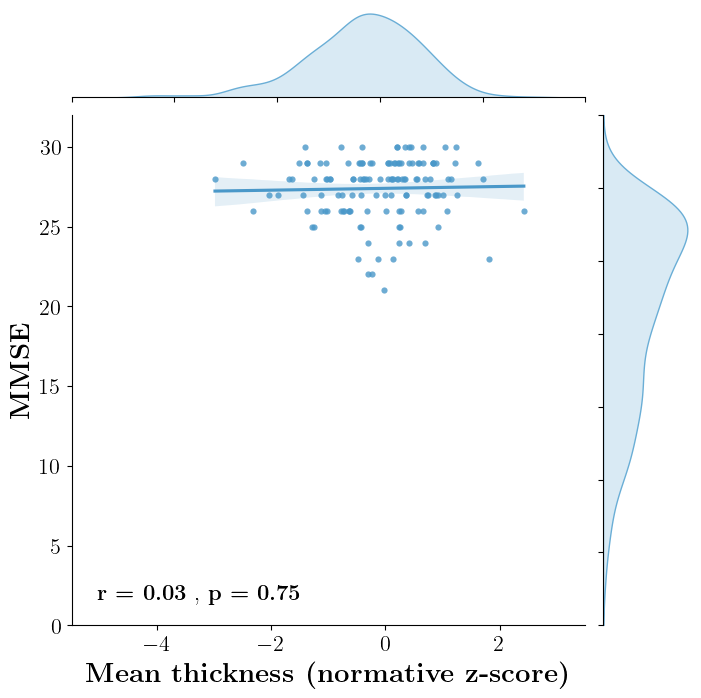

In [610]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()[study_mask]
# sample_df = sample_df[sample_df['split'] != 'Train']
x="mean_thickness_norm_z"
y="mmse"
xlims=[-5.5,3.5]
ylims=[0,32]

sample_df["mean_thickness_norm_z"] = normative_mean_thickness_zscore_MACC[study_mask]


sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "CI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
# ad_df = sample_df[sample_df['diagnosis'].isin(['AD', 'VAD'])]
# mci_df = sample_df[sample_df['diagnosis'].isin(['CIND', 'VCIND'])]
ad_df = sample_df[sample_df['diagnosis'].isin(['AD',])]
mci_df = sample_df[sample_df['diagnosis'].isin(['CIND',])]

# Calculate correlation
# rho, pval = spearmanr(sample_df["extreme_thinning"], sample_df["mmse"])
rho, pval = pearsonr(sample_df[x][study_hc_mask[study_mask]], sample_df["mmse"][study_hc_mask[study_mask]])
print(rho, pval)

fig = plt.figure(figsize=(8, 8))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[1:, :-1])

sns.regplot(data=sample_df[study_hc_mask[study_mask]], x=x, y=y, ax=ax, color=plt.cm.Blues(0.6), scatter_kws={'linewidths': 0, 's': 20,})
# sns.kdeplot(data=sample_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Blues", plt.cm.Blues(np.linspace(0.05, 1, 256))), ax=ax, fill=True, levels=16, thresh=0.05)
# sns.kdeplot(data=ad_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Reds", plt.cm.Reds(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=ci_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Oranges", plt.cm.Oranges(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=healthy_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Greens", plt.cm.Greens(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{Mean thickness (normative z-score)}", fontsize=20)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Add bold text with the correlation coefficient
# plt.figtext(0.15, 0.15, rf'\textbf{{Spearman rho = {rho:.2f}}}', 
#             fontsize=16, color='black', ha='left')
message = rf'\textbf{{r = {rho:.2f}}}'
if pval < 0.0001:
    message = rf'{message} , \textbf{{p $<$ 0.0001}}'
else:
    message = rf'{message} , \textbf{{p = {pval:.2f}}}'
ax.text(0.05, 0.05, message, 
        fontsize=16, color='black', ha='left', transform=ax.transAxes)


ax = ax_top = fig.add_subplot(gs[0, :-1],)

sns.kdeplot(data=sample_df, x=x, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, x=x, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.5), plt.cm.Oranges(0.5), plt.cm.Reds(0.5)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_xlabel('')
ax.set_xlim(xlims)
ax.set_xticks(ax_main.get_xticks())

ax = ax_right = fig.add_subplot(gs[1:, -1])

sns.kdeplot(data=sample_df, y=y, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, y=y, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.75), plt.cm.Oranges(0.75), plt.cm.Reds(0.75)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.set_ylim(ylims)
ax.set_yticks(ax_main.get_yticks())

pass


0.03170644392150962 0.6541897531482932


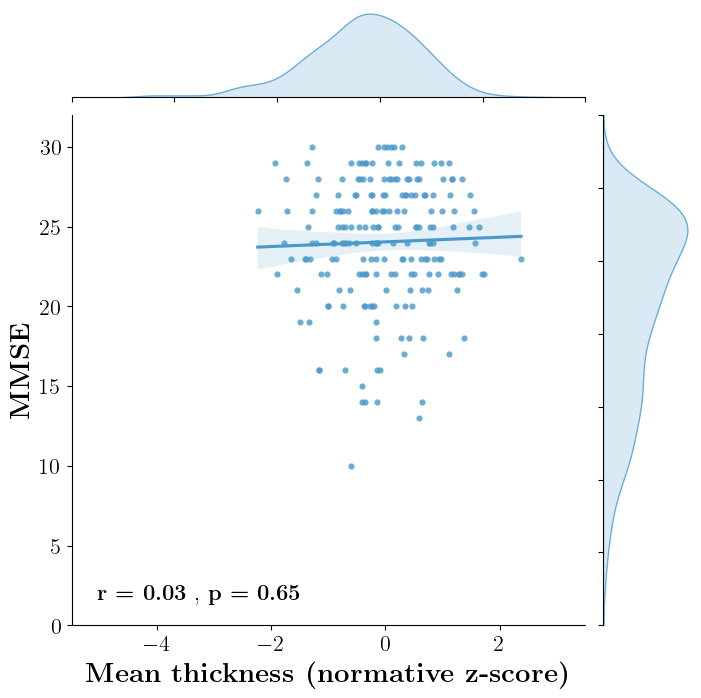

In [611]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()[study_mask]
# sample_df = sample_df[sample_df['split'] != 'Train']
x="mean_thickness_norm_z"
y="mmse"
xlims=[-5.5,3.5]
ylims=[0,32]

sample_df["mean_thickness_norm_z"] = normative_mean_thickness_zscore_MACC[study_mask]


sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "CI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
# ad_df = sample_df[sample_df['diagnosis'].isin(['AD', 'VAD'])]
# mci_df = sample_df[sample_df['diagnosis'].isin(['CIND', 'VCIND'])]
ad_df = sample_df[sample_df['diagnosis'].isin(['AD',])]
mci_df = sample_df[sample_df['diagnosis'].isin(['CIND',])]

# Calculate correlation
# rho, pval = spearmanr(sample_df["extreme_thinning"], sample_df["mmse"])
rho, pval = pearsonr(sample_df[x][study_mc_mask[study_mask]], sample_df["mmse"][study_mc_mask[study_mask]])
print(rho, pval)

fig = plt.figure(figsize=(8, 8))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[1:, :-1])

sns.regplot(data=sample_df[study_mc_mask[study_mask]], x=x, y=y, ax=ax, color=plt.cm.Blues(0.6), scatter_kws={'linewidths': 0, 's': 20,})
# sns.kdeplot(data=sample_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Blues", plt.cm.Blues(np.linspace(0.05, 1, 256))), ax=ax, fill=True, levels=16, thresh=0.05)
# sns.kdeplot(data=ad_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Reds", plt.cm.Reds(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=ci_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Oranges", plt.cm.Oranges(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=healthy_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Greens", plt.cm.Greens(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{Mean thickness (normative z-score)}", fontsize=20)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Add bold text with the correlation coefficient
# plt.figtext(0.15, 0.15, rf'\textbf{{Spearman rho = {rho:.2f}}}', 
#             fontsize=16, color='black', ha='left')
message = rf'\textbf{{r = {rho:.2f}}}'
if pval < 0.0001:
    message = rf'{message} , \textbf{{p $<$ 0.0001}}'
else:
    message = rf'{message} , \textbf{{p = {pval:.2f}}}'
ax.text(0.05, 0.05, message, 
        fontsize=16, color='black', ha='left', transform=ax.transAxes)


ax = ax_top = fig.add_subplot(gs[0, :-1],)

sns.kdeplot(data=sample_df, x=x, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, x=x, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.5), plt.cm.Oranges(0.5), plt.cm.Reds(0.5)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_xlabel('')
ax.set_xlim(xlims)
ax.set_xticks(ax_main.get_xticks())

ax = ax_right = fig.add_subplot(gs[1:, -1])

sns.kdeplot(data=sample_df, y=y, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, y=y, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.75), plt.cm.Oranges(0.75), plt.cm.Reds(0.75)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.set_ylim(ylims)
ax.set_yticks(ax_main.get_yticks())

pass


0.23321308908387778 0.0006988119797348202


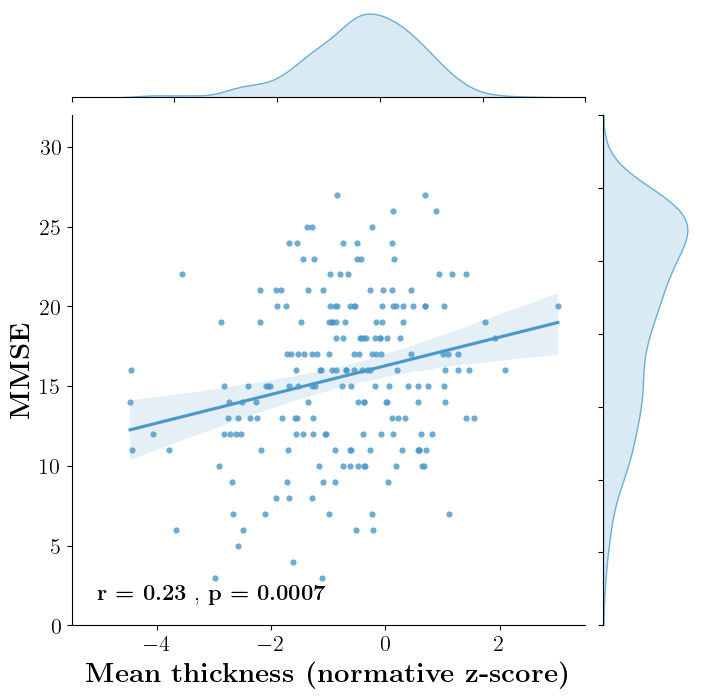

In [614]:
from scipy.stats import spearmanr, pearsonr

sample_df = demography_extended_df_MACC.copy()[study_mask]
# sample_df = sample_df[sample_df['split'] != 'Train']
x="mean_thickness_norm_z"
y="mmse"
xlims=[-5.5,3.5]
ylims=[0,32]

sample_df["mean_thickness_norm_z"] = normative_mean_thickness_zscore_MACC[study_mask]


sample_df["group"] = "HC"
sample_df.loc[sample_df['diagnosis'].isin(['AD', 'VAD']), "group"] = "AD"
sample_df.loc[sample_df['diagnosis'].isin(['CIND', 'VCIND']), "group"] = "CI"

healthy_df = sample_df[sample_df['diagnosis'] == 'NCI']
# ad_df = sample_df[sample_df['diagnosis'].isin(['AD', 'VAD'])]
# mci_df = sample_df[sample_df['diagnosis'].isin(['CIND', 'VCIND'])]
ad_df = sample_df[sample_df['diagnosis'].isin(['AD',])]
mci_df = sample_df[sample_df['diagnosis'].isin(['CIND',])]

# Calculate correlation
# rho, pval = spearmanr(sample_df["extreme_thinning"], sample_df["mmse"])
rho, pval = pearsonr(sample_df[x][study_ad_mask[study_mask]], sample_df["mmse"][study_ad_mask[study_mask]])
print(rho, pval)

fig = plt.figure(figsize=(8, 8))
gs = fig.add_gridspec(6, 6, wspace=0.2)

ax = ax_main = fig.add_subplot(gs[1:, :-1])

sns.regplot(data=sample_df[study_ad_mask[study_mask]], x=x, y=y, ax=ax, color=plt.cm.Blues(0.6), scatter_kws={'linewidths': 0, 's': 20,})
# sns.kdeplot(data=sample_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Blues", plt.cm.Blues(np.linspace(0.05, 1, 256))), ax=ax, fill=True, levels=16, thresh=0.05)
# sns.kdeplot(data=ad_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Reds", plt.cm.Reds(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=ci_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Oranges", plt.cm.Oranges(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
# sns.kdeplot(data=healthy_df, x=x, y=y, cmap=LinearSegmentedColormap.from_list("custom_Greens", plt.cm.Greens(np.linspace(0.5, 1, 256))), ax=ax, fill=True, levels=10, thresh=0.9, alpha=0.8)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_xlabel(r"\textbf{Mean thickness (normative z-score)}", fontsize=20)
ax.set_ylabel(r"\textbf{MMSE}", fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=16)

# Add bold text with the correlation coefficient
# plt.figtext(0.15, 0.15, rf'\textbf{{Spearman rho = {rho:.2f}}}', 
#             fontsize=16, color='black', ha='left')
message = rf'\textbf{{r = {rho:.2f}}}'
if pval < 0.0001:
    message = rf'{message} , \textbf{{p $<$ 0.0001}}'
else:
    message = rf'{message} , \textbf{{p = {pval:.4f}}}'
ax.text(0.05, 0.05, message, 
        fontsize=16, color='black', ha='left', transform=ax.transAxes)


ax = ax_top = fig.add_subplot(gs[0, :-1],)

sns.kdeplot(data=sample_df, x=x, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, x=x, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.5), plt.cm.Oranges(0.5), plt.cm.Reds(0.5)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.set_yticks([])
ax.set_ylabel('')
ax.set_xticklabels([])
ax.set_xlabel('')
ax.set_xlim(xlims)
ax.set_xticks(ax_main.get_xticks())

ax = ax_right = fig.add_subplot(gs[1:, -1])

sns.kdeplot(data=sample_df, y=y, ax=ax, fill=True, color=plt.cm.Blues(0.5))
# sns.kdeplot(
#     data=sample_df, y=y, ax=ax, hue="group", hue_order=["HC", "CI", "AD"], fill=True,
#     palette=[plt.cm.Greens(0.75), plt.cm.Oranges(0.75), plt.cm.Reds(0.75)], multiple="stack", legend=False,
# )
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xticks([])
ax.set_xlabel('')
ax.set_yticklabels([])
ax.set_ylabel('')
ax.set_ylim(ylims)
ax.set_yticks(ax_main.get_yticks())

pass


---
## Scratch notes